<a href="https://colab.research.google.com/github/yanirbuznah/inpainting-gan/blob/main/UNET_with_content_loss_central_block.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Consts

In [2]:
DIR='drive/MyDrive/deep_learning_project'

COLAB=False
MODEL_DIR='drive/MyDrive/deep_learning_project'
MASK_DIR='./test_center_masks'
DATA_DIR='./'
MONET=False
MODEL='UNET_WITH_CONTENT_LOSS' #'UNET #'auto_encoder'
MASK='center'
CONTENT_LOSS=True
STYLE_LOSS=True

In [3]:
!pip install pytorch-ignite

     |████████████████████████████████| 251 kB 7.2 MB/s 


In [4]:
! unzip -n drive/MyDrive/deep_learning_project/data/data.zip
! unzip -n drive/MyDrive/deep_learning_project/data/masks.zip
! unzip -n drive/MyDrive/deep_learning_project/data/monet_data_set.zip
! unzip -n drive/MyDrive/deep_learning_project/data/test.zip

Streaming output truncated to the last 5000 lines.
  inflating: monet_data_set/3079.jpg  
  inflating: monet_data_set/308.jpg  
  inflating: monet_data_set/3080.jpg  
  inflating: monet_data_set/3081.jpg  
  inflating: monet_data_set/3082.jpg  
  inflating: monet_data_set/3083.jpg  
  inflating: monet_data_set/3084.jpg  
  inflating: monet_data_set/3085.jpg  
  inflating: monet_data_set/3086.jpg  
  inflating: monet_data_set/3087.jpg  
  inflating: monet_data_set/3088.jpg  
  inflating: monet_data_set/3089.jpg  
  inflating: monet_data_set/309.jpg  
  inflating: monet_data_set/3090.jpg  
  inflating: monet_data_set/3091.jpg  
  inflating: monet_data_set/3092.jpg  
  inflating: monet_data_set/3093.jpg  
  inflating: monet_data_set/3094.jpg  
  inflating: monet_data_set/3095.jpg  
  inflating: monet_data_set/3096.jpg  
  inflating: monet_data_set/3097.jpg  
  inflating: monet_data_set/3098.jpg  
  inflating: monet_data_set/3099.jpg  
  inflating: monet_data_set/31.jpg   
  inflating: mon

imports

In [5]:
import math
import numbers
import os
import random
import sys
import warnings
import glob
import matplotlib.pyplot as plt
import numpy as np
import torch
from torch import Tensor
import torchvision
from IPython.display import Image
from PIL import Image
from scipy import ndimage
from ignite.engine import Engine
from ignite.metrics import PSNR, MeanSquaredError, Loss
from torch import nn
from torch.utils.data import DataLoader
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms,models
# from torchvision.transforms import functional as F
from torch.nn import functional as F
from tqdm.notebook import tqdm
from torch.cuda import amp
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")

Using cuda device


Dataset loader

In [6]:
class ImageTestDataSet(Dataset):
    def __init__(self,data_dir,masks_dir,transforms=None,monet=False):
        images_dir = os.path.join(data_dir, masks_dir)
        masks = sorted(glob.glob(f"{images_dir}/*mask*.jpg"))
        images = sorted(glob.glob(f"{images_dir}/*result*.jpg"))
        self.files = list(zip(images, masks))
        self.transforms = transforms

    def __len__(self):
        return len(self.files)

    def __getitem__(self, index):
        img,mask = self.files[index]
        img = Image.open(img)
        mask = mask_tranforms()(Image.open(mask))
        mask = torch.round(mask)
        if self.transforms is not None:
            img = self.transforms(img)

        return img,img,img, mask
    
class ImageDataset(Dataset):
    def __init__(self, data_dir, mode='validate', transforms=None,mask = 'center'):
        images_dir = os.path.join(data_dir, 'monet_jpg' if MONET else 'photo_jpg')
        image_list = os.listdir(images_dir)
        train_size = int(0.80 * len(image_list))
        if mode == 'train':
            self.files = [os.path.join(images_dir, name) for name in sorted(os.listdir(images_dir))[:train_size]]
        elif mode == 'validate':
            self.files = [os.path.join(images_dir, name) for name in sorted(os.listdir(images_dir))[train_size:]]
        if MASK_DIR:
            self.mask_function = MaskFromImages(MASK_DIR)
        else:
            if mask == 'center':
                self.mask_function = central_region_transformer()
            elif mask == 'block':
                self.mask_function = random_blocks_transformer()
            else:
                self.mask_function = MaskFromImages()
        self.transforms = transforms

    def __len__(self):
        return len(self.files)

    def __getitem__(self, index):
        file = self.files[index]
        img = Image.open(file)

        if self.transforms is not None:
            original_img = self.transforms[0](img)
            mask = self.mask_function(torch.zeros_like(original_img))
            img_with_erased_region = torch.where(mask == 1, mask, original_img)
            erased_region = 1 - abs(img_with_erased_region - original_img)
            #             mask = self.transforms[1](torch.zeros(3,256,256))
            return original_img, erased_region, img_with_erased_region, mask

        return img, img, img,img




Models

In [7]:
class AutoEncoder(nn.Module):
    def __init__(self, encoder=None, decoder=None):
        super().__init__()
        if encoder is None or decoder is None:
            self.decoder, self.encoder = auto_encoder_parameters()
        else:
            self.encoder = encoder
            self.decoder = decoder
        self.name = MODEL

    def forward(self, x):
        encoder_output = self.encoder(x)

        output = self.decoder(encoder_output)
        return output


class Discriminator(nn.Module):
    def __init__(self, model=None):
        super().__init__()
        self.model = discriminator_parameters() if model is None else model

    def forward(self, x):
        output = self.model(x)
        return output


Util

In [8]:
from matplotlib.rcsetup import validate_fontsize
def gram_matrix(input):
    a, b, c, d = input.size()  # a=batch size(=1)
    # b=number of feature maps
    # (c,d)=dimensions of a f. map (N=c*d)

    features = input.view(a * b, c * d)  # resize F_XL into \hat F_XL
    
    G = torch.mm(features.div(a*b*c*d), features.t())  # compute the gram product

    # we 'normalize' the values of the gram matrix
    # by dividing by the number of element in each feature maps.
    return G


def crop_image(batch):
    batch_size, dim, img_w, img_h = batch.shape
    i = (img_h - 64) // 2
    j = (img_w - 64) // 2
    croped_batch = batch[:, :, i:i + 64, j:j + 64]
    return croped_batch


def save_weights(model, path):
    torch.save(model.state_dict(), path)


def load_weights(model, path):
    model.load_state_dict(torch.load(path))


def add_missing_region_to_image(img, region):
    dim, img_w, img_h = img.shape
    i = (img_h - 64) // 2
    j = (img_w - 64) // 2
    img[:, i:i + 64, j:j + 64] = region
    return img


def get_image_for_plot(fake, img_with_erased_region, mask, original_img, real):
    index = random.randint(0, real.shape[0] - 1)
    full_pred = fake[index].detach().cpu()
    mask = mask.detach().cpu()
    image_after_mask = img_with_erased_region[index]
    full_pred = torch.where(mask[index] == 1, full_pred, image_after_mask)
    pred = torch.where(mask[index] == 0, torch.ones_like(full_pred), full_pred)
    pred = torch.where(mask[index] == 1, full_pred, pred)
    full_pred = full_pred.permute(1, 2, 0).detach().cpu()
    pred = pred.permute(1, 2, 0).detach().cpu()
    y = original_img[index].permute(1, 2, 0).detach().cpu()
    image_after_mask = image_after_mask.permute(1, 2, 0).detach().cpu()
    return full_pred, pred, y, image_after_mask


def show_images(train_true, train_fake, validate_true, validate_fake):
    train_true = (1 + train_true) / 2
    train_fake = (1 + train_fake) / 2
    validate_true = (1 + validate_true) / 2
    validate_fake = (1 + validate_fake) / 2
    fig, axs = plt.subplots(2, 2)
    fig.set_dpi(120)
    axs[0, 0].imshow(train_true, aspect='auto')
    axs[0, 0].set(ylabel='true')
    axs[0, 0].axis('off')
    axs[1, 0].imshow(train_fake, aspect='auto')
    axs[1, 0].set(xlabel='train', ylabel='fake')
    axs[1, 0].axis('off')
    axs[0, 1].imshow(validate_true, aspect='auto')
    axs[0, 1].axis('off')
    axs[1, 1].imshow(validate_fake, aspect='auto')
    axs[1, 1].set(xlabel='validate')
    axs[1, 1].axis('off')
    axs[0, 0].set_title('Train')
    axs[0, 1].set_title('Validate')
    plt.subplots_adjust(hspace=0, wspace=0)
    plt.tight_layout()
    plt.show()

def show_with_missing_regions(train_full_fake, train_true, train_fake, train_masked,
                              validate_full_fake, validate_true,
                              validate_fake, validate_masked):
    train_fake, train_full_fake, train_masked, train_true, validate_fake, validate_full_fake, validate_masked, validate_true =\
    denormalize_images(train_full_fake, train_masked, train_fake,
    train_true, validate_full_fake,validate_masked, validate_fake, validate_true)
    fig, axs = plt.subplots(2, 4)
    fig.set_dpi(120)
    axs[0, 0].imshow(np.clip(train_true,0,1))
    axs[0, 1].imshow(np.clip(train_masked,0,1))
    axs[0, 2].imshow(np.clip(train_fake,0,1))
    axs[0, 3].imshow(np.clip(train_full_fake,0,1))
    axs[1, 0].imshow(np.clip(validate_true,0,1))
    axs[1, 1].imshow(np.clip(validate_masked,0,1))
    axs[1, 2].imshow(np.clip(validate_fake,0,1))
    axs[1, 3].imshow(np.clip(validate_full_fake,0,1))

    for a in axs:
        for x in a:
            x.axis('off')

    axs[0, 0].set_title('Train', fontsize=16)
    axs[1, 0].set_title('Validate', fontsize=16)
    plt.subplots_adjust(hspace=0, wspace=0)
    plt.tight_layout()
    plt.show()


def denormalize_images(train_full_fake, train_image_after_mask, train_fake, train_true, validate_full_fake,
                       validate_masked, validate_fake, validate_true):
    train_true = (1 + train_true) / 2
    train_masked = (1 + train_image_after_mask) / 2
    train_fake = (1 + train_fake) / 2
    train_full_fake = (1 + train_full_fake) / 2
    validate_true = (1 + validate_true) / 2
    validate_masked = (1 + validate_masked) / 2
    validate_fake = (1 + validate_fake) / 2
    validate_full_fake = (1 + validate_full_fake) / 2
    return train_fake, train_full_fake, train_masked, train_true, validate_fake, validate_full_fake, validate_masked, validate_true



def show_sample(data_set):
    img_a, img_b, img_c = data_set[0]
    plt.imshow(img_a.permute(1, 2, 0))
    plt.show()
    plt.imshow(img_b.permute(1, 2, 0))
    plt.show()
    plt.imshow(img_c.permute(1, 2, 0))
    plt.show()



def get_data_from_files(data_dir='./',batch_size = 64):
    train_dataset = ImageDataset(data_dir=data_dir, mode='train',
                                 transforms=[data_augmentation_transformer()],mask=MASK)
    # show_sample(train_dataset)
    validate_dataset = ImageDataset(data_dir=data_dir, mode='validate',
                                    transforms=[general_transformer()],mask=MASK)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    validate_loader = DataLoader(validate_dataset, batch_size=batch_size, shuffle=True)

    return train_loader, validate_loader

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

def save_models(ae_pack,discriminator_pack,loss,epoch,evaluator):
  print(f'--- save {evaluator} models ---')
  torch.save({
            'epoch': epoch,
            'ae_state_dict': ae_pack['model'].state_dict(),
            'ae_optimizer_state_dict': ae_pack['optimizer'].state_dict(),
            'd_state_dict': discriminator_pack['model'].state_dict(),
            'd_optimizer_state_dict': discriminator_pack['optimizer'].state_dict(),
            'loss': loss,
            
            }, f'./{ae_pack["model"].name}__{evaluator}')


Masks

In [9]:
from torchvision.transforms import functional as F1
class MaskFromImages:
    def __init__(self, dir='test_center_masks'):
        self.files = [os.path.join(dir, name) for name in sorted(os.listdir(dir))]

    # def __call__(self,img):
    #     index = np.random.randint(len(self.files))
    #     mask = self.files[index]
    #     mask = Image.open(mask)
    #     mask = mask_tranforms()(mask)
    #     mask = torch.round(mask)
    #     img = torch.where(mask == 1,mask,img)
    #     return img
    def __call__(self,img):
        index = np.random.randint(len(self.files))
        mask = self.files[index]
        mask = Image.open(mask)
        mask = transforms.ToTensor()(mask)
        img = torch.where(mask == 1,mask,img )
        return img




class RandomBlocksErasing:

    def __init__(self, p=0.5, scale=(0.02, 0.33), ratio=(0.3, 3.3), value=0, center=True, inplace=False,
                 random_blocks=0):
        assert isinstance(value, (numbers.Number, str, tuple, list))
        if (scale[0] > scale[1]) or (ratio[0] > ratio[1]):
            warnings.warn("range should be of kind (min, max)")
        if scale[0] < 0 or scale[1] > 1:
            raise ValueError("range of scale should be between 0 and 1")
        if p < 0 or p > 1:
            raise ValueError("range of random erasing probability should be between 0 and 1")

        self.p = p
        self.scale = scale
        self.ratio = ratio
        self.value = value
        self.inplace = inplace
        self.center = center
        self.random_blocks = random_blocks

    @staticmethod
    def get_params(img, scale, ratio, value=0, center=True):
        """Get parameters for ``erase`` for a random erasing.
        Args:
            img (Tensor): Tensor image of size (C, H, W) to be erased.
            scale: range of proportion of erased area against input image.
            ratio: range of aspect ratio of erased area.
        Returns:
            tuple: params (i, j, h, w, v) to be passed to ``erase`` for random erasing.
        """
        img_c, img_h, img_w = img.shape
        area = img_h * img_w
        while True:
            erase_area = random.uniform(scale[0], scale[1]) * area
            aspect_ratio = random.uniform(ratio[0], ratio[1])

            h = int(round(math.sqrt(erase_area * aspect_ratio)))
            w = int(round(math.sqrt(erase_area / aspect_ratio)))

            if h < img_h and w < img_w:
                if center:
                    i = (img_h - h) // 2
                    j = (img_w - w) // 2
                else:
                    i = random.randint(0, img_h - h)
                    j = random.randint(0, img_w - w)
                if isinstance(value, numbers.Number):
                    v = value
                elif isinstance(value, torch._six.string_classes):
                    v = torch.empty([img_c, h, w], dtype=torch.float32).normal_()
                elif isinstance(value, (list, tuple)):
                    v = torch.tensor(value, dtype=torch.float32).view(-1, 1, 1).expand(-1, h, w)
                else:
                    v = None
                return i, j, h, w, v

        # Return original image
        return 0, 0, img_h, img_w, img

    def __call__(self, img):
        """
        Args:
            img (Tensor): Tensor image of size (C, H, W) to be erased.
        Returns:
            img (Tensor): Erased Tensor image.
        """
        if self.random_blocks > 0:
            num_of_blocks = random.randint(1, self.random_blocks)
            for i in range(num_of_blocks):
                if random.uniform(0, 1) < self.p:
                    x, y, h, w, v = self.get_params(img, scale=self.scale, ratio=self.ratio, value=self.value,
                                                    center=False)
                    img = F1.erase(img, x, y, h, w, v, self.inplace)
            return img
        else:
            if random.uniform(0, 1) < self.p:
                x, y, h, w, v = self.get_params(img, scale=self.scale, ratio=self.ratio, value=self.value,
                                                center=self.center)
                return F1.erase(img, x, y, h, w, v, self.inplace)
            return img


class RandomRegionErasing:
    def __init__(self, p=0.5, region_size=100, inplace=False):
        self.p = p
        self.region_size = region_size
        self.inplace = inplace

    @staticmethod
    def get_random_mask(img, region_size):
        img_c, img_h, img_w = img.shape

        n = 10
        mask = np.zeros((region_size, region_size))
        generator = np.random.RandomState()
        points = region_size * generator.rand(2, n ** 2)
        mask[(points[0]).astype(np.int), (points[1]).astype(np.int)] = 1
        mask = ndimage.gaussian_filter(mask, sigma=region_size / (4. * n))
        mask = (mask > mask.mean()).astype(np.float)
        img = np.ones((img_h, img_w))
        start_h, start_w = random.randint(0, img_w - region_size), random.randint(0, img_w - region_size)

        img[start_h:start_h + region_size, start_w:start_w + region_size] = mask
        return img


    def __call__(self, img):
        """
        Args:
            img (Tensor): Tensor image of size (C, H, W) to be erased.
        Returns:
            img (Tensor): Erased Tensor image.
        """
        if random.uniform(0, 1) < self.p:
            mask = self.get_random_mask(img, region_size=self.region_size)

            if not self.inplace:
                img = img.clone()
            mask_3d = mask[None, :, :] * np.ones(3, dtype=int)[:, None, None]
            indices_mask = np.where(mask_3d == 0)
            img[indices_mask] = 1

        return img


Transforms

In [10]:
def central_region_transformer(p=1, scale=(0.0625, 0.0625), value=1, ratio=(1, 1)):
    return transforms.Compose([
        RandomBlocksErasing(p, scale, ratio, value, center=True, random_blocks=0),
    ])


def random_blocks_transformer(p=1, scale=(0.02, 0.02), value=1, ratio=(1, 1)):
    return transforms.Compose([
        RandomBlocksErasing(p, scale, ratio, value, center=False, random_blocks=10),
        

    ])


def random_region_transformer(p=1, region_size=100):
    return transforms.Compose([
        RandomRegionErasing(p, region_size=region_size),
    ])


def data_augmentation_transformer():
    return transforms.Compose([
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.RandomRotation(degrees=(-8, 8)),
#         transforms.Resize((224, 224)),
        #         transforms.RandomResizedCrop(size=(256, 256)),
        # transforms.Resize((128,128)),
        #         transforms.RandomAdjustSharpness(sharpness_factor=1, p=0.2),
        transforms.ToTensor(),
        # RandomBlocksErasing(p=0.5, scale=(0.02, 0.02), value=1, ratio=(1, 1), random_blocks=10),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
    ])


def general_transformer():
    return torchvision.transforms.Compose([
#         transforms.Resize((224, 224)),
           transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
    ])


def mask_tranforms():
      return torchvision.transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
      ])

train and validate

In [11]:


def train(dataloader, auto_encoder_pack, discriminator_pack):
    auto_encoder, ae_criterion, ae_optimizer, a = auto_encoder_pack['model'], auto_encoder_pack['loss'], \
                                                  auto_encoder_pack[
                                                      'optimizer'], auto_encoder_pack['lambda']
    discriminator, discriminator_criterion, discriminator_optimizer = discriminator_pack['model'], discriminator_pack[
        'loss'], discriminator_pack['optimizer']

    real_label, fake_label = 1, 0
    size = len(dataloader.batch_sampler)
    pbar = tqdm(range(size))
    auto_encoder.train()
    discriminator.train()
    train_ae_loss, train_d_loss, correct = 0, 0, 0

    for batch, X in zip(pbar, dataloader):

        original_img, erased_region, img_with_erased_region, mask = X
        X = img_with_erased_region.to(device)
        mask = mask.to(device)

        real = original_img.to(device)
        b_size = real.size(0)
        r_label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        f_label = torch.full((b_size,), fake_label, dtype=torch.float, device=device)

        # -------------------
        # Train Auto Encoder
        # -------------------

        auto_encoder.zero_grad()
        ae_optimizer.zero_grad()

        fake = auto_encoder(X)
        erased_region = erased_region.to(device)
        generated_region = torch.where(mask == 1, fake, erased_region)
        f_output = discriminator(fake.detach()).view(-1)
        adversarial_loss = discriminator_criterion(f_output, r_label)  # + discriminator_criterion(r_output,r_label)
        errAE = ae_criterion(fake, real) + ae_criterion(erased_region, generated_region)
        loss = a * errAE + (1 - a) * (adversarial_loss)
        train_ae_loss += loss.item()
        loss.backward()
        ae_optimizer.step()

        # -------------------
        # Train Discriminator
        # -------------------

        discriminator.zero_grad()
        discriminator_optimizer.zero_grad()

        # --- Real Batch ---

        # Forward
        r_output = discriminator(real).view(-1)
        correct += (r_output > 0.5).type(torch.float).sum().item()

        # Calculate loss
        errD_real = discriminator_criterion(r_output, r_label)
        # --- Fake Batch ---

        # Forward
        f_output = discriminator(fake.detach()).view(-1)
        correct += (f_output < 0.5).type(torch.float).sum().item()

        # Calculate loss
        errD_fake = discriminator_criterion(f_output, f_label)

        # Compute error of D as sum over the fake and the real batches
        errD = 0.5 * (errD_real + errD_fake)

        # Backward
        errD.backward()

        # Update D
        discriminator_optimizer.step()

        train_d_loss += errD.item()

        pbar.set_description(
            f"Batch {batch} | AutoEncoder loss = {train_ae_loss / (batch + 1):>7f} Discriminator loss = {train_d_loss / (batch + 1):>7f}")

    train_ae_loss /= len(dataloader)
    train_d_loss /= len(dataloader)
    correct *= (50 / (len(dataloader.dataset)))
    full_pred, pred, y, image_after_mask = get_image_for_plot(fake, img_with_erased_region, mask, original_img, real)

    print(f"acc:{correct:.3f}")
    return train_ae_loss, full_pred, y, pred, image_after_mask


def train_with_cuda(dataloader, auto_encoder_pack, discriminator_pack, scaler):
    auto_encoder, ae_criterion, ae_optimizer, a, content_criterion = auto_encoder_pack['model'], auto_encoder_pack[
        'loss'], \
                                                                     auto_encoder_pack['optimizer'], auto_encoder_pack[
                                                                         'lambda'], auto_encoder_pack['content_loss']
    discriminator, discriminator_criterion, discriminator_optimizer = discriminator_pack['model'], discriminator_pack[
        'loss'], discriminator_pack['optimizer']

    real_label, fake_label = 1, 0
    size = len(dataloader.batch_sampler)
    pbar = tqdm(range(size))
    auto_encoder.train()
    discriminator.train()
    train_ae_loss, train_d_loss, correct = 0, 0, 0

    for batch, X in zip(pbar, dataloader):
        # torch.cuda.empty_cache()

        original_img, erased_region, img_with_erased_region, mask = X
        X = img_with_erased_region.to(device)
        mask = mask.to(device)

        real = original_img.to(device)
        b_size = real.size(0)
        r_label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        f_label = torch.full((b_size,), fake_label, dtype=torch.float, device=device)

        # -------------------
        # Train Auto Encoder
        # -------------------

        # auto_encoder.zero_grad()
        ae_optimizer.zero_grad()
        fake = auto_encoder(X)
        erased_region = erased_region.to(device)
        generated_region = torch.where(mask == 1, fake, erased_region)
        with amp.autocast():
            with torch.no_grad():
                f_output = discriminator(fake.detach()).view(-1)
            pixel_loss = ae_criterion(fake, real) + ae_criterion(erased_region, generated_region)
            content_loss,style_loss = content_criterion(fake, real)
            
            adversarial_loss = discriminator_criterion(f_output, r_label)

        # f_output = discriminator(fake.detach()).view(-1)
        # adversarial_loss = discriminator_criterion(f_output, r_label)
        # errAE = ae_criterion(fake, real) + ae_criterion(erased_region,generated_region)
        loss = a * pixel_loss + (1 - a) * (adversarial_loss) + content_loss + style_loss * 1e2
        train_ae_loss += loss.item()

        scaler.scale(loss).backward()
        # Update generator parameters
        scaler.step(ae_optimizer)
        scaler.update()

        # loss.backward()
        # ae_optimizer.step()

        # -------------------
        # Train Discriminator
        # -------------------

        # discriminator.zero_grad()
        discriminator_optimizer.zero_grad()

        # --- Real Batch ---

        # Forward
        r_output = discriminator(real).view(-1)
        correct += (r_output > 0.5).type(torch.float).sum().item()

        # Calculate loss
        errD_real = discriminator_criterion(r_output, r_label)
        # --- Fake Batch ---

        # Forward
        f_output = discriminator(fake.detach()).view(-1)
        correct += (f_output < 0.5).type(torch.float).sum().item()

        # Calculate loss
        errD_fake = discriminator_criterion(f_output, f_label)

        # Compute error of D as sum over the fake and the real batches
        errD = 0.5 * (errD_real + errD_fake)

        # Backward
        # errD.backward()
        scaler.scale(errD).backward()
        scaler.step(discriminator_optimizer)
        scaler.update()

        # Update D
        # discriminator_optimizer.step()

        train_d_loss += errD.item()

        pbar.set_description(
            f"Batch {batch} | AutoEncoder loss = {train_ae_loss / (batch + 1):>7f} Discriminator loss = {train_d_loss / (batch + 1):>7f}")

    train_ae_loss /= len(dataloader)
    train_d_loss /= len(dataloader)
    correct *= (50 / (len(dataloader.dataset)))
    full_pred, pred, y, image_after_mask = get_image_for_plot(fake, img_with_erased_region, mask, original_img, real)

    print(f"acc:{correct:.3f}")
    return train_ae_loss, full_pred, y, pred, image_after_mask


def test(dataloader,model):

    def show_sample(source_img,mask,fake,i):
        source_img = source_img.detach().cpu()
        mask = mask.detach().cpu()
        fake = fake.detach().cpu()
        full_pred = torch.where(mask == 1, fake, source_img)
        pred = torch.where(mask == 0, torch.ones_like(full_pred), fake)
        pred = torch.where(mask == 1, fake, pred)
        full_pred = full_pred.permute(1, 2, 0).detach().cpu()
        pred = pred.permute(1, 2, 0).detach().cpu()
        source_img = source_img.permute(1,2,0)
        source_img = np.clip((1 + source_img) / 2, 0, 1)
        pred = np.clip((1 + pred) / 2, 0, 1)
        full_pred = np.clip((1 + full_pred) / 2, 0, 1)
        fig, axs = plt.subplots(1, 3)
        fig.set_dpi(120)
        axs[0].imshow(source_img)
        axs[1].imshow(pred)
        axs[2].imshow(full_pred)
        for x in axs:
            x.axis('off')
        plt.subplots_adjust(hspace=0, wspace=0)
        plt.tight_layout()
        # plt.show()
        
        plt.savefig(f'drive/MyDrive/deep_learning_project/UNET{i}.jpg')

    model.eval()
    with torch.no_grad():
        i = 0 
        for X in dataloader:
            if  i > 20:
              break
            source_img, _,_,mask = X
            X = source_img.to(device)
            fake = model(X)
            print('save...')
            show_sample(source_img[0],mask[0],fake[0],i)
            i+=1



def validate(dataloader, model, loss_fn, check_best=False):
    global best

    def predict_on_batch(engine, batch):
        with torch.no_grad():
            original_img, erased_region, img_with_erased_region, mask = batch
            X = img_with_erased_region.to(device)
            y = original_img.to(device)
            fake = model(X)

        return fake, y

    evaluator = Engine(predict_on_batch)
    psnr = PSNR(1.0,device=device)
    psnr.attach(evaluator, 'psnr')
    mse = Loss(nn.MSELoss())
    mse.attach(evaluator,'mse')
    state = evaluator.run(dataloader)
    validate_mse = state.metrics['mse']
    validate_psnr= state.metrics['psnr']
    with torch.no_grad():
        for X in dataloader:
            original_img, erased_region, img_with_erased_region, mask = X
            X = img_with_erased_region.to(device)
            fake = model(X)
            break

    full_pred, pred, y, image_after_mask = get_image_for_plot(fake, img_with_erased_region, mask, original_img,
                                                              original_img)

    print(f"Validate Error:\n MSE loss: {validate_mse:>5f} PSNR: {validate_psnr:>5f}\n")
    return validate_mse, validate_psnr, full_pred, y, pred, image_after_mask


#
# def validate(dataloader, model, loss_fn, check_best=False):
#     global best
#     size = len(dataloader.dataset)
#     num_batches = len(dataloader)
#     psnr = PSNR(1.0,device=device)
#     # psnr.attach(loss_fn, 'psnr')
#     model.eval()
#     validate_loss, correct = 0, 0
#     with torch.no_grad():
#         for X in dataloader:
#             original_img, erased_region, img_with_erased_region, mask = X
#             X = img_with_erased_region.to(device)
#             y = original_img.to(device)
#             fake = model(X)
#             validate_loss = psnr.run(fake, y)
#             break
#
#     print(validate_loss.metrics['psnr'])
#     validate_loss /= num_batches
#
#     full_pred, pred, y, image_after_mask = get_image_for_plot(fake, img_with_erased_region, mask, original_img,
#                                                               original_img)
#
#     print(f"Validate Error:\nAvg loss: {validate_loss:>8f}\n")
#     return validate_loss, full_pred, y, pred, image_after_mask


def train_ae_only(dataloader, auto_encoder_pack):
    auto_encoder, ae_criterion, ae_optimizer, a = auto_encoder_pack['model'], auto_encoder_pack['loss'], \
                                                  auto_encoder_pack[
                                                      'optimizer'], auto_encoder_pack['lambda']
    size = len(train_loader.batch_sampler)
    pbar = tqdm(range(size))
    auto_encoder.train()
    train_ae_loss = 0

    for batch, X in zip(pbar, dataloader):
        original_img, erased_region, img_with_erased_region = X
        X = img_with_erased_region.to(device)
        real = original_img.to(device)

        # Compute prediction error
        auto_encoder.zero_grad()
        fake = auto_encoder(X)

        loss = ae_criterion(fake, real)

        train_ae_loss += loss.item()

        # Backpropagation
        ae_optimizer.zero_grad()
        loss.backward()
        a.backward()
        ae_optimizer.step()
        #         if batch % 40 == 0:
        #             loss, current = loss.item(), batch * len(X)
        #             print(f"loss: {loss:>7f}  [{current:>5d}/{size:>5d}]")
        pbar.set_description(f"Batch {batch} | AutoEncoder loss = {train_ae_loss / (batch + 1):>7f}")

    train_ae_loss /= len(dataloader)

    index = random.randint(0, real.shape[0] - 1)
    region = crop_image(fake)
    pred = add_missing_region_to_image(img_with_erased_region[index], region[index])
    pred = pred.permute(1, 2, 0).detach().cpu()
    y = original_img[index].permute(1, 2, 0).cpu()

    # print(f"Train Error: \nAvg auto encoder loss: {train_ae_loss:>8f}")
    return train_ae_loss, pred, y



Model parameters

In [12]:
def auto_encoder_parameters():

    encoder = nn.Sequential(
        nn.Conv2d(in_channels=3, out_channels=64, kernel_size=(4, 4), stride=(2, 2), padding=1),  # output: 64,128,128
        nn.BatchNorm2d(64),
        nn.PReLU(),
        nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(4, 4), stride=(2, 2), padding=1),  # output: 128,64,64
        nn.BatchNorm2d(128),
        nn.PReLU(),
        nn.Conv2d(in_channels=128, out_channels=256, kernel_size=(4, 4), stride=(2, 2), padding=1),  # output: 256,32,32
        nn.BatchNorm2d(256),
        nn.PReLU(),
        nn.Conv2d(in_channels=256, out_channels=512, kernel_size=(4, 4), stride=(2, 2), padding=1),  # output: 512,16,16
        nn.BatchNorm2d(512),
        nn.PReLU(),
        nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=(4, 4), stride=(2, 2), padding=1),  # output: 1024,8,8
        nn.BatchNorm2d(1024),
        nn.PReLU(),
        nn.Conv2d(in_channels=1024, out_channels=2048, kernel_size=(4, 4), stride=(2, 2), padding=1),  # output: 2048,4,4
        nn.BatchNorm2d(2048),
        nn.PReLU(),
        nn.Conv2d(in_channels=2048, out_channels=8192, kernel_size=(4, 4), stride=(1, 1), padding=0,groups=2048),  # output: 8192,1,1
        nn.BatchNorm2d(8192),
        nn.PReLU(),
    )

    # encoder =  torch.hub.load('pytorch/vision:v0.10.0', 'mobilenet_v2', pretrained=True)
    decoder = nn.Sequential(
        nn.ConvTranspose2d(in_channels=8192, out_channels=2048, kernel_size=(4, 4), stride=(2, 2)),  # output: 1024,4,4
        nn.BatchNorm2d(2048),
        nn.PReLU(),
        nn.ConvTranspose2d(in_channels=2048, out_channels=1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1)),
        # output: 512,8,8
        nn.BatchNorm2d(1024),
        nn.PReLU(),
        nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1)),
        # output: 512,8,8
        nn.BatchNorm2d(512),
        nn.PReLU(),
        nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1)),
        # output: 256,16,16
        nn.BatchNorm2d(256),
        nn.PReLU(),
        nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1)),
        # output: 128,32,32
        nn.BatchNorm2d(128),
        nn.PReLU(),
        nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1)),
        # output: 64,64,64
        nn.BatchNorm2d(64),
        nn.PReLU(),
        nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1)),
        # output: 32,128,128
        # nn.BatchNorm2d(32),
        # nn.PReLU(),
        # nn.ConvTranspose2d(in_channels=32, out_channels=3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1)),  # output: 3,64,64
        nn.Tanh(),
        # nn.BatchNorm2d(3),
    )
    # decoder.apply(weights_init)
    return decoder, encoder


def discriminator_parameters():
    discriminator = nn.Sequential(
        nn.Conv2d(in_channels=3, out_channels=16, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(16),
        nn.PReLU(),
        nn.MaxPool2d((2, 2)),
        nn.Conv2d(in_channels=16, out_channels=32, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(32),
        nn.PReLU(),
        nn.MaxPool2d((2, 2)),
        nn.Conv2d(in_channels=32, out_channels=64, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(64),
        nn.PReLU(),
        nn.MaxPool2d((2, 2)),
        nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(128),
        nn.PReLU(),
        nn.MaxPool2d((2, 2)),
        nn.Conv2d(in_channels=128, out_channels=256, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(256),
        nn.PReLU(),
        nn.MaxPool2d((2, 2)),
        nn.Conv2d(in_channels=256, out_channels=512, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(512),
        nn.PReLU(),
        nn.MaxPool2d((2, 2)),
        nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=(3, 3), stride=(1, 1), padding=1),
        nn.BatchNorm2d(1024),
        nn.PReLU(),
        nn.MaxPool2d((4, 4)),
        nn.Flatten(),
        nn.Linear(in_features=1024,out_features=1),
        # nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=(2, 2), stride=(1, 1)),
        nn.Sigmoid(),

    )
    return discriminator

Main loop

In [13]:
def auto_encoder_only_loop(auto_encoder_pack, train_loader, validate_loader, epochs=10):
    for t in range(epochs):
        print(f"Epoch {t + 1}\n-------------------------------")
        loss, train_pred, train_y = train_ae_only(dataloader=train_loader, auto_encoder_pack=auto_encoder_pack)
        loss, val_pred, val_y = validate(dataloader=validate_loader, model=auto_encoder_pack['model'],
                                         loss_fn=nn.MSELoss())
        show_images(train_y, train_pred, val_y, val_pred)


def main_loop(auto_encoder_pack, discriminator_pack, train_loader, validate_loader, scaler, epochs=50):
    # load_weights(discriminator_pack['model'], 'd_weights.bin')
    best_psnr = 0
    best_mse = 1e6
    psnr_changed,mse_changed = False, False    
    train_loss, val_mse_loss, val_psnr = [], [] , []
    for t in range(epochs):
        print(f"Epoch {t + 1}\n-------------------------------")
        if scaler is None:
            loss, train_full_pred, train_y, train_pred, train_image_after_mask = train(dataloader=train_loader,
                                                                                       auto_encoder_pack=auto_encoder_pack,
                                                                                       discriminator_pack=discriminator_pack)
        else:
            loss, train_full_pred, train_y, train_pred, train_image_after_mask = train_with_cuda(
                dataloader=train_loader,
                auto_encoder_pack=auto_encoder_pack,
                discriminator_pack=discriminator_pack,
                scaler=scaler)

        train_loss.append(loss)
        mse_loss,psnr, val_full_pred, val_y, val_pred, validate_image_after_mask = validate(dataloader=validate_loader,
                                                                                   model=auto_encoder_pack['model'],
                                                                                   loss_fn=nn.MSELoss())
        val_mse_loss.append(mse_loss)
        val_psnr.append(psnr)
        show_with_missing_regions(train_full_pred, train_y, train_pred, train_image_after_mask, val_full_pred, val_y,
                                  val_pred, validate_image_after_mask)

        if best_psnr <  psnr:
          best_psnr = psnr
          psnr_changed = True
          # save_models(auto_encoder_pack,discriminator_pack,loss,t,'psnr')
          # discriminator_psnr = copy.deepcopy(original_model.state_dict())
 
        if best_mse > mse_loss:
          best_mse = mse_loss
          mse_changed = True
          save_models(auto_encoder_pack,discriminator_pack,loss,t,'mse')

          
        # if t%10 == 0 and psnr_changed:
        #   psnr_changed = False
        #   save_models(auto_encoder_pack,discriminator_pack,loss,t,'psnr')
        # if t%10 == 0 and mse_changed:
        #   mse_changed = False
        #   save_models(auto_encoder_pack,discriminator_pack,loss,t,'mse')


    print("Done!")


In [14]:
class Identity(nn.Module):
    def __init__(self):
        super().__init__()
        
    def forward(self, x):
        return x

class EncoderBlock(nn.Module):
    def __init__(self, in_ch, out_ch, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), groups=1):
        super().__init__()
        self.conv = nn.Conv2d(in_channels=in_ch, out_channels=out_ch, kernel_size=kernel_size, stride=stride,
                              padding=padding, groups=groups)
        self.batch_norm = nn.BatchNorm2d(out_ch)
        self.p_relu = nn.PReLU()

    def forward(self, x):
        return self.p_relu(self.batch_norm(self.conv(x)))


class DecoderBlock(nn.Module):
    def __init__(self, in_ch, out_ch, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), output=False, batch_norm=True):
        super().__init__()
        self.conv = nn.ConvTranspose2d(in_channels=in_ch, out_channels=out_ch, kernel_size=kernel_size, stride=stride,
                                       padding=padding)
        self.batch_norm = nn.BatchNorm2d(out_ch)
        self.conv2 = nn.Conv2d(in_channels=out_ch, out_channels=out_ch, kernel_size=1,stride=1,padding=0)
        self.activition = nn.Tanh() if output else nn.PReLU()
        # self.activition = Identity() if output else nn.PReLU()
        self.norm = batch_norm
        

    def forward(self, x):
        if self.norm:
            return self.activition(self.batch_norm(self.conv(x))) # * self.activition2(self.conv(x))
        else:
            return self.activition(self.conv(x)) # * self.activition2(self.conv(x)) 


class Encoder(nn.Module):
    def __init__(self, chs=(3, 64, 128, 256, 512, 1024, 2048, 8092)):
        super().__init__()
        self.enc_blocks = nn.ModuleList([EncoderBlock(chs[i], chs[i + 1]) for i in range(len(chs) - 2)])
        self.enc_blocks.append(EncoderBlock(chs[-2], chs[-1], padding=0, stride=(1, 1), groups=chs[-2]))
        # self.pool       = nn.MaxPool2d(2)

    def forward(self, x):
        ftrs = []
        for block in self.enc_blocks:
            x = block(x)
            ftrs.append(x)
            # x = self.pool(x)
        return ftrs


class Decoder(nn.Module):
    def __init__(self, chs=(1024, 512, 256, 128, 64)):
        super().__init__()
        self.dec_blocks = nn.ModuleList([DecoderBlock(chs[i][0], chs[i][1]) for i in range(1,len(chs))])
        self.dec_blocks.insert(0, DecoderBlock(chs[0][0], chs[0][1], output=True, padding=(0, 0), batch_norm=False))
        self.chs = chs

    def forward(self,x, encoder_features):
        # print(encoder_features[0].shape)
        x = self.dec_blocks[0](encoder_features[0])
        for i in range(1,len(self.chs) - 1):
            # print(x.shape)
            # print(encoder_features[i].shape)
            # enc_ftrs = self.crop(encoder_features[i], x)
            x = torch.cat([x, encoder_features[i]], dim=1)
            # print(x.shape)
            x = self.dec_blocks[i](x)
            # print(x.shape)
        return x
    # 
    # def crop(self, enc_ftrs, x):
    #     _, _, H, W = x.shape
    #     enc_ftrs = torchvision.transforms.CenterCrop([H, W])(enc_ftrs)
    #     return enc_ftrs
    # 



class UNet(nn.Module):
    def __init__(self, enc_chs=(3, 64, 128, 256, 512, 1024, 2048, 4096), dec_chs=([4096,2048], [4096,1024], [2048,512], [1024,256], [512,128], [256,64], [128,3],[6 ,3]),
                 num_class=1, retain_dim=False, out_sz=(256, 256)):
        super().__init__()

        self.encoder = Encoder(enc_chs)
        self.decoder = Decoder(dec_chs)
        self.head = nn.Conv2d(enc_chs[-1], 4096, 1)
        self.retain_dim = retain_dim
        self.out_sz = out_sz
        self.name = MODEL


    def forward(self, x):
        enc_ftrs = self.encoder(x)
        out = self.head(enc_ftrs[-1])
        # for i in enc_ftrs:
        #     print(i.shape)
        # print('done!')
        out = self.decoder(out, enc_ftrs[::-1])
        # out      = self.head(out)
        if self.retain_dim:
            out = F.interpolate(out, self.out_sz)
        return out

class LossModel(nn.Module):

    def __init__(self,normelize=True) -> None:
        super(LossModel, self).__init__()
        # Load the VGG19 model trained on the ImageNet dataset.
        vgg19 = models.vgg19(pretrained=True)
        # Extract the thirty-sixth layer output in the VGG19 model as the content loss.
        self.feature_extractor = nn.Sequential(*list(vgg19.features.children())[:11]).eval()
        print(self.feature_extractor)
        # Freeze model parameters.
        for parameters in self.feature_extractor.parameters():
            parameters.requires_grad = False
        for layer in self.feature_extractor.children():
            if isinstance(layer,nn.ReLU):
                layer.inplace = False

        self.mean = torch.Tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
        self.std =  torch.Tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)

        

    def forward(self, generated_image: Tensor, original: Tensor) -> Tensor:
        content_loss = 0
        style_loss = 0
        generated_image = ((generated_image +1.0)/2.)
        original = ((original + 1.)/2.)
        x1 = generated_image.sub(self.mean).div(self.std)
        x2 = original.sub(self.mean).div(self.std)
        with torch.no_grad():
          for l in self.feature_extractor:
               x1 = l(x1)
               x2 = l(x2)
               if isinstance(l, nn.Conv2d):
                  # for x11,x21 in zip(x1,x2):
                  Gx1 = gram_matrix(x1)
                    # print(Gx1.size())
                  Gx2 = gram_matrix(x2)
                    
                  style_loss += F.mse_loss(Gx1, Gx2)
                  # print(style_loss)
          #         loss += F.l1_loss(x1,x2)
          content_loss = F.l1_loss(self.feature_extractor(generated_image), self.feature_extractor(original))

        return content_loss, style_loss * 100

class ContentLoss(nn.Module):

    def __init__(self,normelize=True) -> None:
        super(ContentLoss, self).__init__()
        # Load the VGG19 model trained on the ImageNet dataset.
        vgg19 = models.vgg19(pretrained=True).eval()
        # Extract the thirty-sixth layer output in the VGG19 model as the content loss.
        self.feature_extractor = nn.Sequential(*list(vgg19.features.children())[:36])
        # Freeze model parameters.
        for parameters in self.feature_extractor.parameters():
            parameters.requires_grad = False
        for l in self.feature_extractor.children():
          if isinstance(l,nn.ReLU):
            l.inplace = False

        self.mean = torch.Tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
        self.std =  torch.Tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)

        

    def forward(self, generated_image: Tensor, original: Tensor) -> Tensor:
        loss = 0
        # generated_image = ((generated_image +1.0)/2.)
        # original = ((original + 1.)/2.)
        x1 = generated_image.sub(self.mean).div(self.std)
        x2 = original.sub(self.mean).div(self.std)
        with torch.no_grad():
          # for l in self.feature_extractor:
          #     x1 = l(x1)
          #     x2 = l(x2)
          #     if isinstance(l, nn.Conv2d):
          #         loss += F.l1_loss(x1,x2)
          loss = F.l1_loss(self.feature_extractor(x1), self.feature_extractor(x2))

        return loss , 0


Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

Epoch 1
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:91.625
Validate Error:
 MSE loss: 0.240518 PSNR: 6.583695



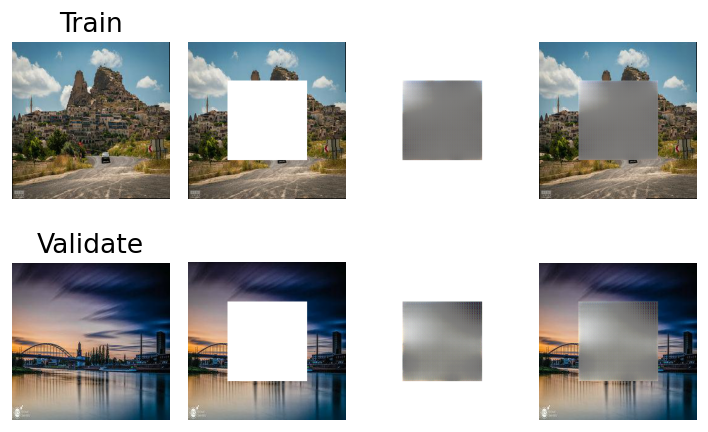

--- save mse models ---
Epoch 2
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.218675 PSNR: 6.930286



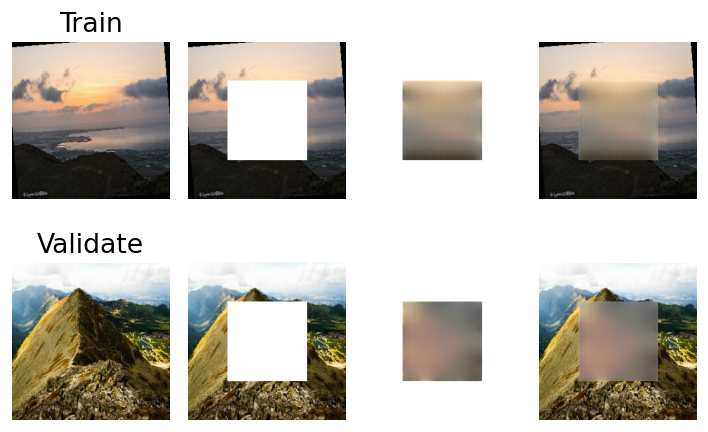

--- save mse models ---
Epoch 3
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.199120 PSNR: 7.191836



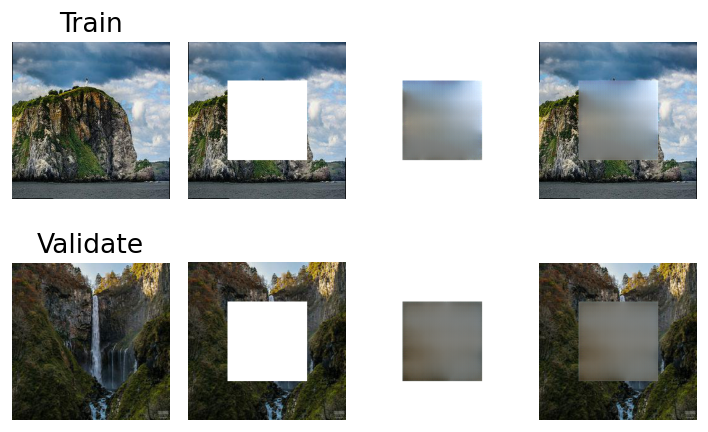

--- save mse models ---
Epoch 4
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.179870 PSNR: 7.607540



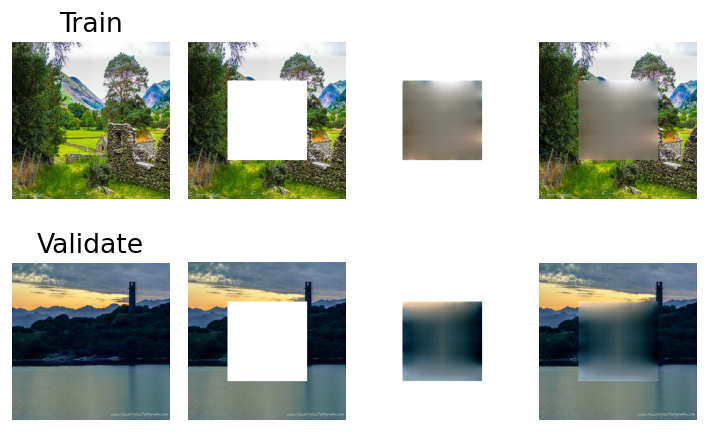

--- save mse models ---
Epoch 5
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.151890 PSNR: 8.299551



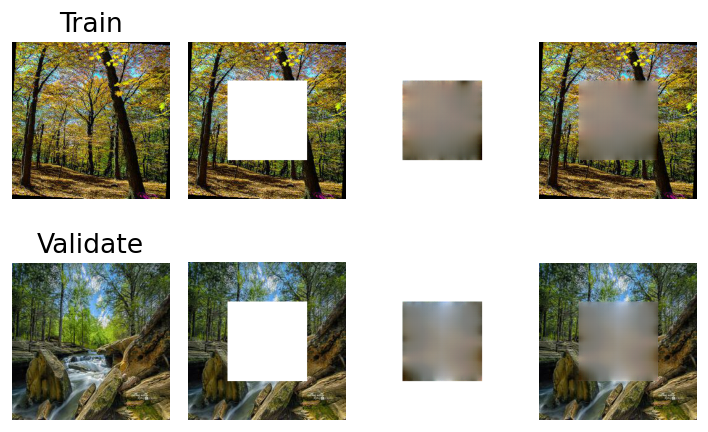

--- save mse models ---
Epoch 6
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.130608 PSNR: 8.985146



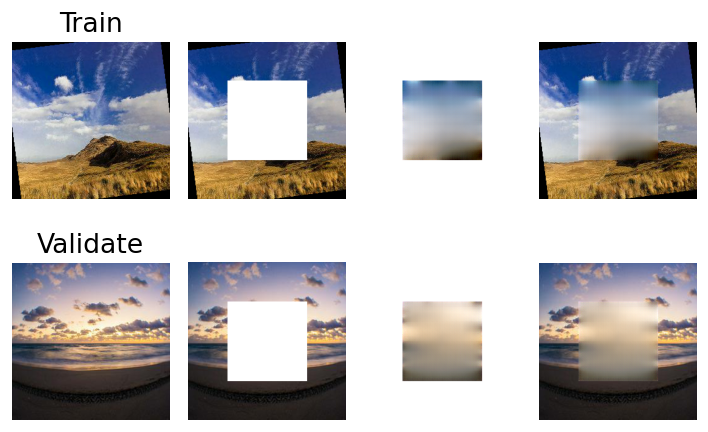

--- save mse models ---
Epoch 7
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.110175 PSNR: 9.725078



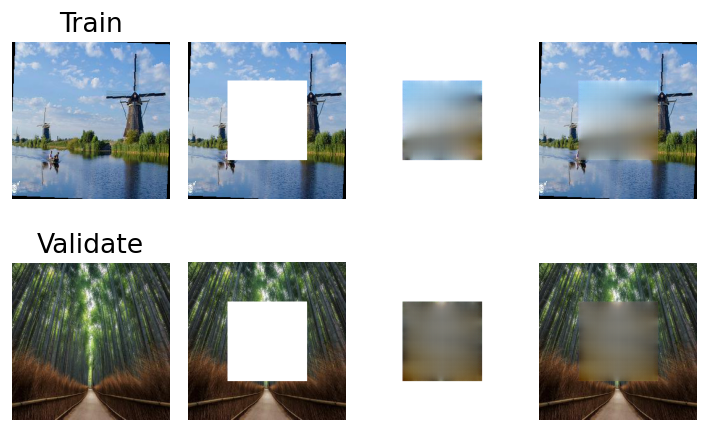

--- save mse models ---
Epoch 8
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.089885 PSNR: 10.633923



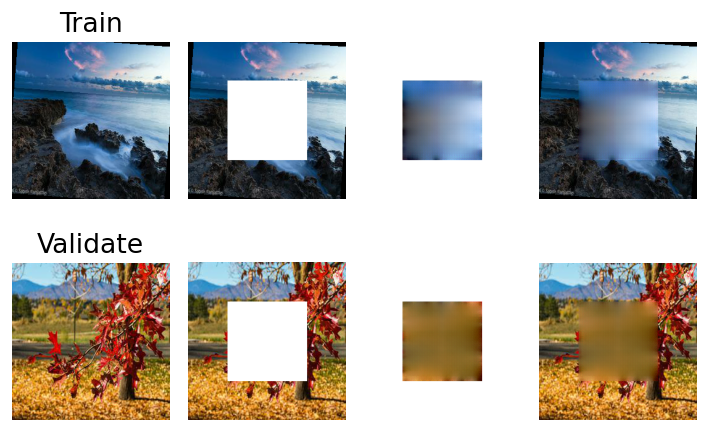

--- save mse models ---
Epoch 9
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.073076 PSNR: 11.598522



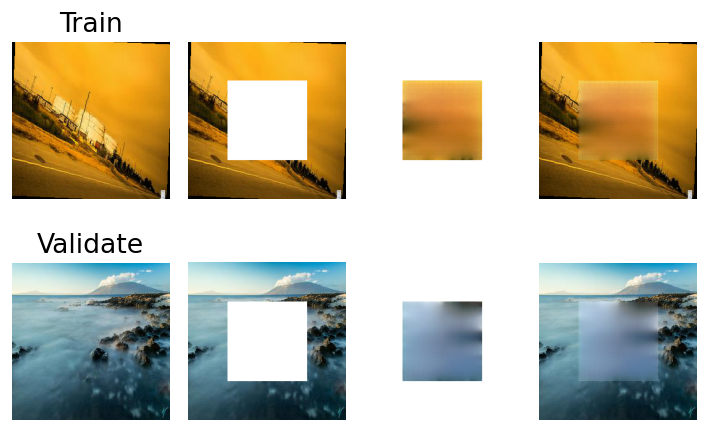

--- save mse models ---
Epoch 10
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.063481 PSNR: 12.214384



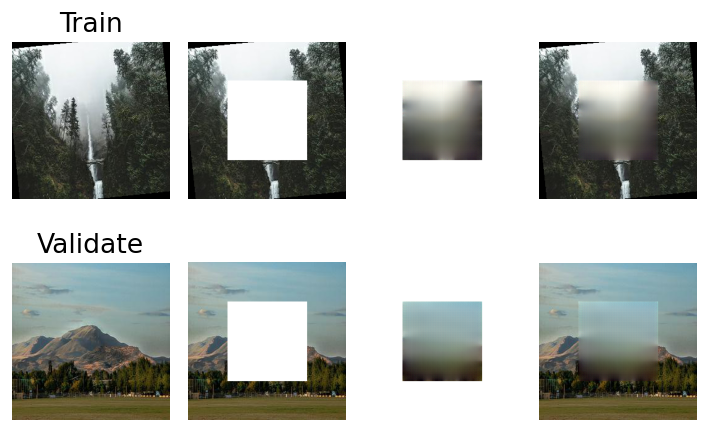

--- save mse models ---
Epoch 11
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.051396 PSNR: 13.191733



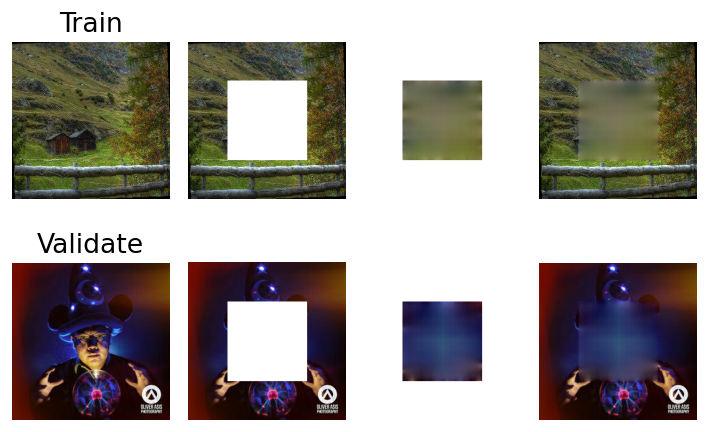

--- save mse models ---
Epoch 12
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.047423 PSNR: 13.625267



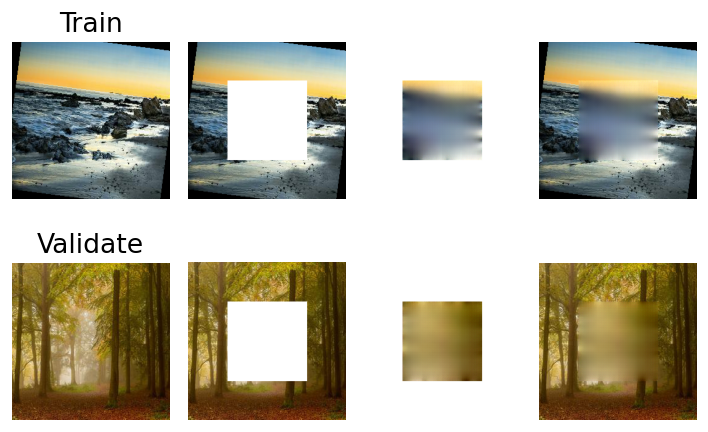

--- save mse models ---
Epoch 13
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.039093 PSNR: 14.506344



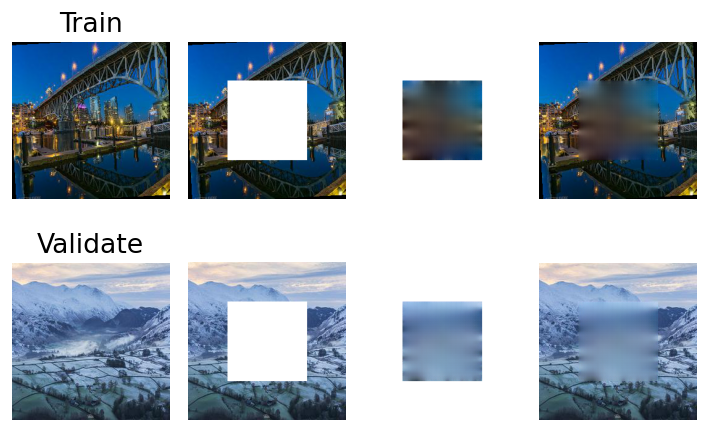

--- save mse models ---
Epoch 14
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.036238 PSNR: 14.962081



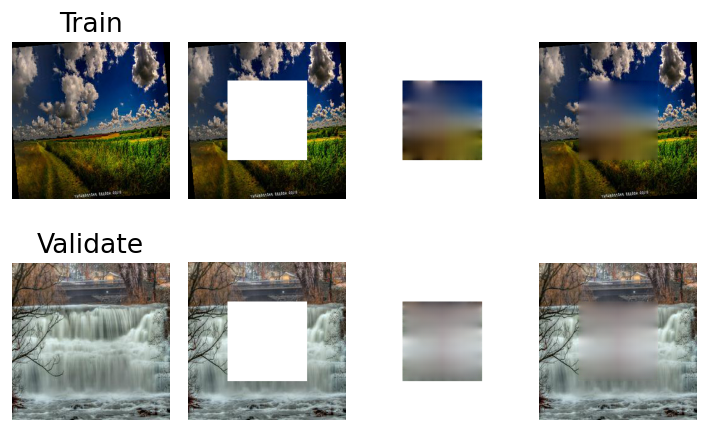

--- save mse models ---
Epoch 15
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.033926 PSNR: 15.275769



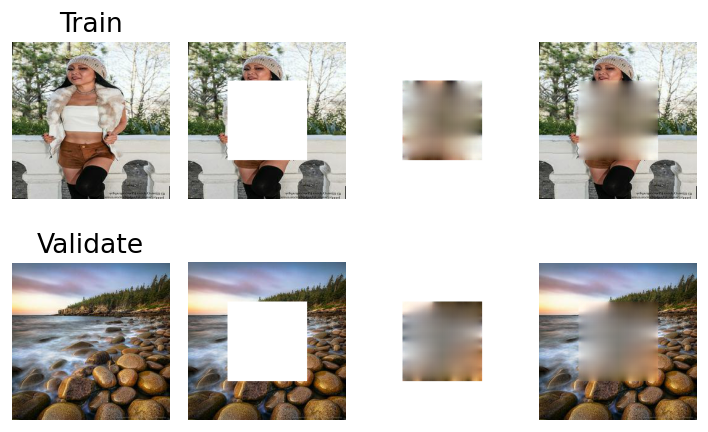

--- save mse models ---
Epoch 16
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.030870 PSNR: 15.687013



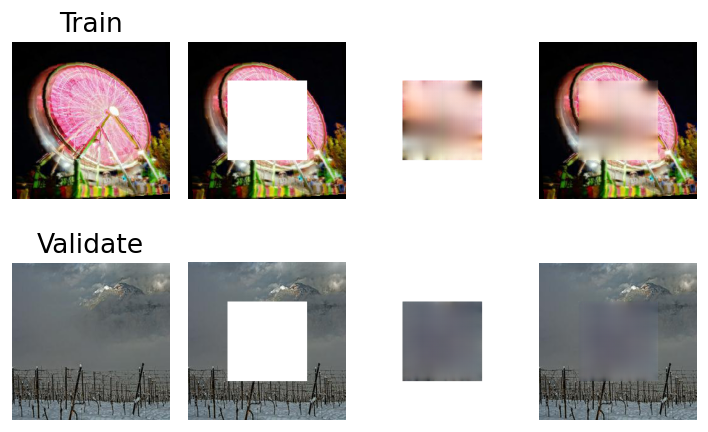

--- save mse models ---
Epoch 17
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029731 PSNR: 15.895952



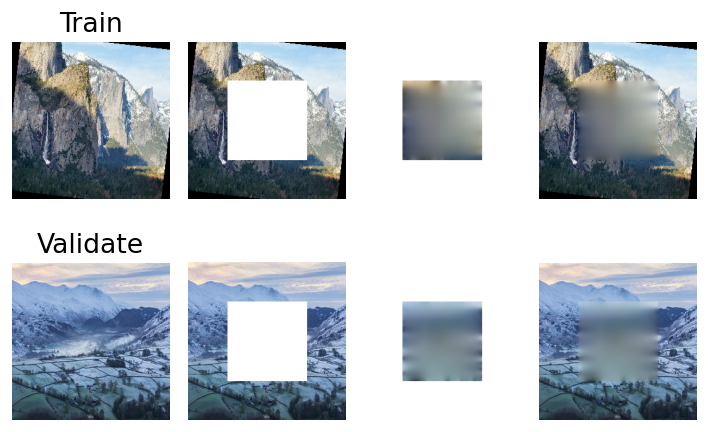

--- save mse models ---
Epoch 18
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029043 PSNR: 16.046644



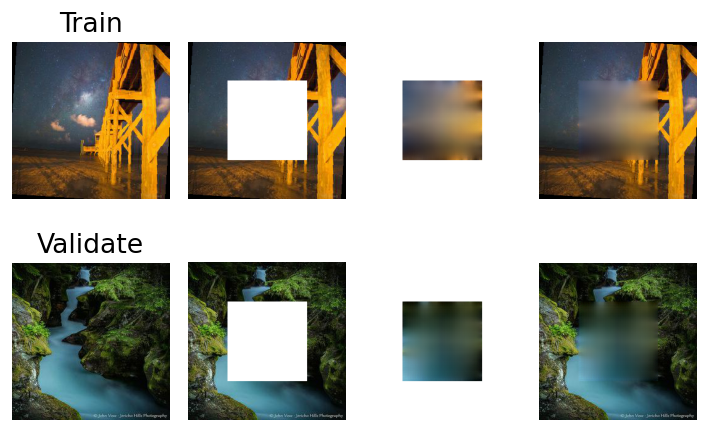

--- save mse models ---
Epoch 19
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.027756 PSNR: 16.246712



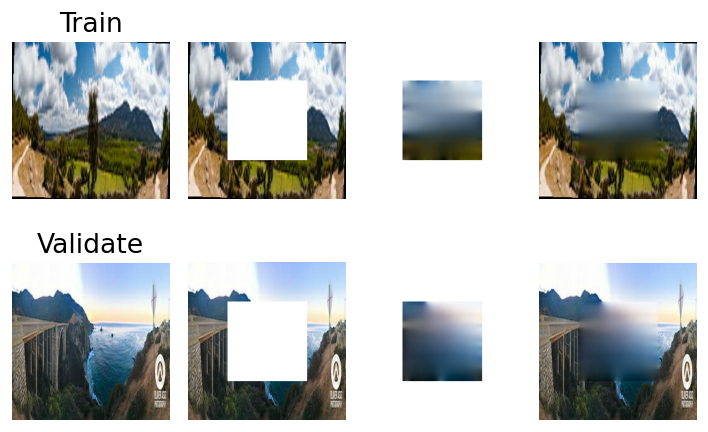

--- save mse models ---
Epoch 20
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028367 PSNR: 16.133648



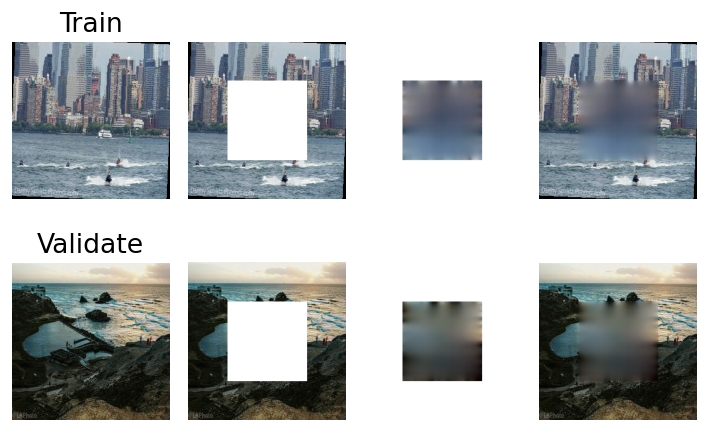

Epoch 21
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028204 PSNR: 16.182025



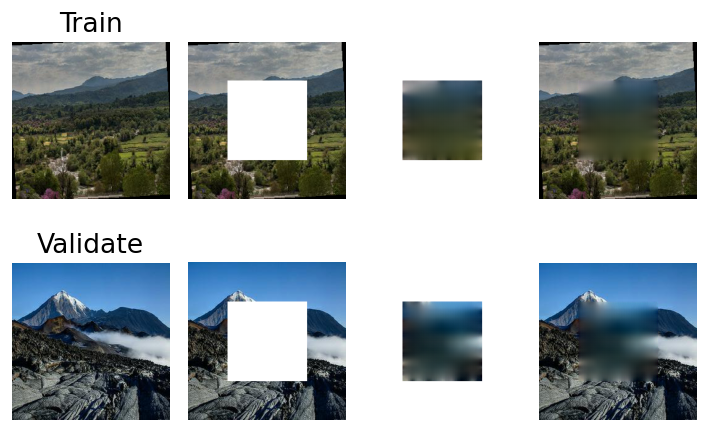

Epoch 22
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.026889 PSNR: 16.445304



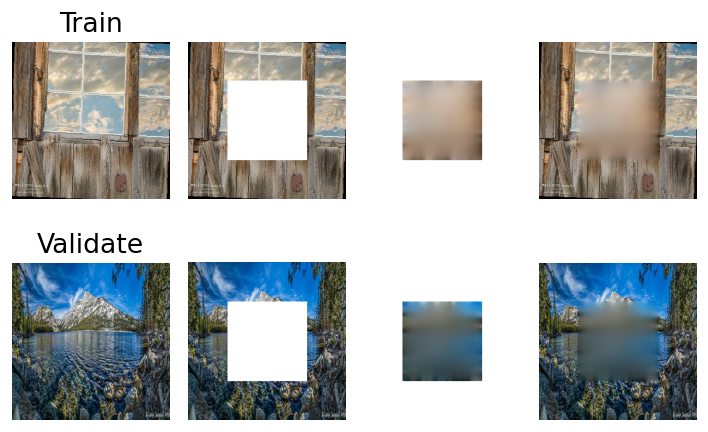

--- save mse models ---
Epoch 23
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.027871 PSNR: 16.285842



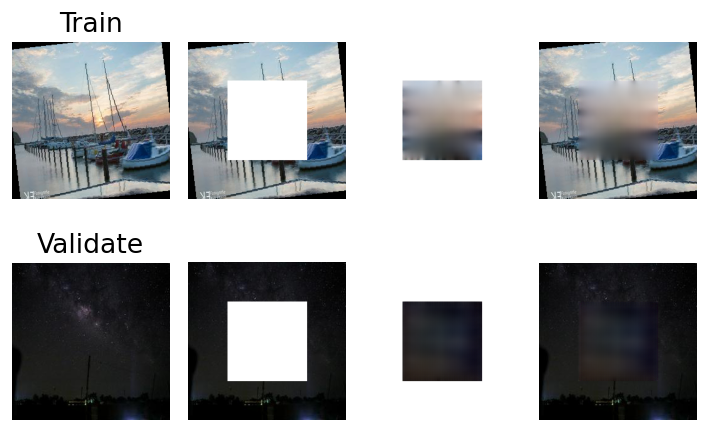

Epoch 24
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.027898 PSNR: 16.254918



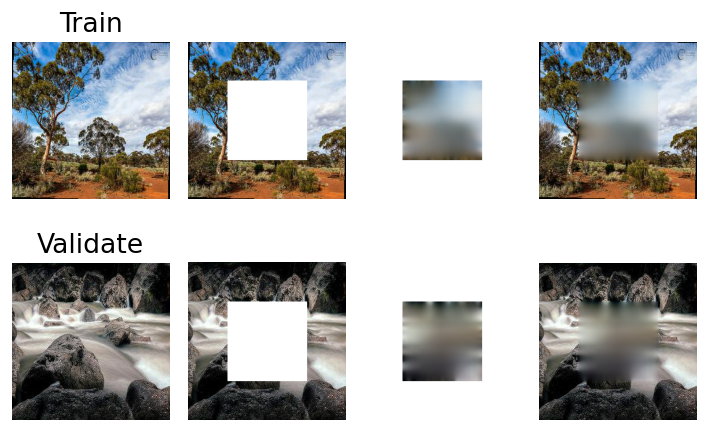

Epoch 25
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029040 PSNR: 16.030816



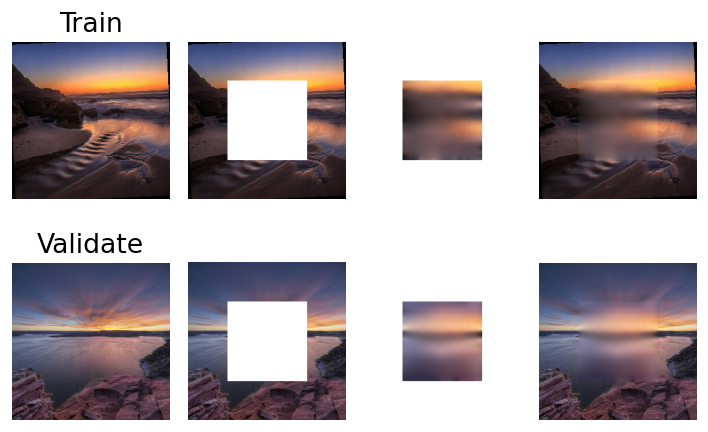

Epoch 26
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.027928 PSNR: 16.264413



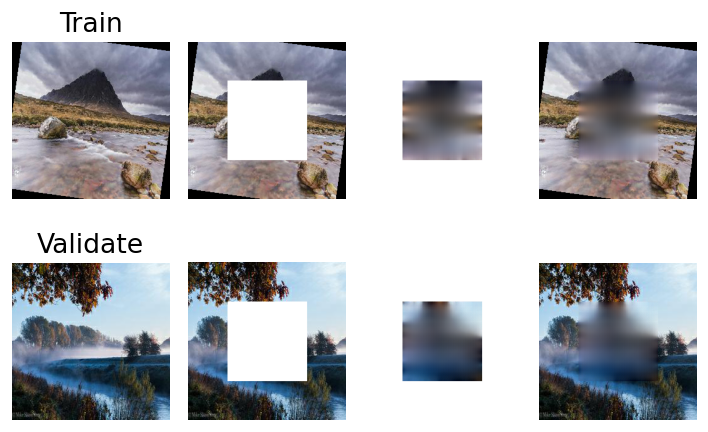

Epoch 27
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028154 PSNR: 16.214700



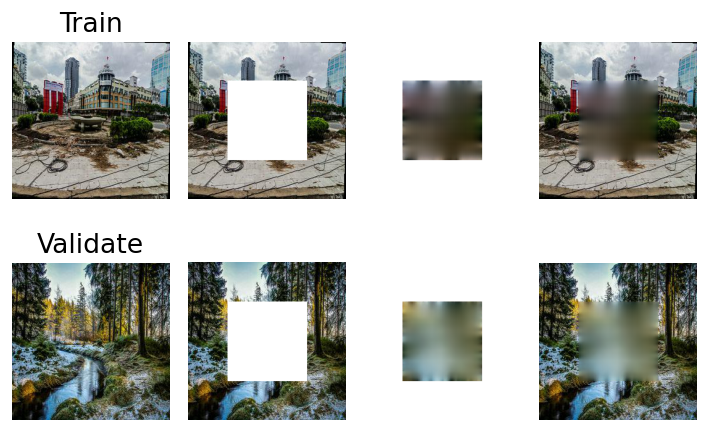

Epoch 28
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028301 PSNR: 16.217635



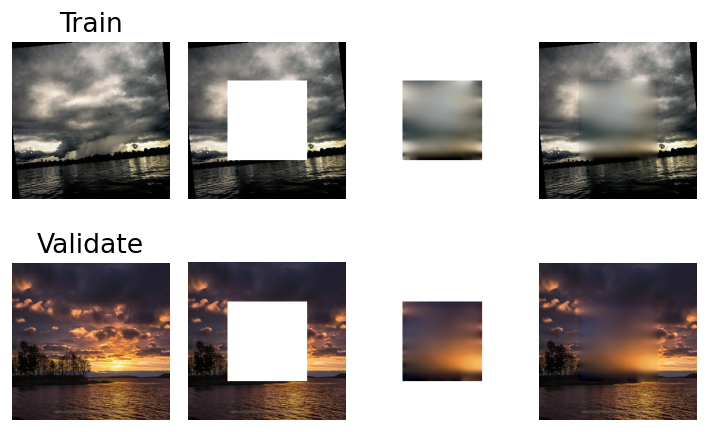

Epoch 29
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028387 PSNR: 16.180350



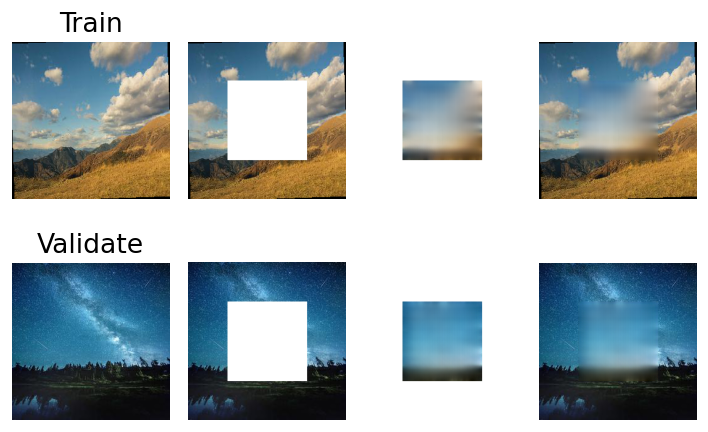

Epoch 30
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028691 PSNR: 16.133283



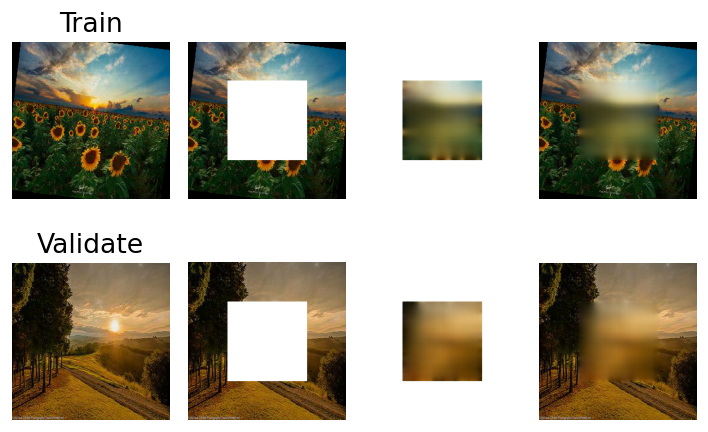

Epoch 31
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029703 PSNR: 15.923427



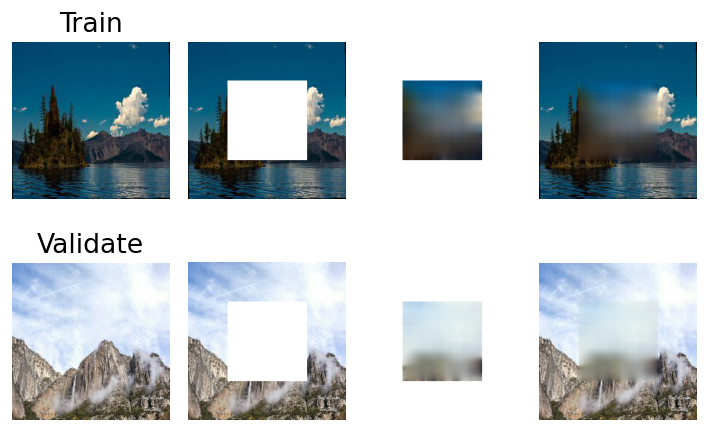

Epoch 32
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028063 PSNR: 16.279635



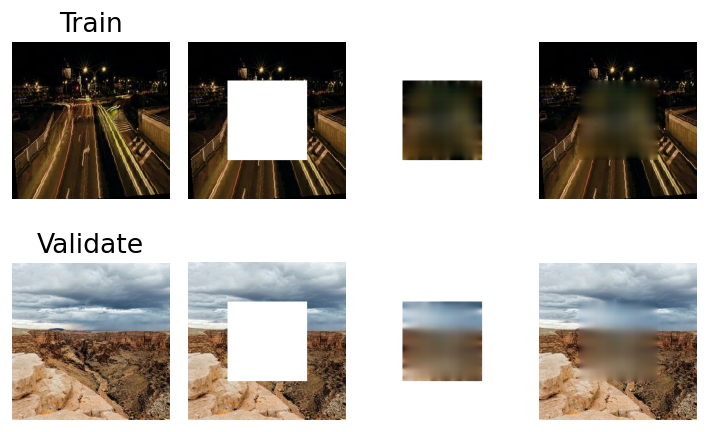

Epoch 33
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028312 PSNR: 16.186530



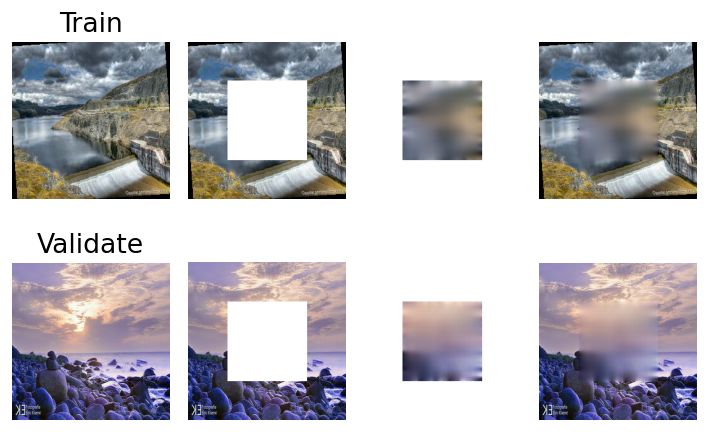

Epoch 34
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029366 PSNR: 15.989150



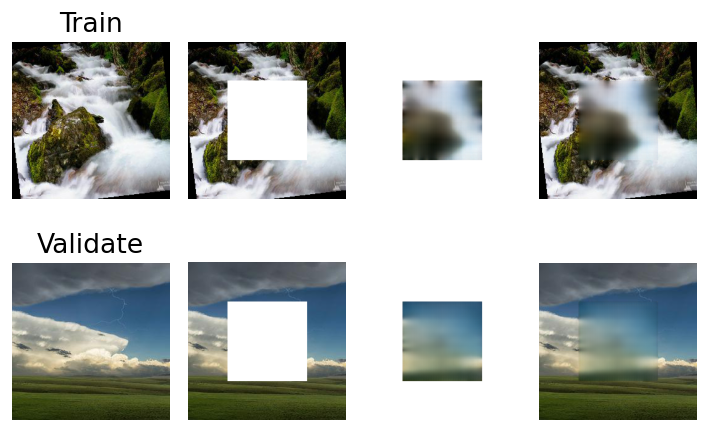

Epoch 35
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028219 PSNR: 16.193241



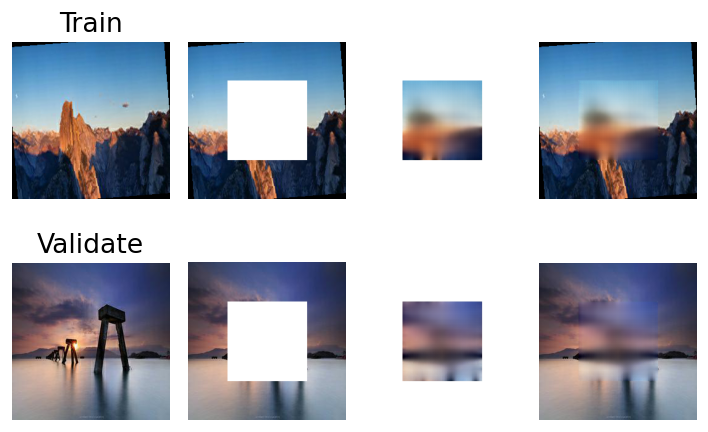

Epoch 36
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028833 PSNR: 16.142077



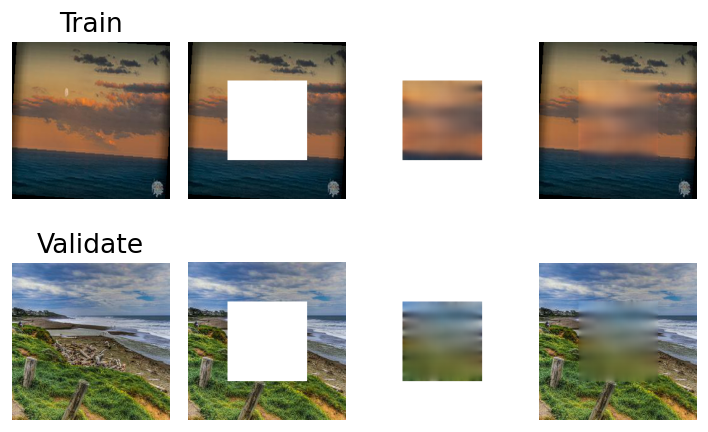

Epoch 37
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028556 PSNR: 16.162252



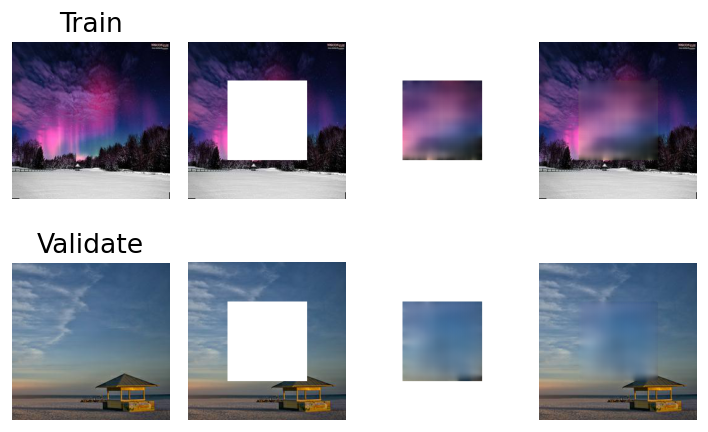

Epoch 38
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028154 PSNR: 16.238112



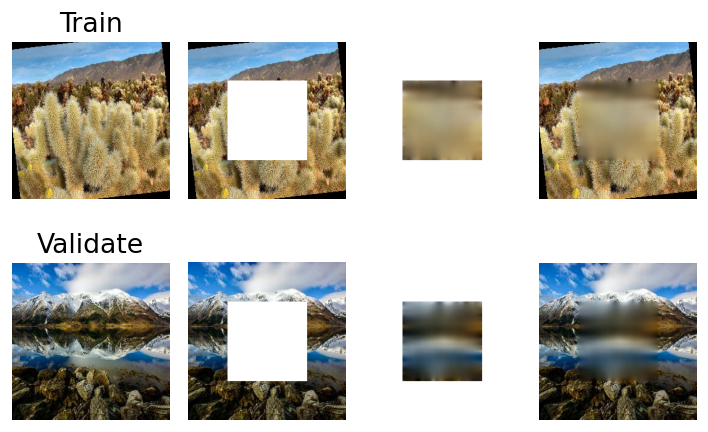

Epoch 39
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028952 PSNR: 16.096045



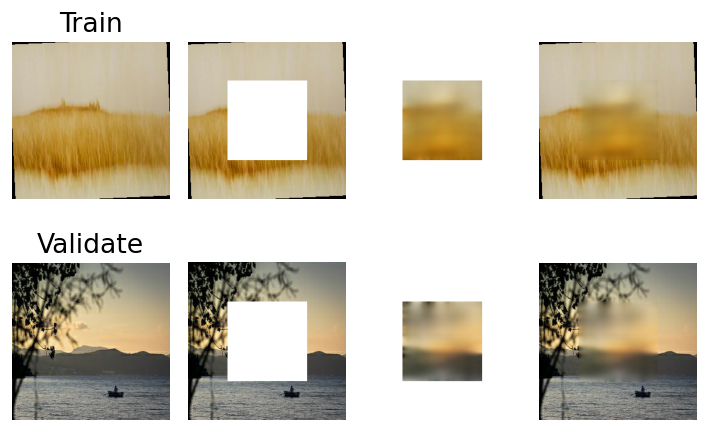

Epoch 40
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028256 PSNR: 16.186204



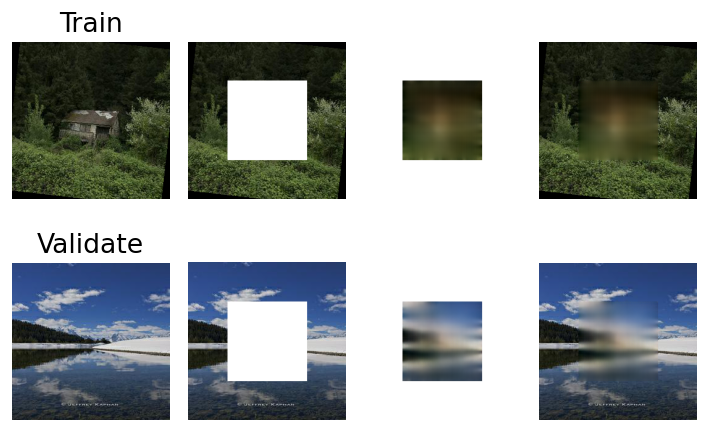

Epoch 41
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028423 PSNR: 16.159455



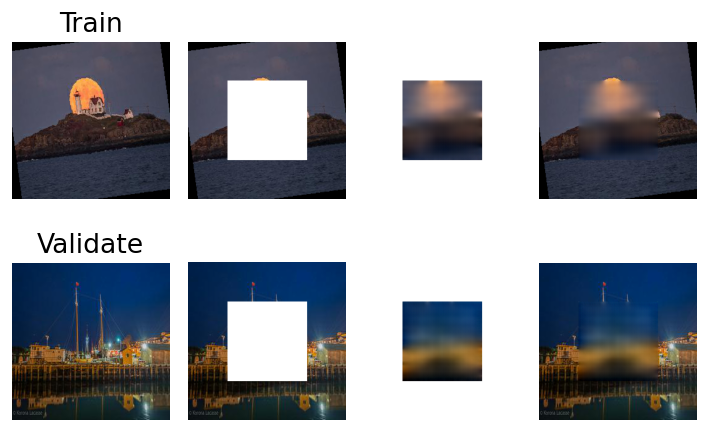

Epoch 42
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028668 PSNR: 16.142469



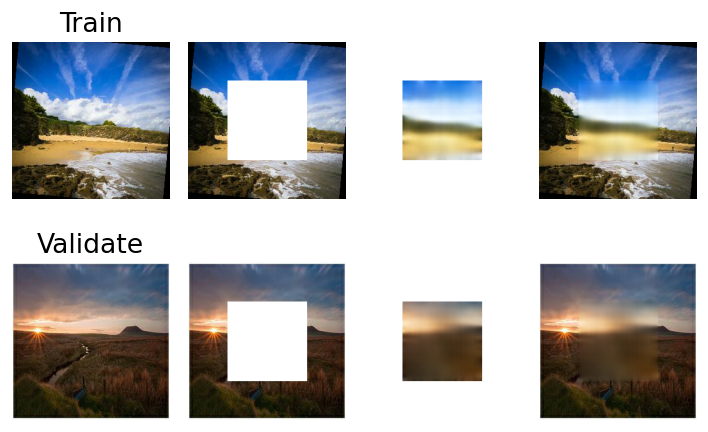

Epoch 43
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028863 PSNR: 16.129218



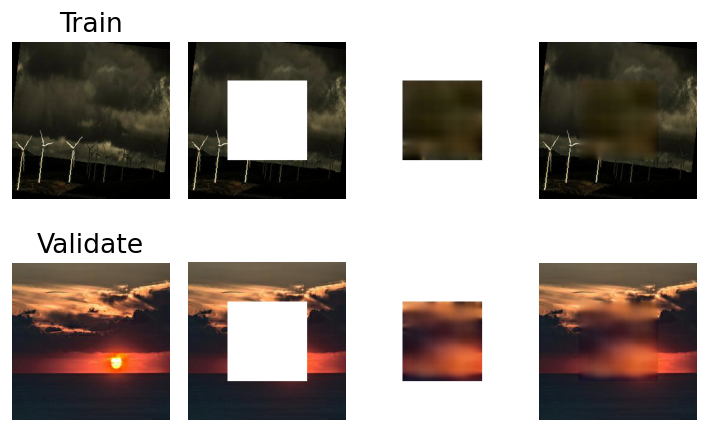

Epoch 44
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028283 PSNR: 16.226540



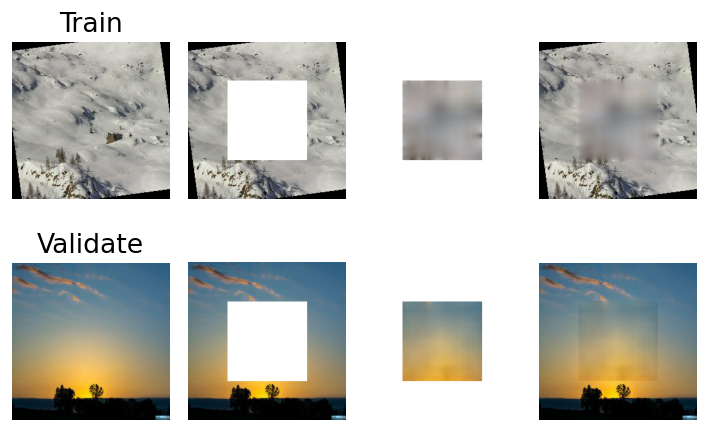

Epoch 45
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028304 PSNR: 16.237652



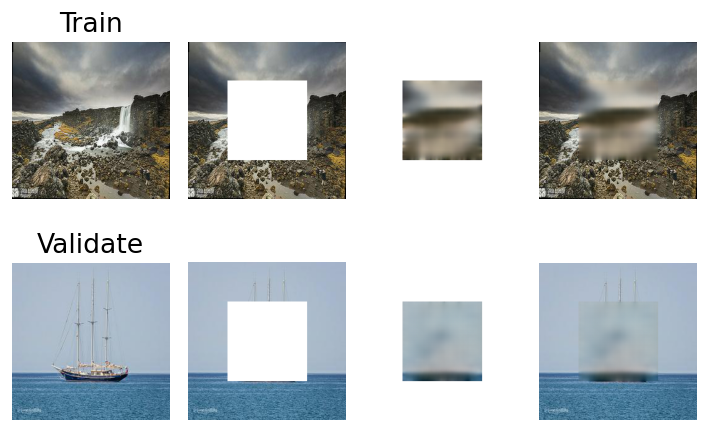

Epoch 46
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028685 PSNR: 16.138596



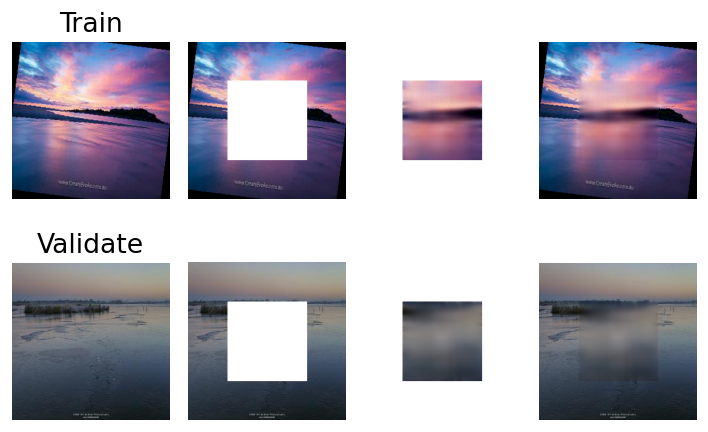

Epoch 47
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029364 PSNR: 16.029477



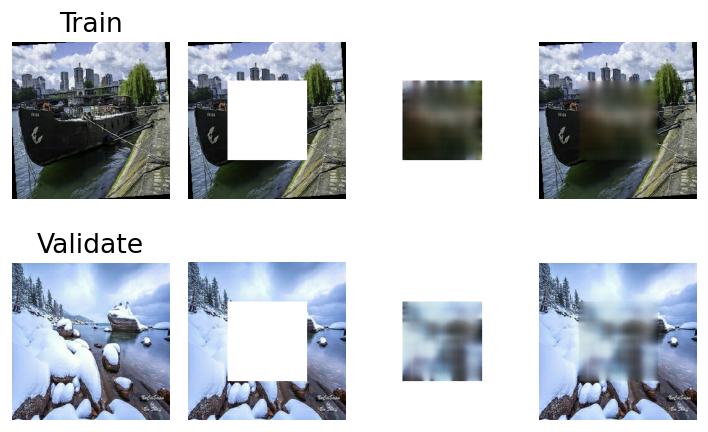

Epoch 48
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028068 PSNR: 16.268628



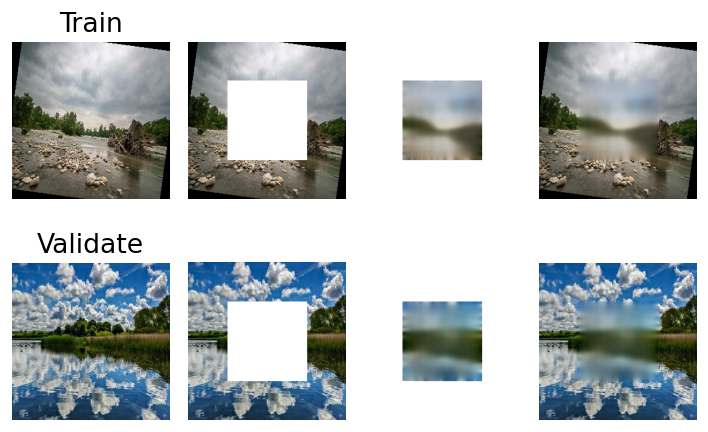

Epoch 49
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028695 PSNR: 16.145984



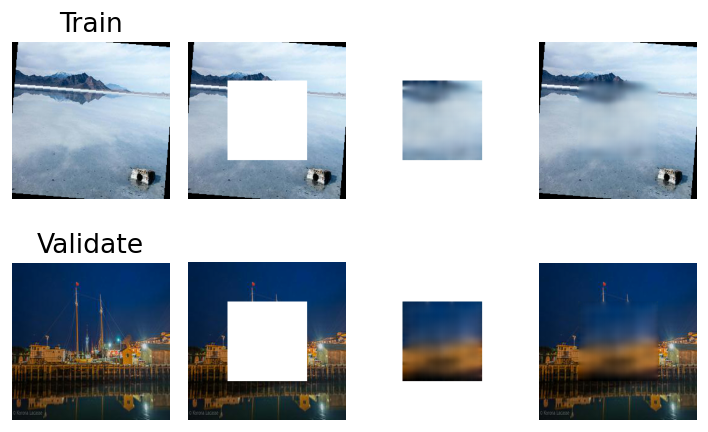

Epoch 50
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028934 PSNR: 16.137761



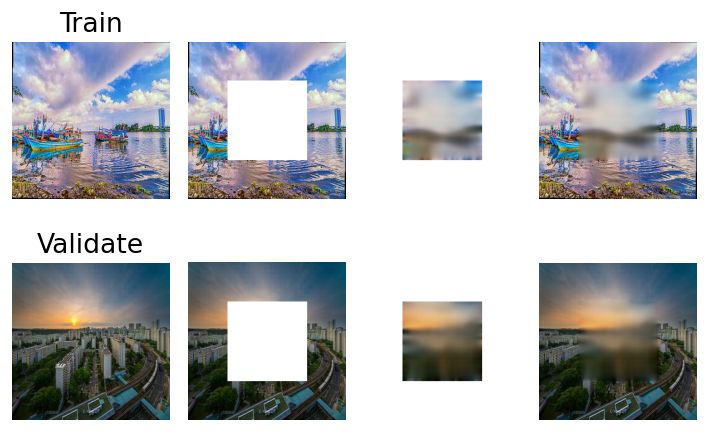

Epoch 51
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028163 PSNR: 16.273518



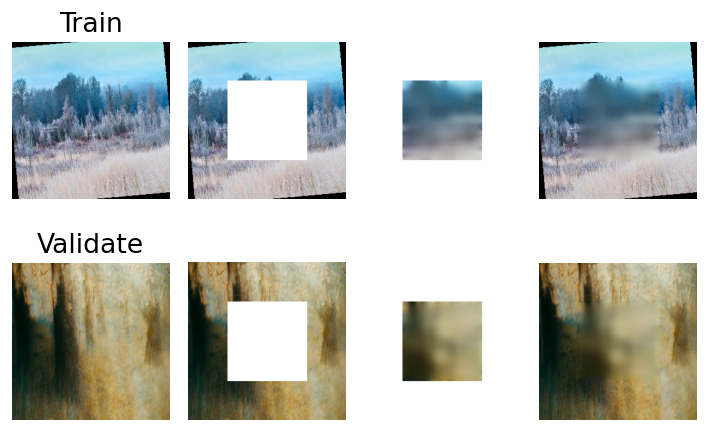

Epoch 52
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028050 PSNR: 16.267384



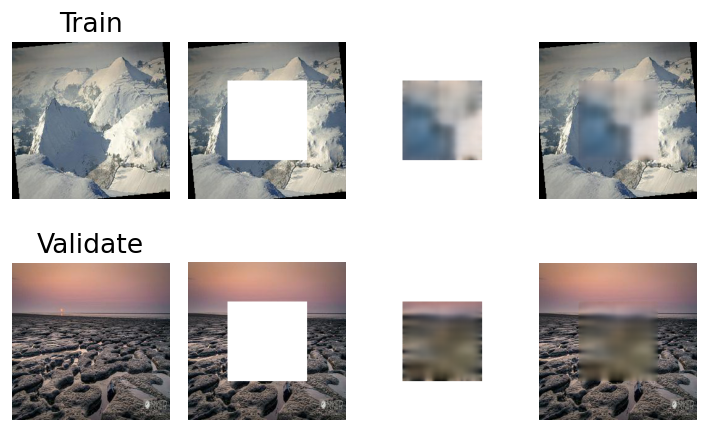

Epoch 53
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028190 PSNR: 16.260721



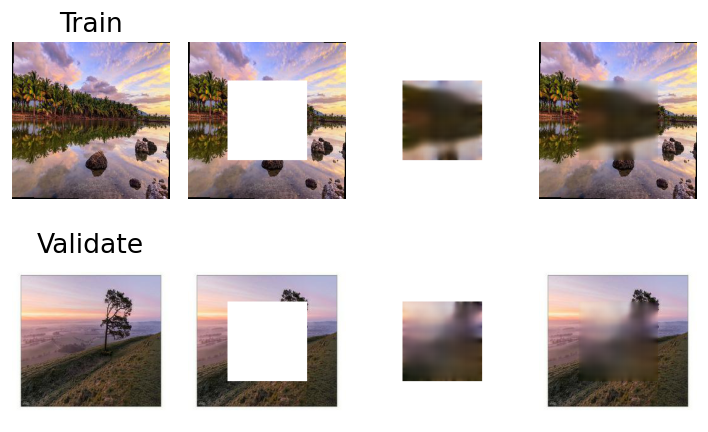

Epoch 54
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029220 PSNR: 16.038781



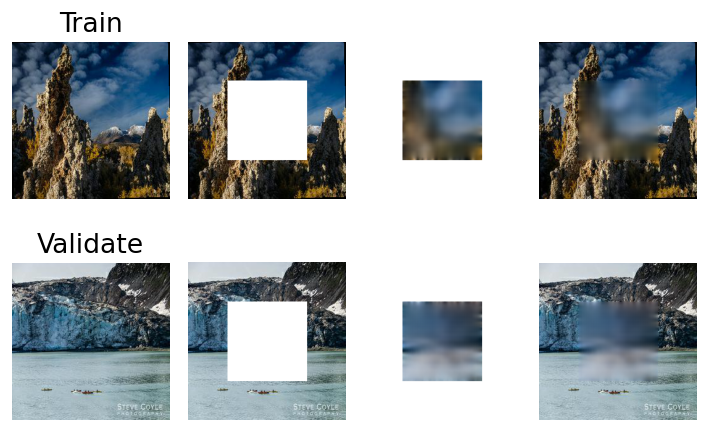

Epoch 55
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028555 PSNR: 16.194452



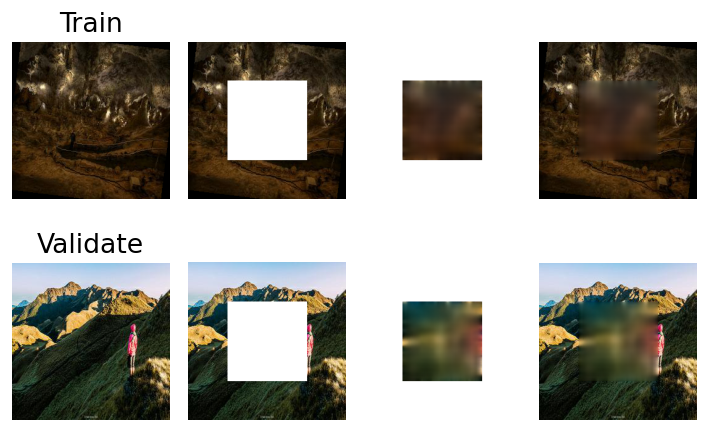

Epoch 56
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028245 PSNR: 16.273548



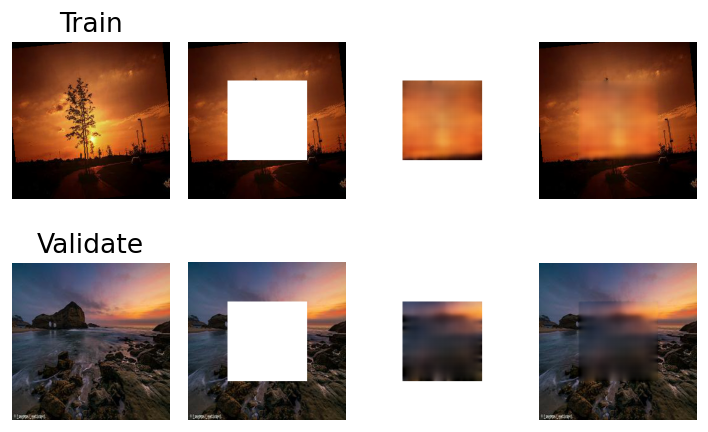

Epoch 57
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029485 PSNR: 16.032652



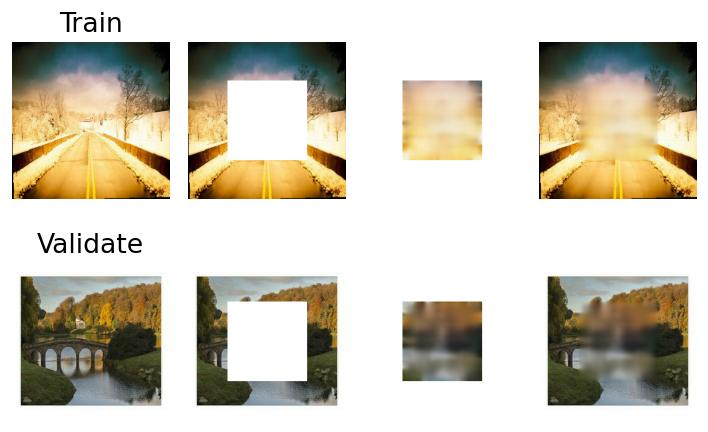

Epoch 58
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.030192 PSNR: 15.897545



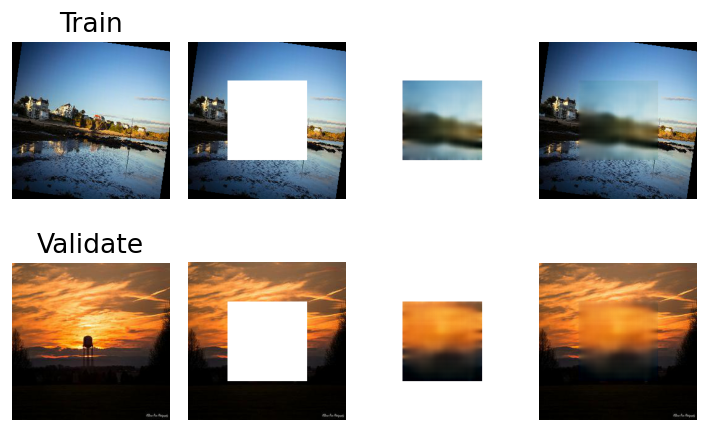

Epoch 59
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028753 PSNR: 16.144404



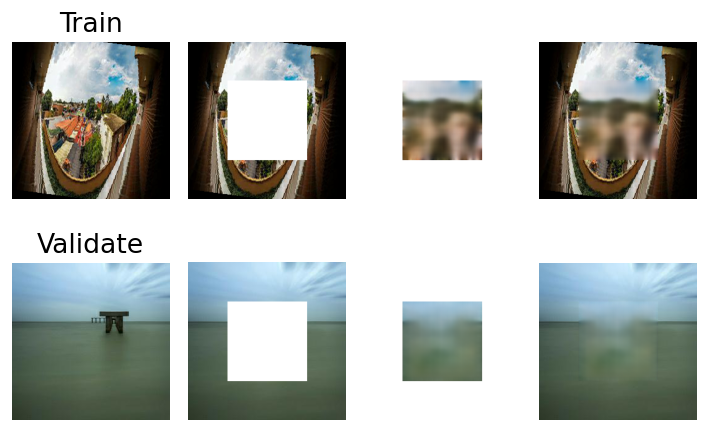

Epoch 60
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028811 PSNR: 16.177566



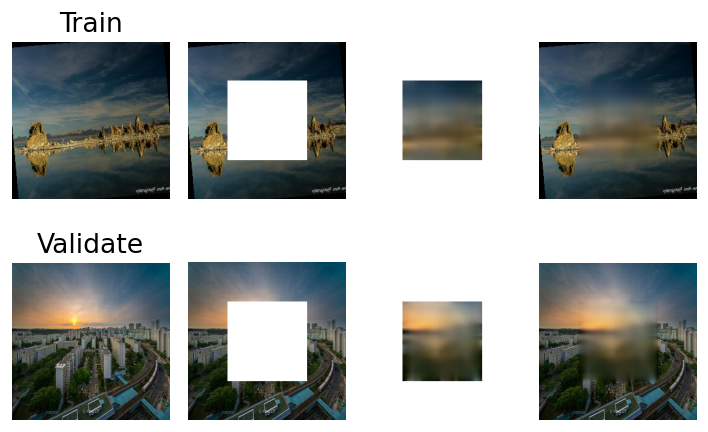

Epoch 61
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028511 PSNR: 16.180067



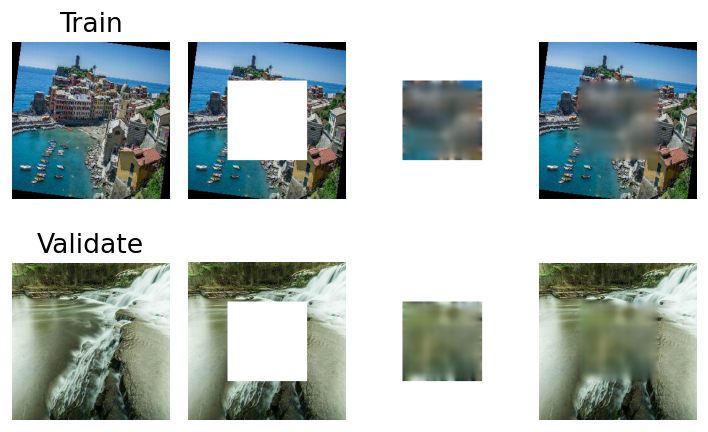

Epoch 62
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028334 PSNR: 16.220176



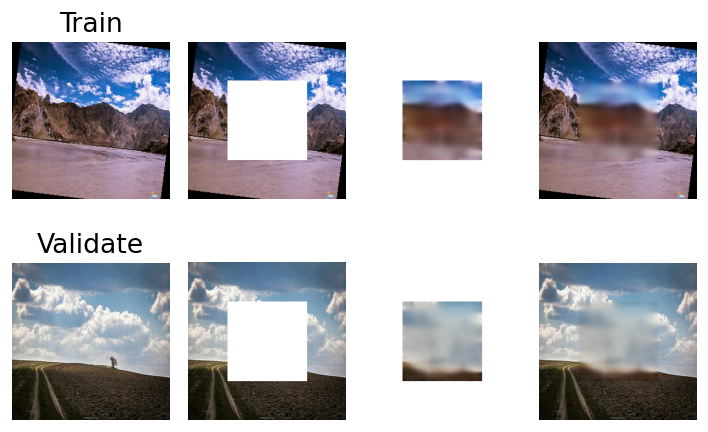

Epoch 63
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028789 PSNR: 16.172555



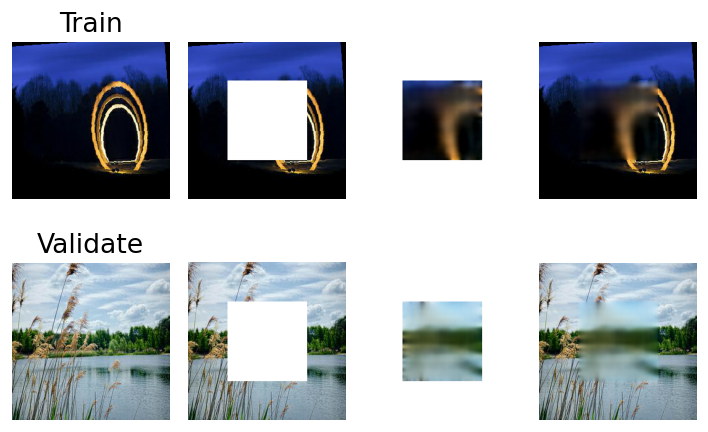

Epoch 64
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028360 PSNR: 16.244876



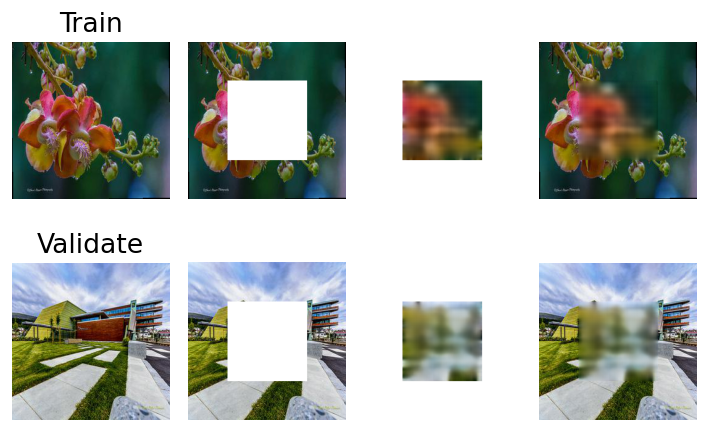

Epoch 65
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028898 PSNR: 16.105017



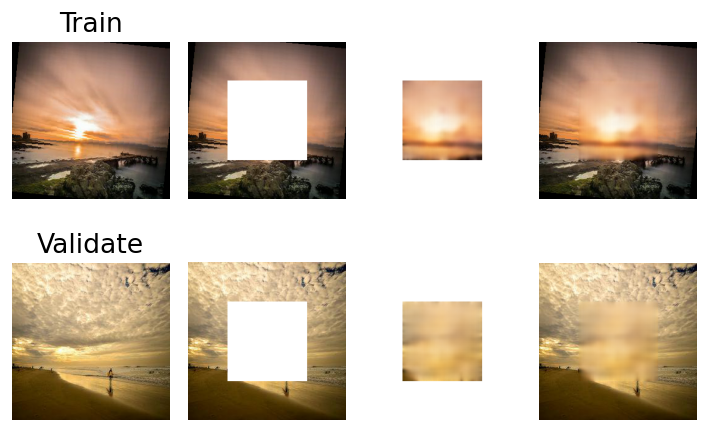

Epoch 66
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028464 PSNR: 16.210539



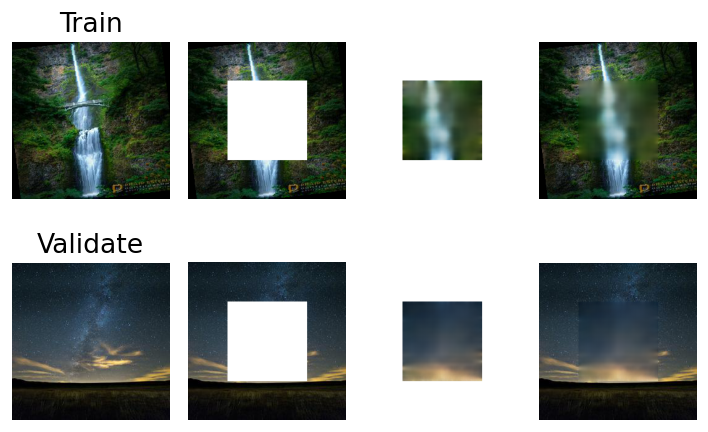

Epoch 67
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028995 PSNR: 16.186515



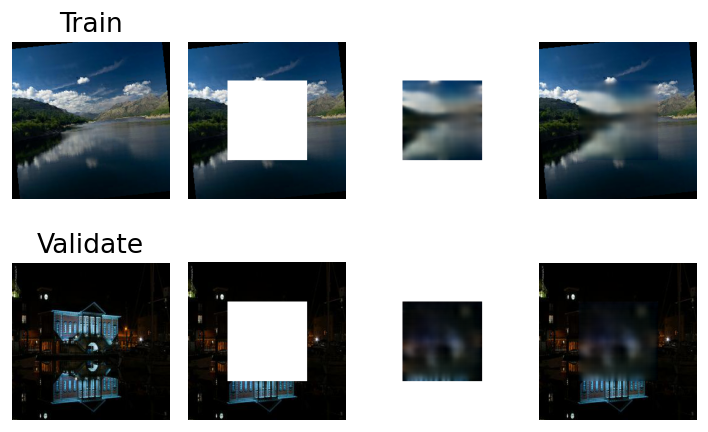

Epoch 68
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028394 PSNR: 16.237081



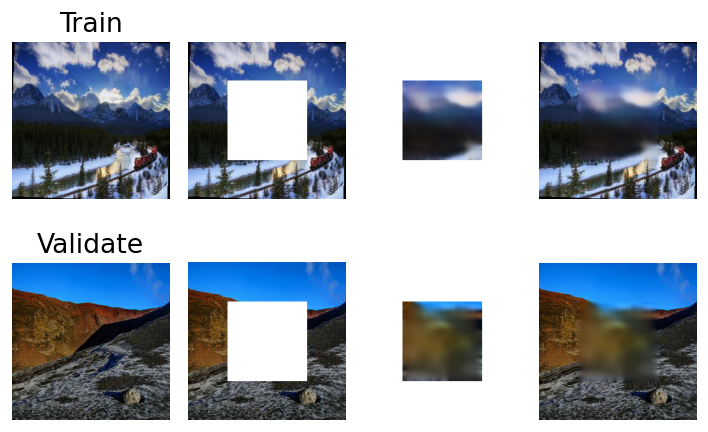

Epoch 69
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028119 PSNR: 16.274575



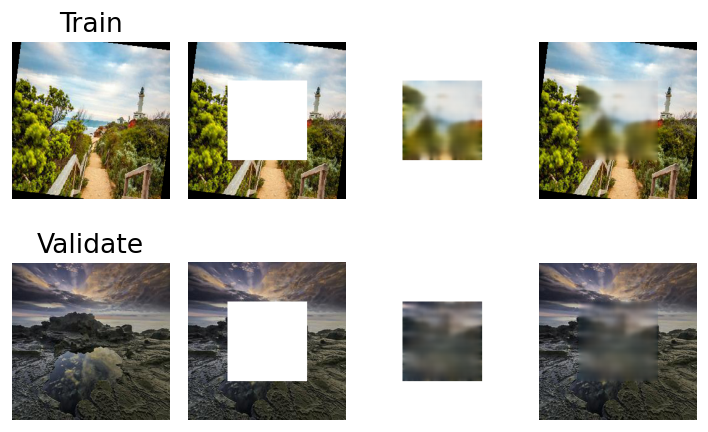

Epoch 70
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028206 PSNR: 16.241584



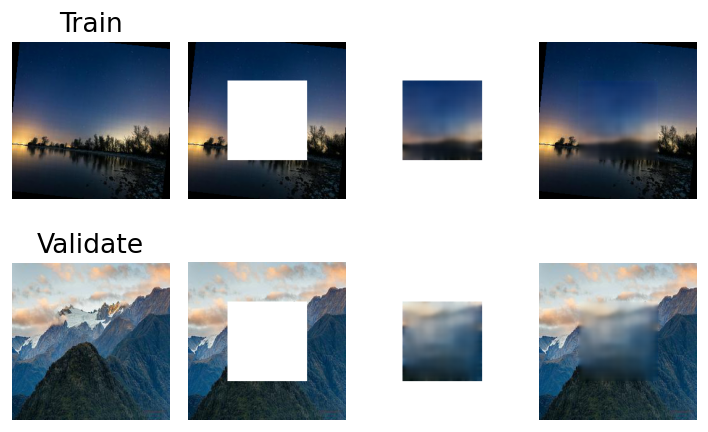

Epoch 71
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.027639 PSNR: 16.392338



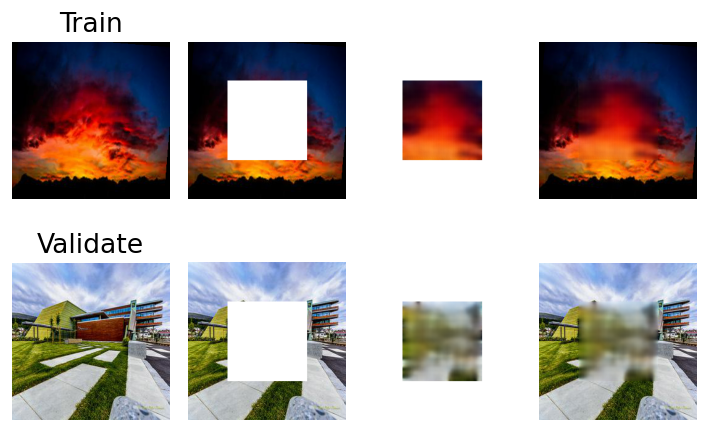

Epoch 72
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029146 PSNR: 16.090729



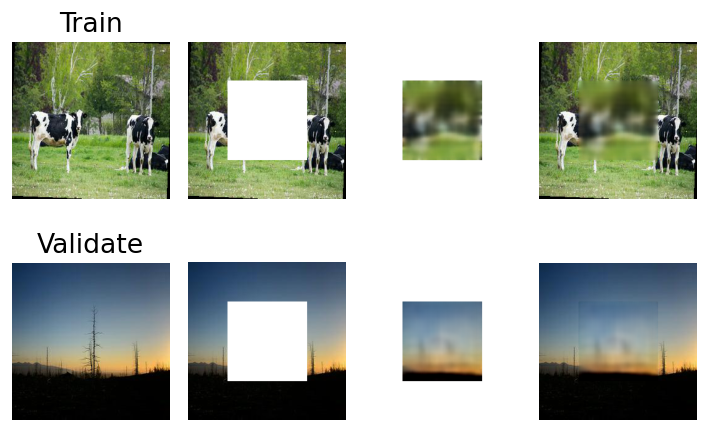

Epoch 73
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028437 PSNR: 16.218260



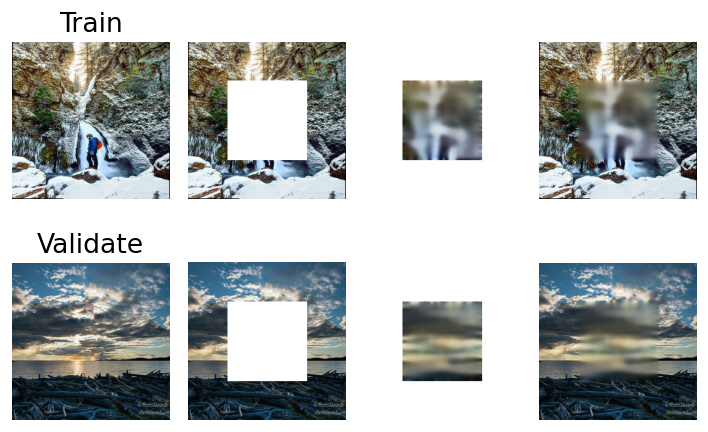

Epoch 74
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028553 PSNR: 16.219950



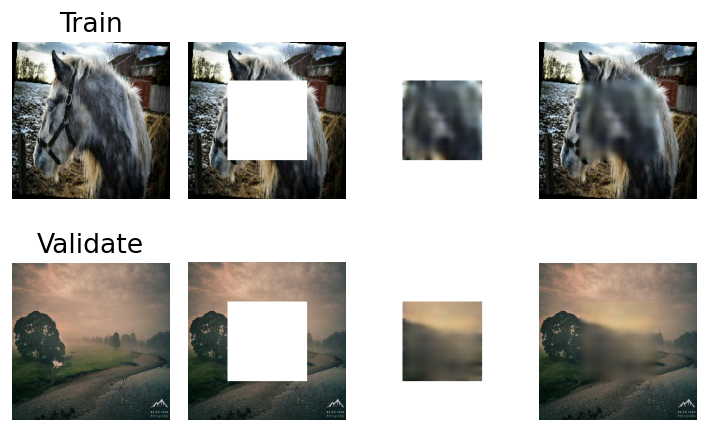

Epoch 75
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028324 PSNR: 16.246136



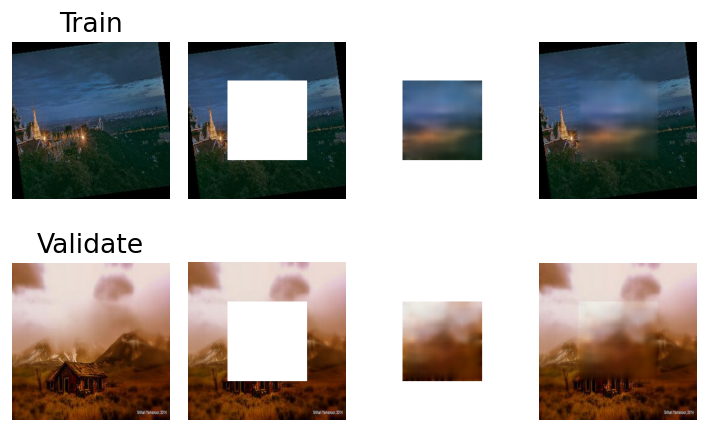

Epoch 76
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028185 PSNR: 16.292035



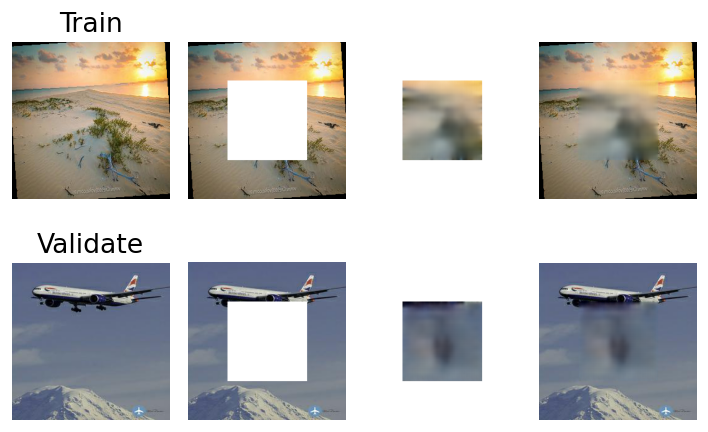

Epoch 77
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028691 PSNR: 16.219803



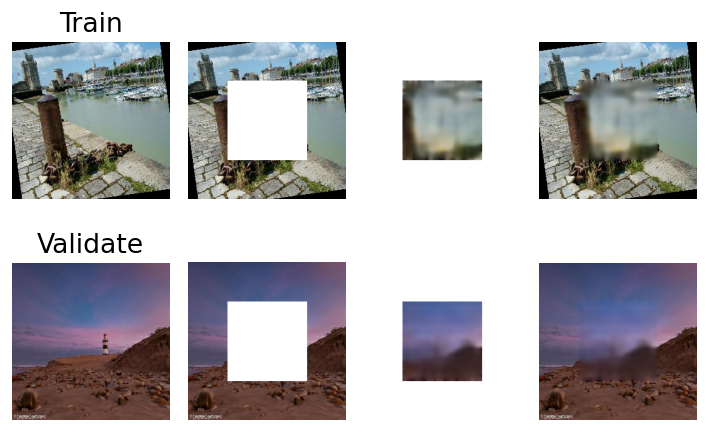

Epoch 78
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029433 PSNR: 16.067021



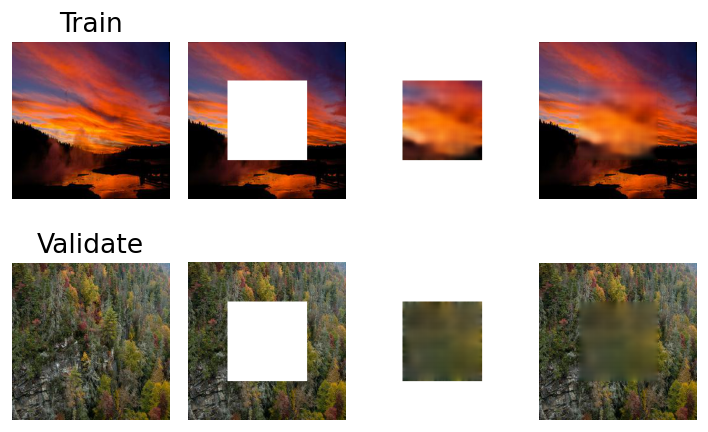

Epoch 79
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028393 PSNR: 16.250053



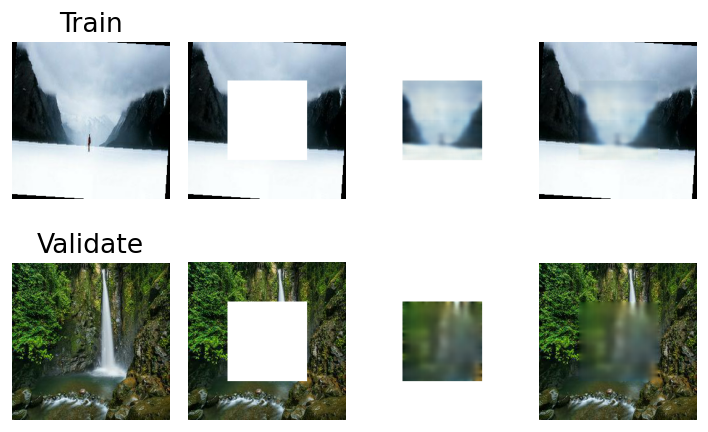

Epoch 80
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028432 PSNR: 16.236561



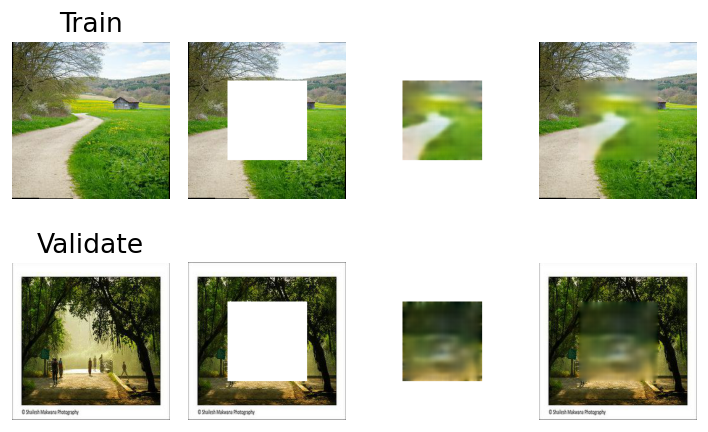

Epoch 81
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029056 PSNR: 16.125073



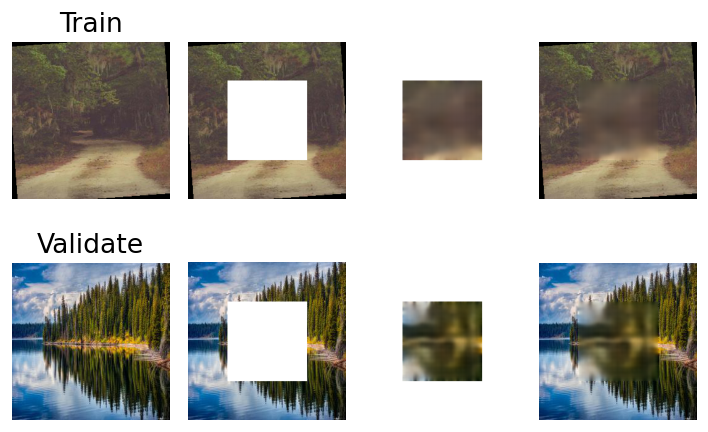

Epoch 82
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.027873 PSNR: 16.376793



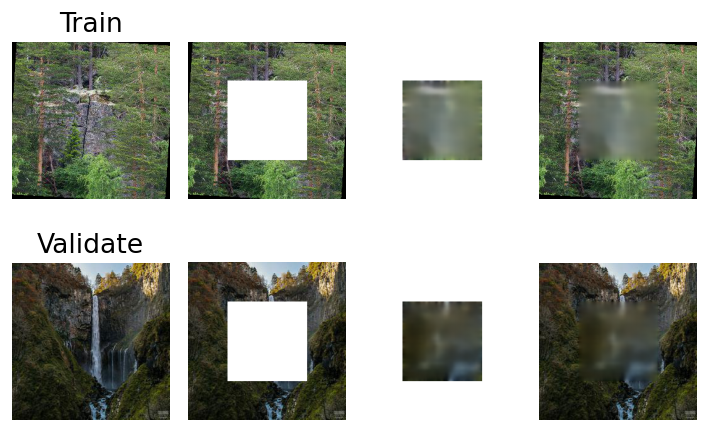

Epoch 83
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028531 PSNR: 16.221313



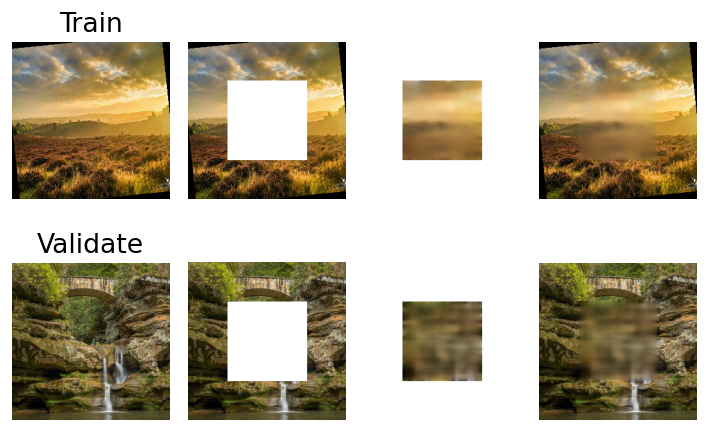

Epoch 84
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028557 PSNR: 16.216282



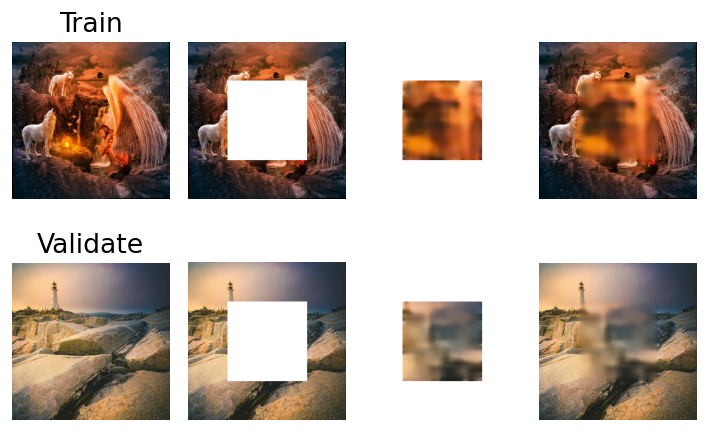

Epoch 85
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:99.991
Validate Error:
 MSE loss: 0.028609 PSNR: 16.187077



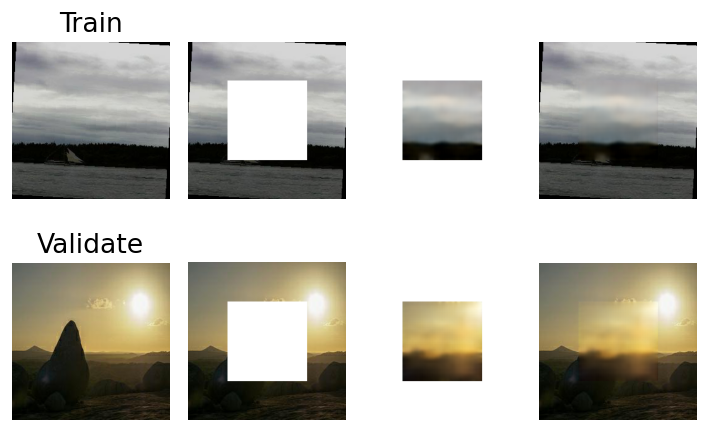

Epoch 86
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.027940 PSNR: 16.367446



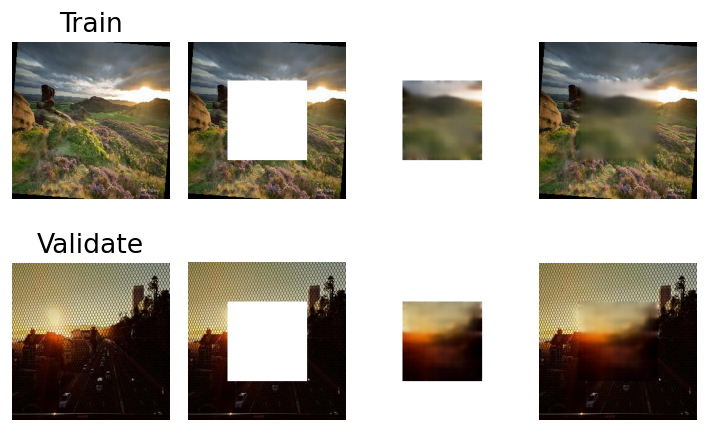

Epoch 87
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028664 PSNR: 16.201351



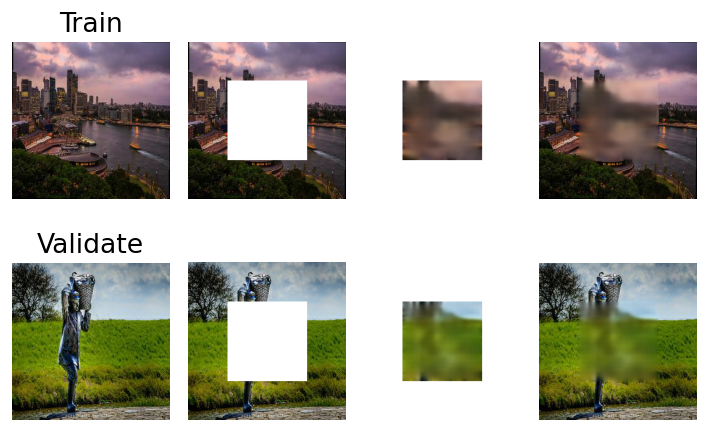

Epoch 88
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028775 PSNR: 16.206703



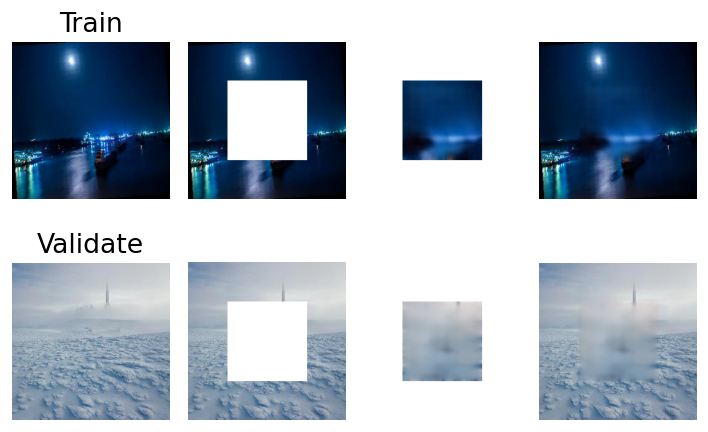

Epoch 89
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029169 PSNR: 16.097562



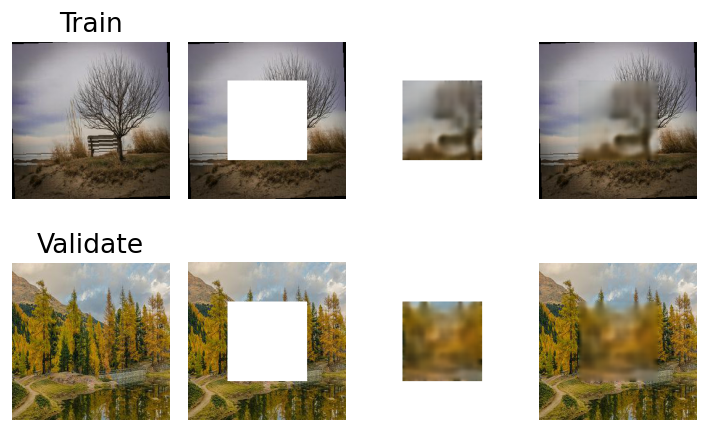

Epoch 90
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029313 PSNR: 16.104375



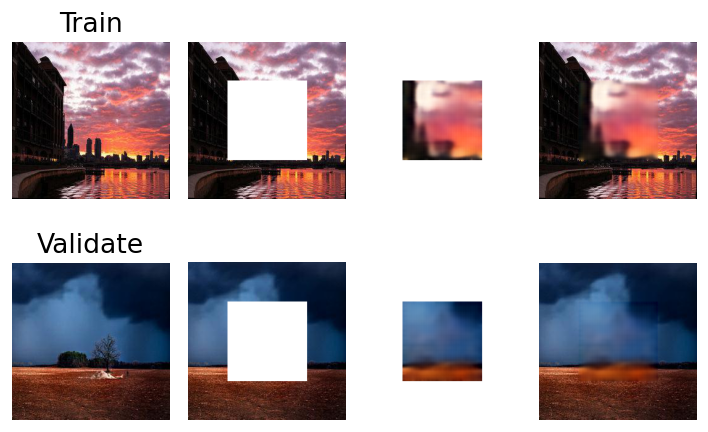

Epoch 91
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028571 PSNR: 16.208492



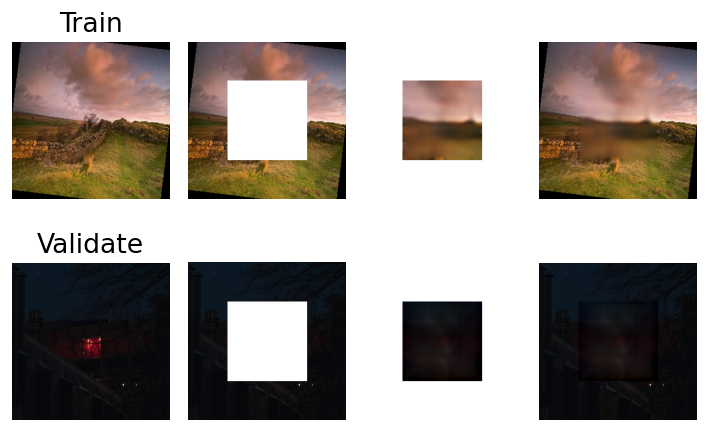

Epoch 92
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029120 PSNR: 16.122055



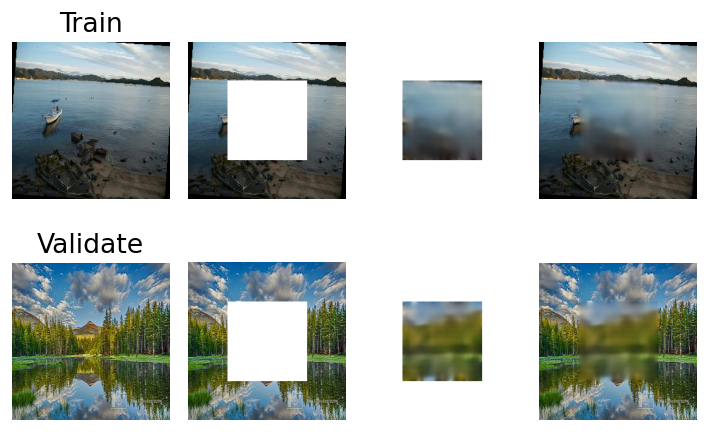

Epoch 93
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029233 PSNR: 16.075789



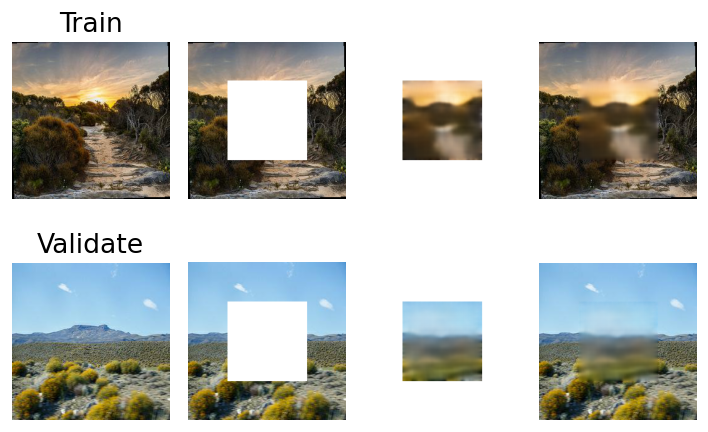

Epoch 94
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028365 PSNR: 16.278562



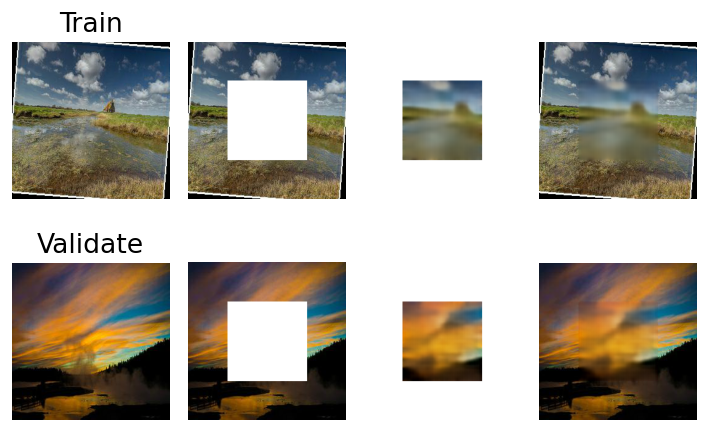

Epoch 95
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028997 PSNR: 16.129130



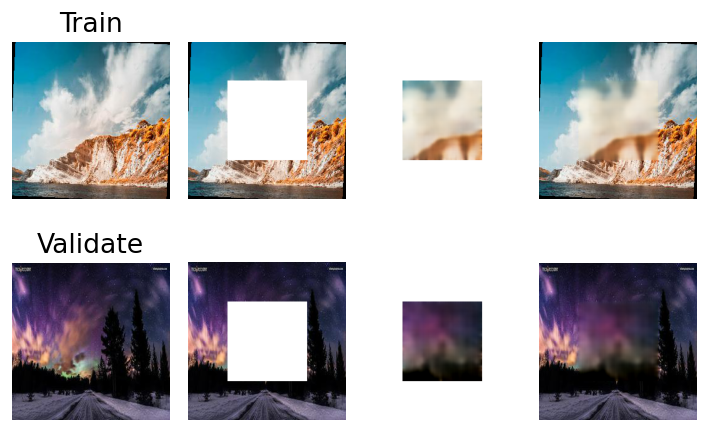

Epoch 96
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028190 PSNR: 16.307248



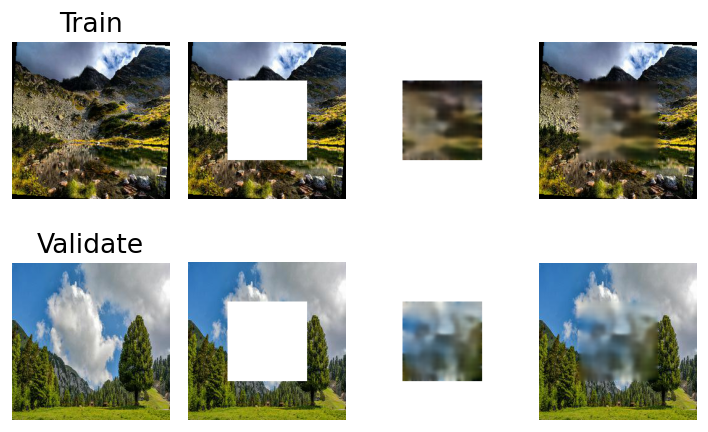

Epoch 97
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029621 PSNR: 16.014050



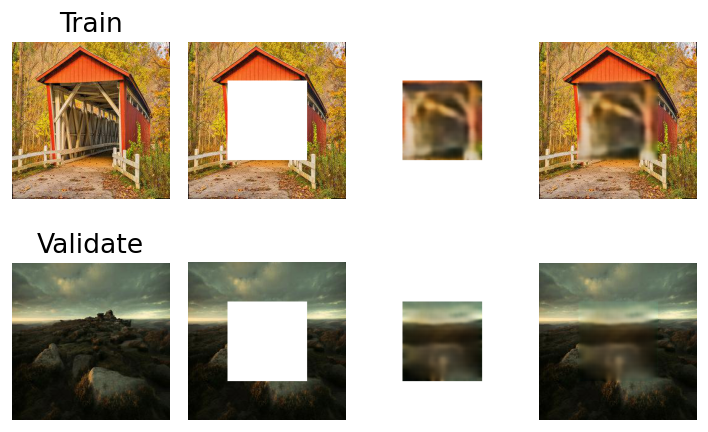

Epoch 98
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028434 PSNR: 16.241235



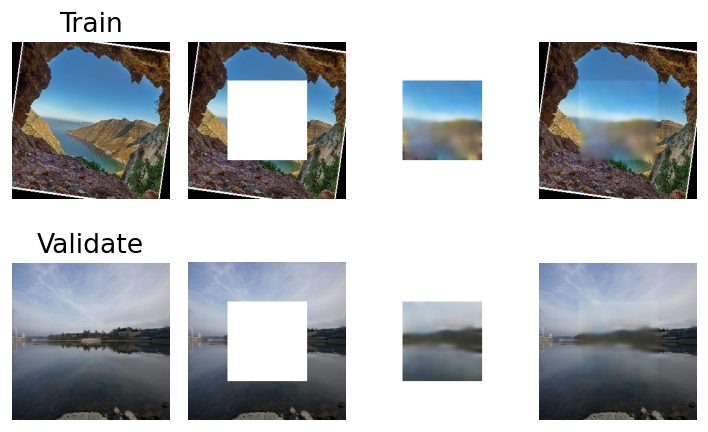

Epoch 99
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028119 PSNR: 16.320413



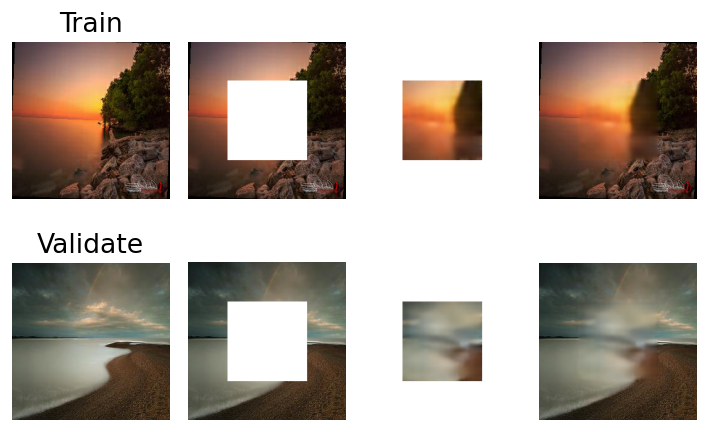

Epoch 100
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029554 PSNR: 16.081010



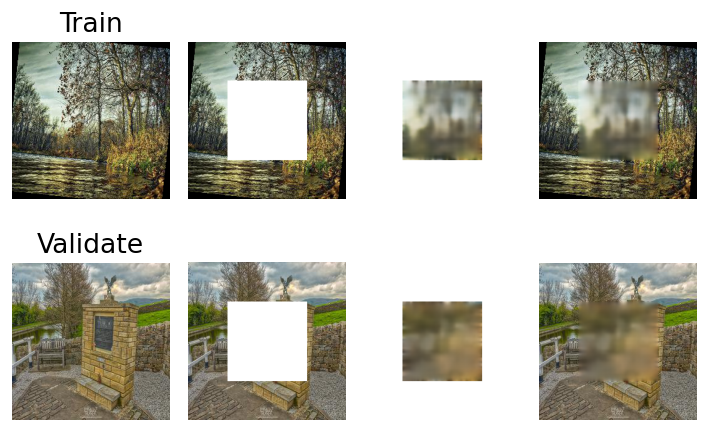

Done!


In [15]:
# Get Data
train_loader, validate_loader = get_data_from_files()
# show_sample(data_set)

# create Discriminator Pack
discriminator = Discriminator().to(device)
discriminator.apply(weights_init)
optimizerD = torch.optim.Adam(discriminator.parameters(), lr=0.00002)
# discriminator_pack = {'model': discriminator, 'loss': nn.BCELoss(), 'optimizer': optimizerD}
discriminator_pack = {'model': discriminator, 'loss': nn.BCEWithLogitsLoss(), 'optimizer': optimizerD}
# create Auto Encoder Pack
auto_encoder = UNet().to(device)
auto_encoder.apply(weights_init)
loss_lambda = nn.Parameter(torch.tensor(0.999))
optimizerAE = torch.optim.Adam(list(auto_encoder.parameters()), lr=0.0003)
content_loss = LossModel() if MONET else ContentLoss()
auto_encoder_pack = {'model': auto_encoder, 'loss': nn.MSELoss(), 'optimizer': optimizerAE, 'lambda': loss_lambda,'content_loss':content_loss.to(device)}

scaler = None if device == 'cpu' else amp.GradScaler()
# Run model
# auto_encoder_only_loop(auto_encoder_pack, train_loader, validate_loader, epochs=10)
main_loop(auto_encoder_pack, discriminator_pack, train_loader, validate_loader,scaler,epochs = 100)

Epoch 1
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028639 PSNR: 16.200031



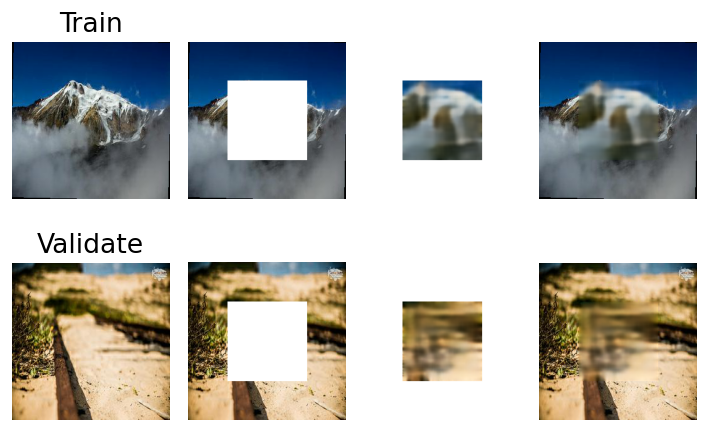

--- save mse models ---
Epoch 2
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028611 PSNR: 16.240462



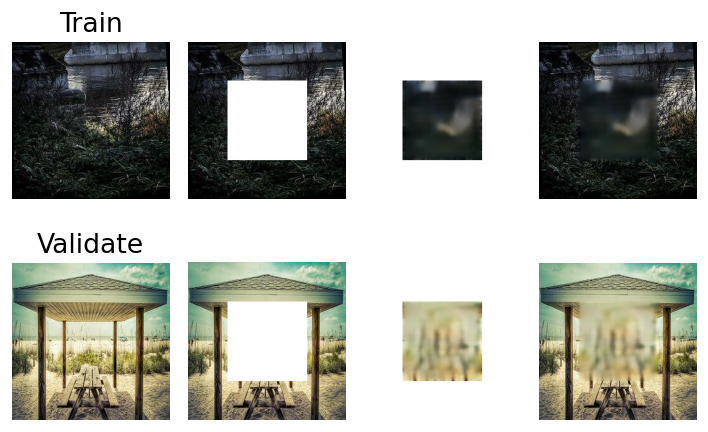

--- save mse models ---
Epoch 3
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028408 PSNR: 16.260139



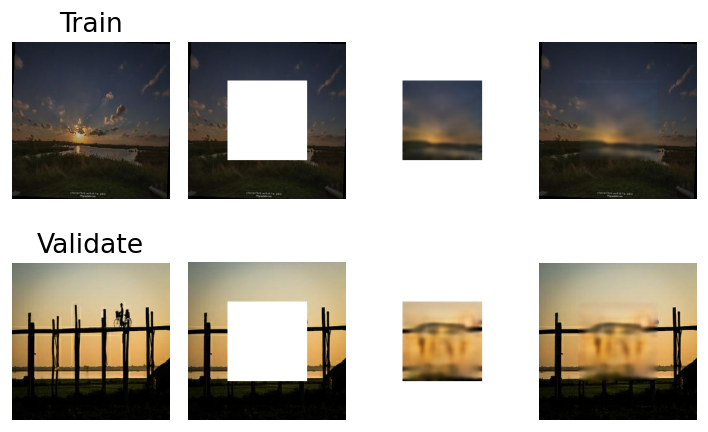

--- save mse models ---
Epoch 4
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028923 PSNR: 16.143292



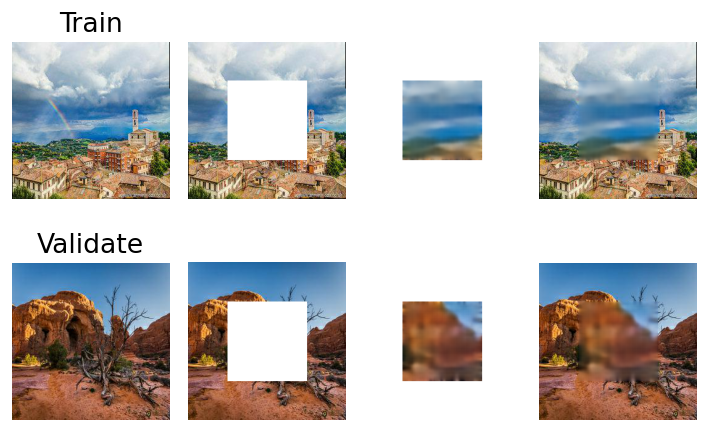

Epoch 5
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029125 PSNR: 16.128114



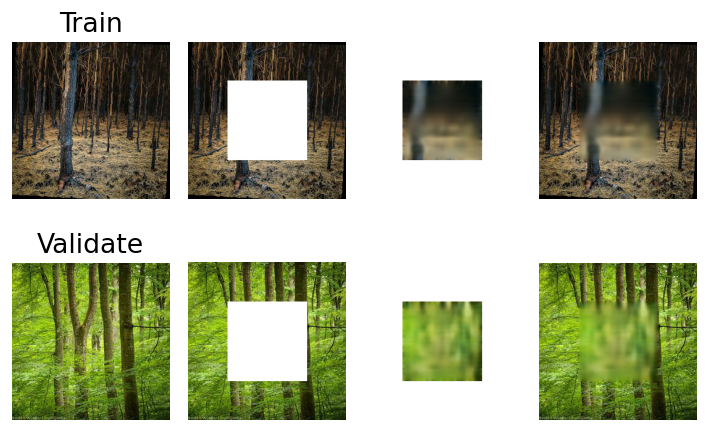

Epoch 6
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028670 PSNR: 16.202776



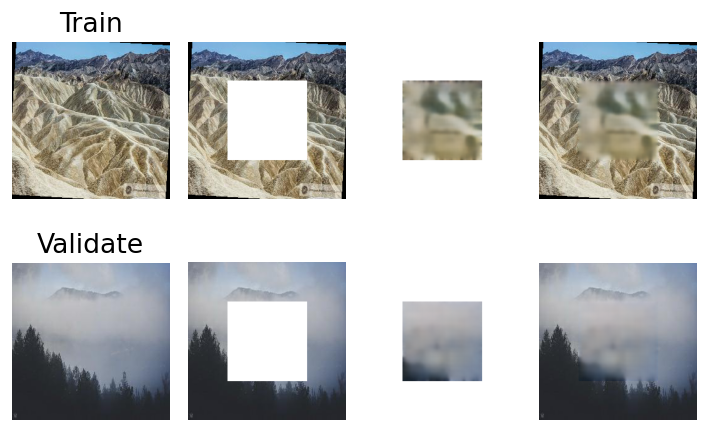

Epoch 7
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028730 PSNR: 16.218351



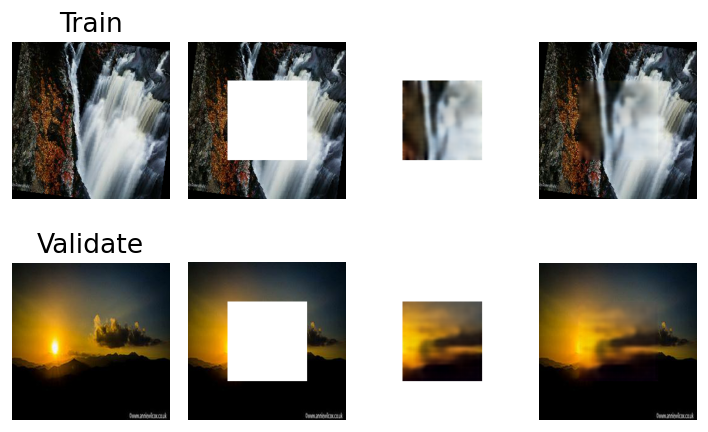

Epoch 8
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029094 PSNR: 16.148774



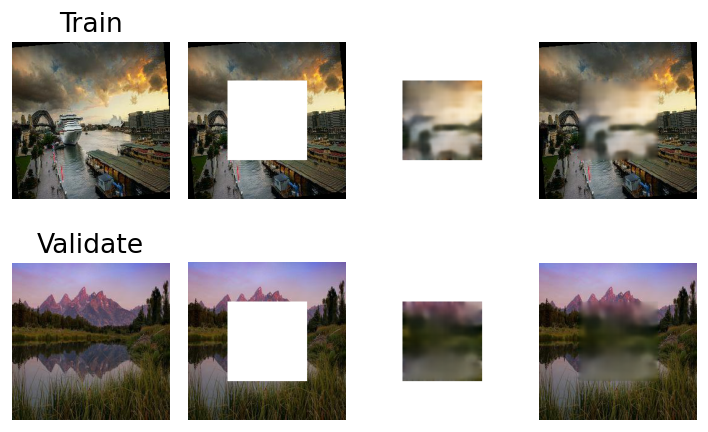

Epoch 9
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028783 PSNR: 16.232991



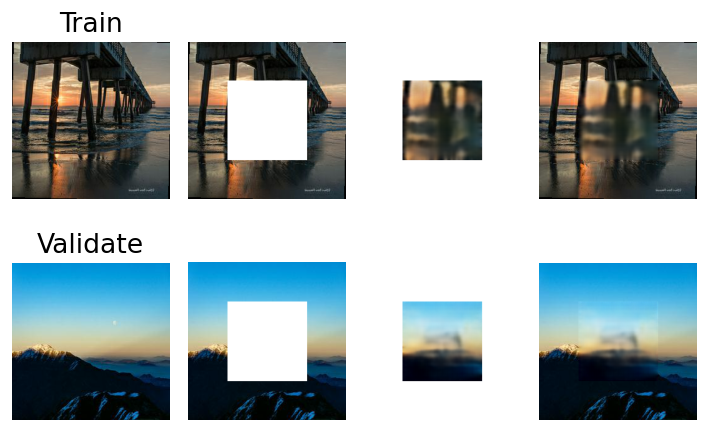

Epoch 10
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029727 PSNR: 16.030592



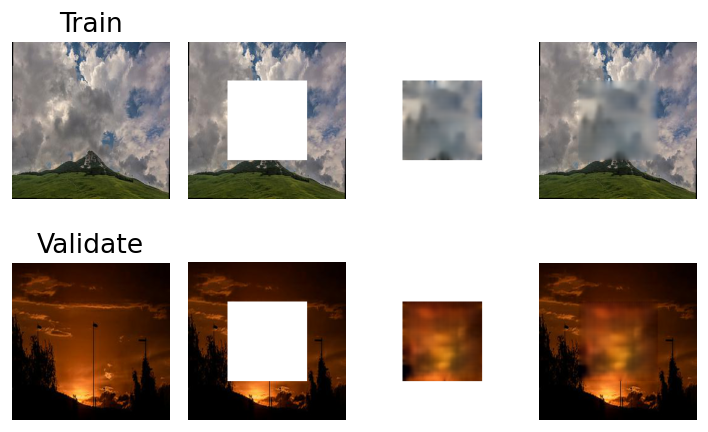

Epoch 11
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029212 PSNR: 16.146344



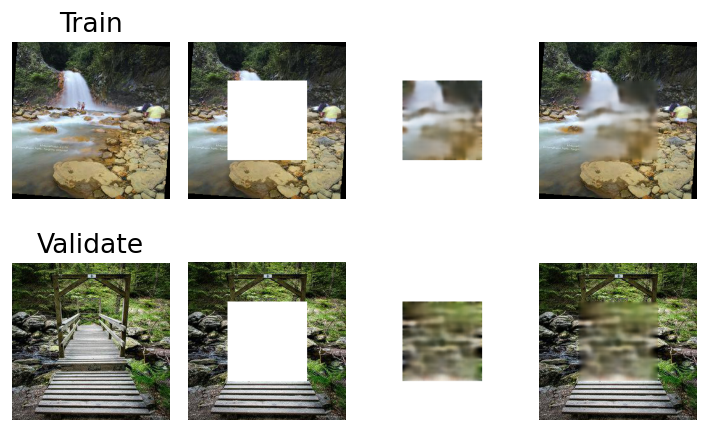

Epoch 12
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029639 PSNR: 16.030534



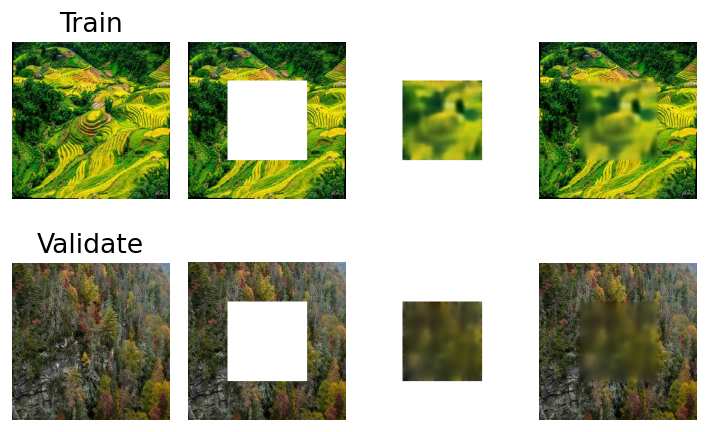

Epoch 13
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028761 PSNR: 16.249297



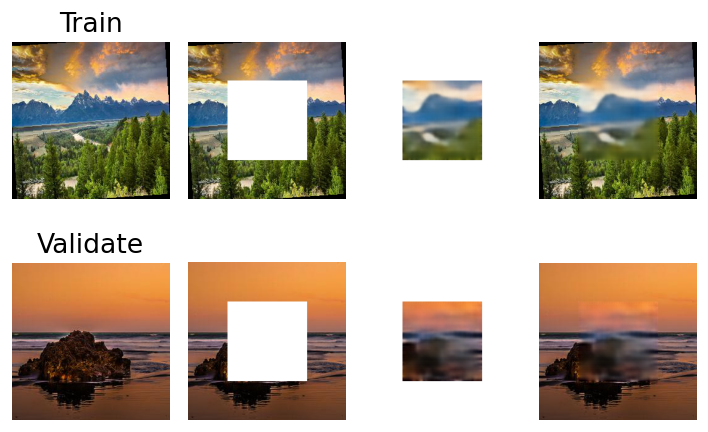

Epoch 14
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028220 PSNR: 16.299178



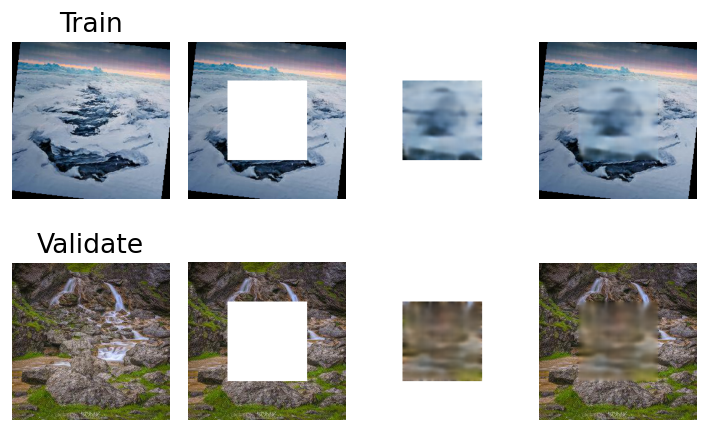

--- save mse models ---
Epoch 15
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028753 PSNR: 16.212374



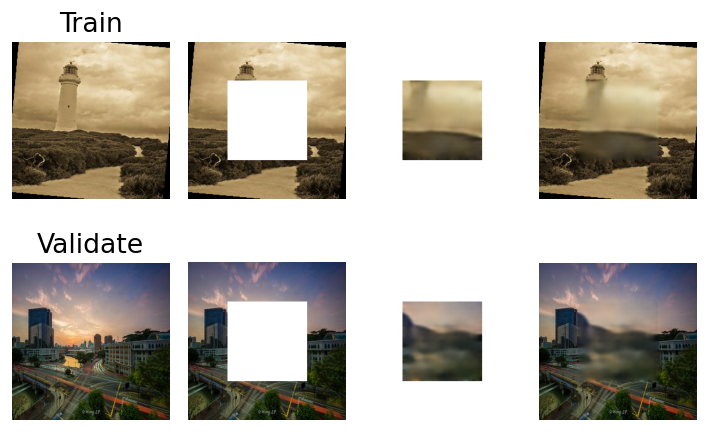

Epoch 16
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028162 PSNR: 16.330177



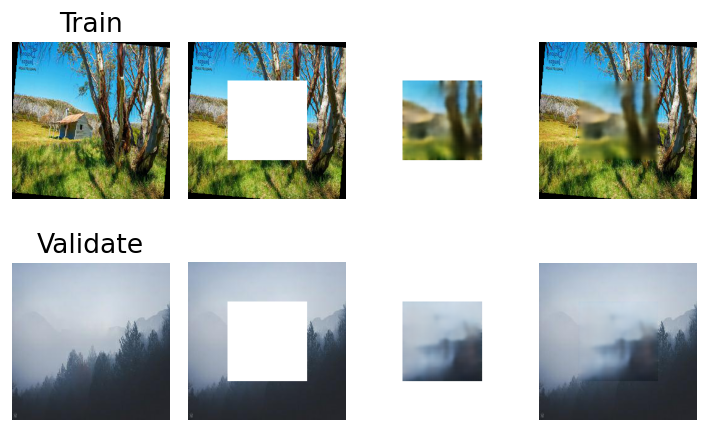

--- save mse models ---
Epoch 17
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028121 PSNR: 16.294639



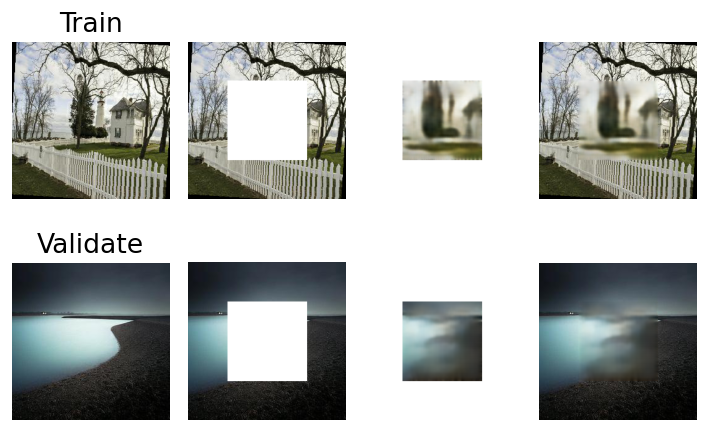

--- save mse models ---
Epoch 18
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028373 PSNR: 16.295114



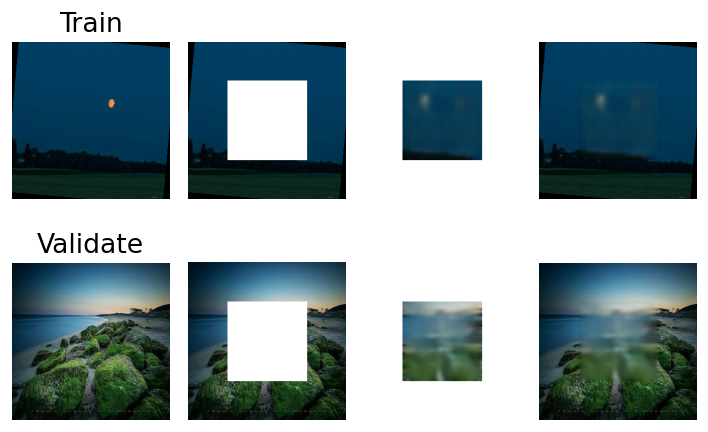

Epoch 19
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028232 PSNR: 16.336844



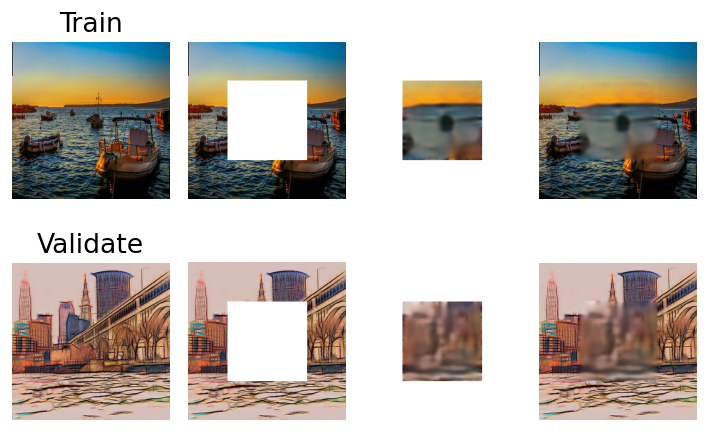

Epoch 20
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028547 PSNR: 16.240177



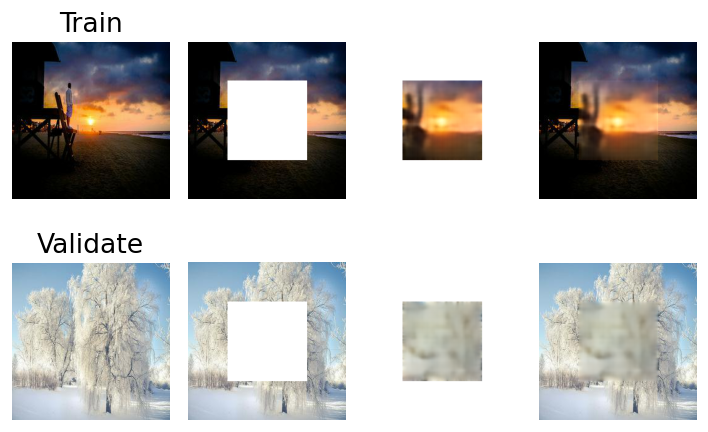

Epoch 21
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028854 PSNR: 16.192801



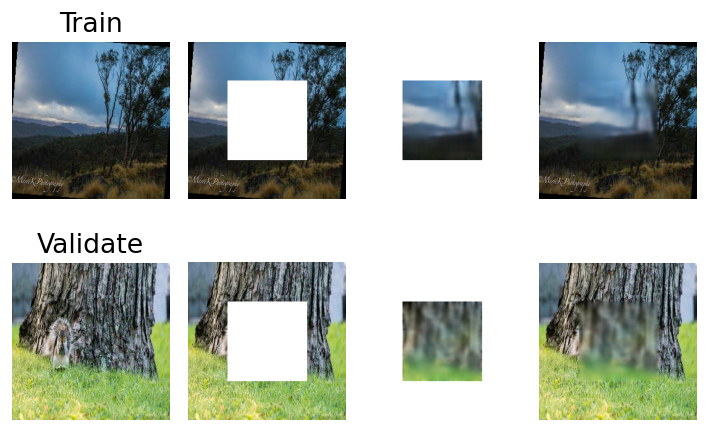

Epoch 22
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028559 PSNR: 16.225402



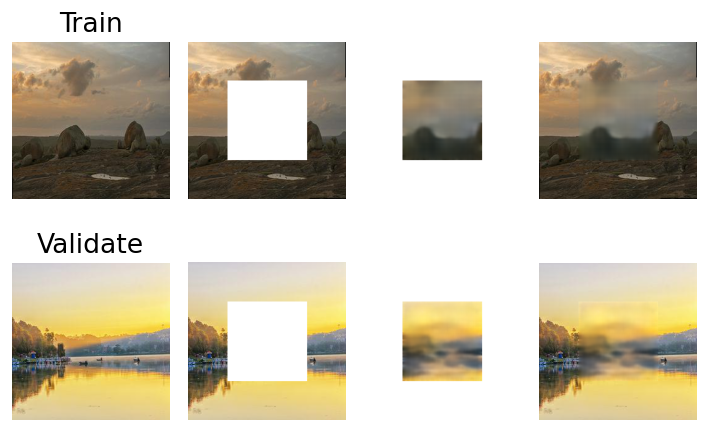

Epoch 23
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028744 PSNR: 16.258469



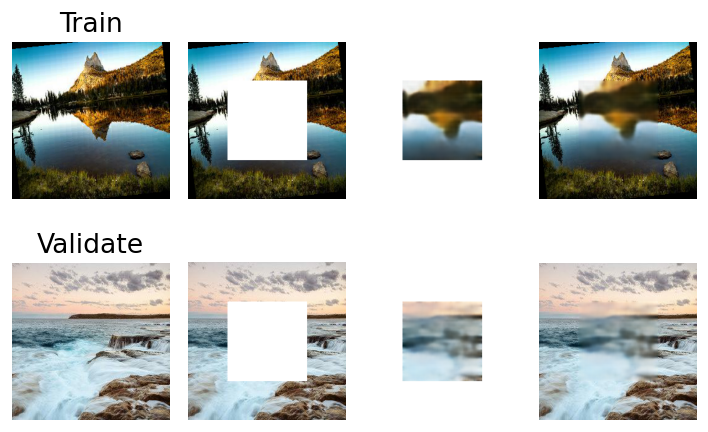

Epoch 24
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028708 PSNR: 16.239362



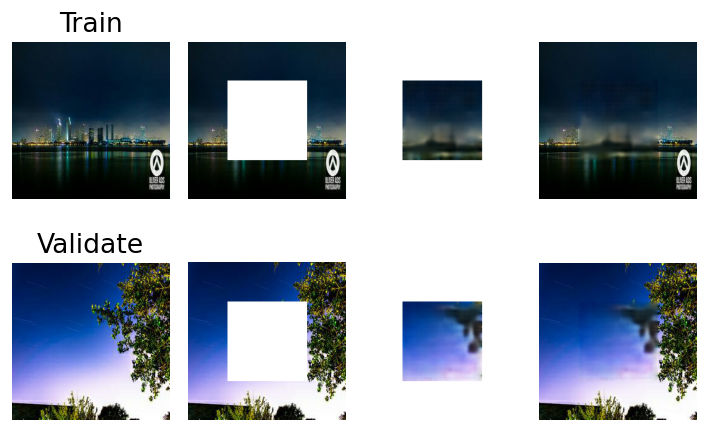

Epoch 25
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028627 PSNR: 16.230097



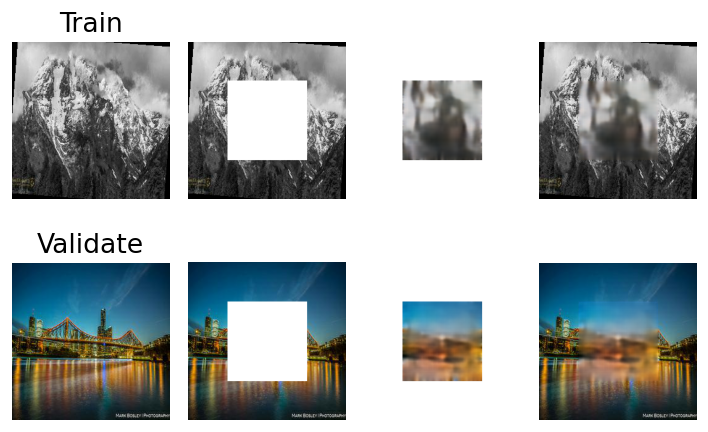

Epoch 26
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028673 PSNR: 16.241032



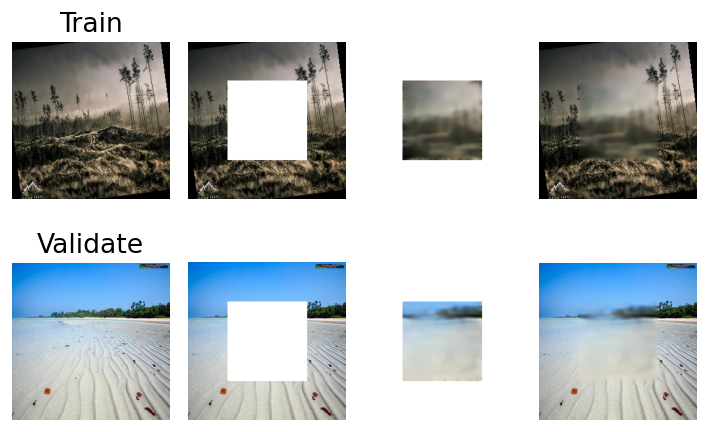

Epoch 27
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029104 PSNR: 16.126702



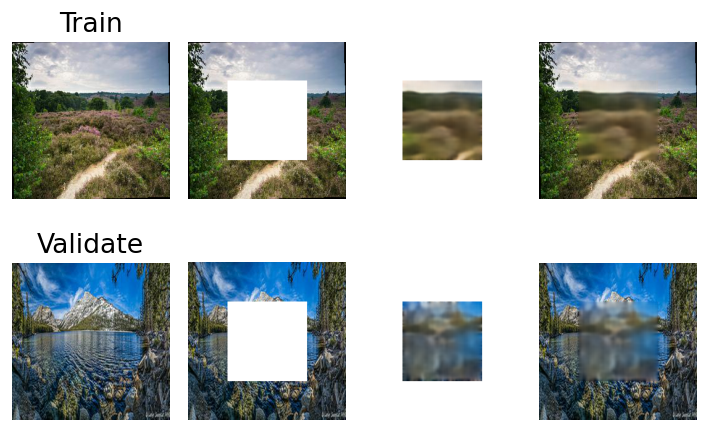

Epoch 28
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028921 PSNR: 16.160965



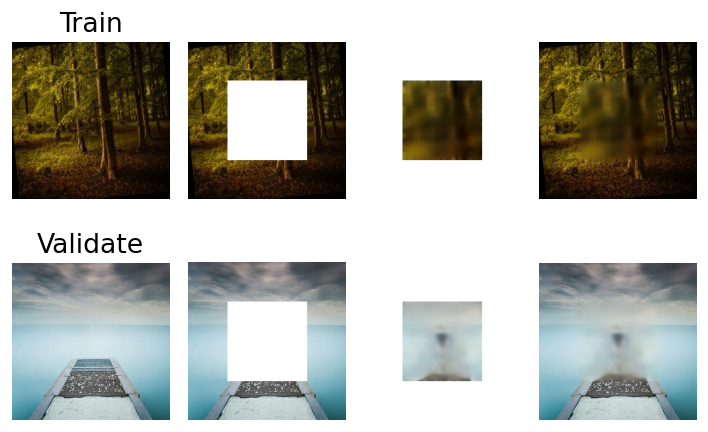

Epoch 29
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029920 PSNR: 15.986130



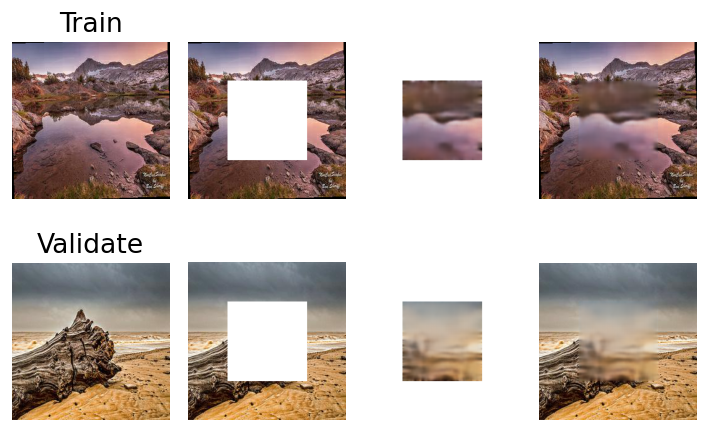

Epoch 30
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029430 PSNR: 16.043720



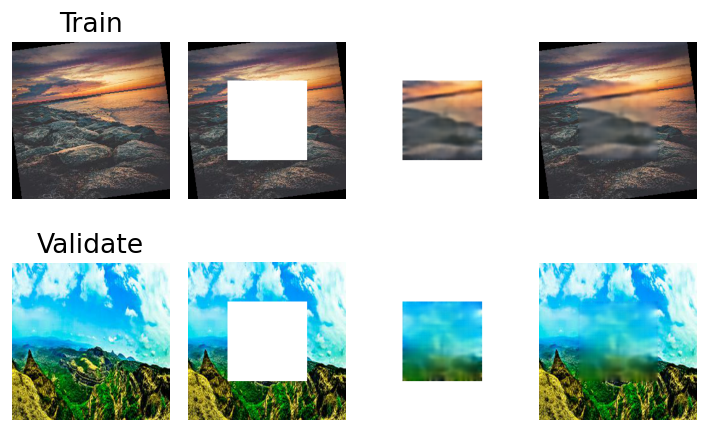

Epoch 31
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028622 PSNR: 16.209121



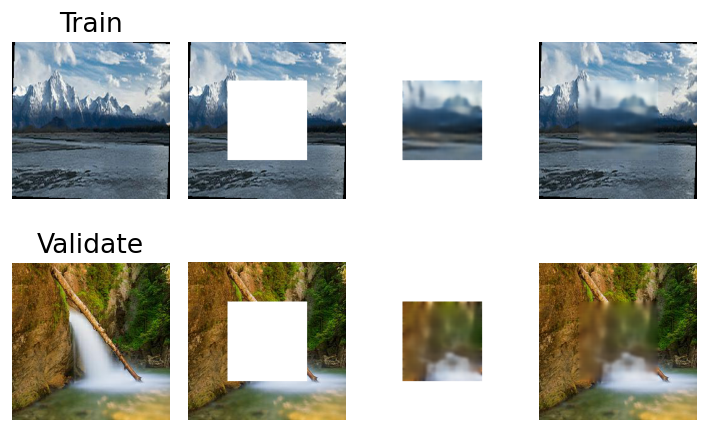

Epoch 32
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029145 PSNR: 16.143240



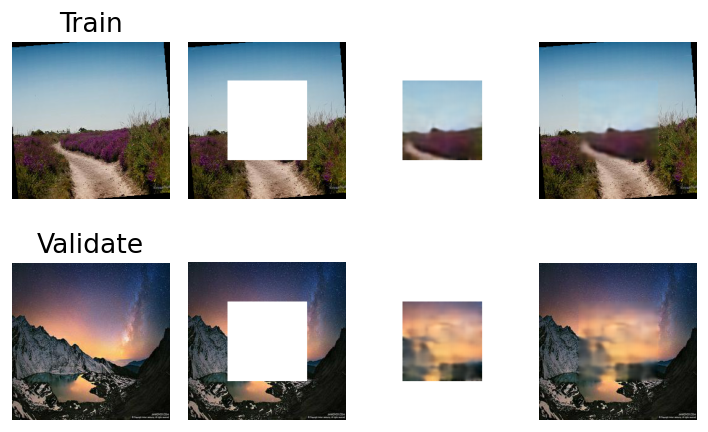

Epoch 33
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028582 PSNR: 16.272002



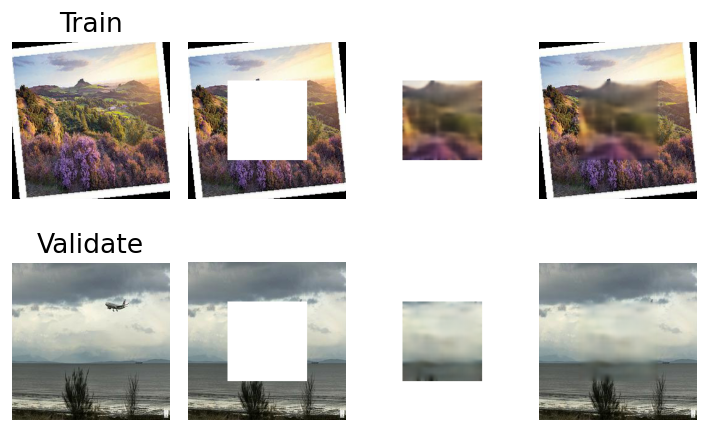

Epoch 34
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028614 PSNR: 16.207956



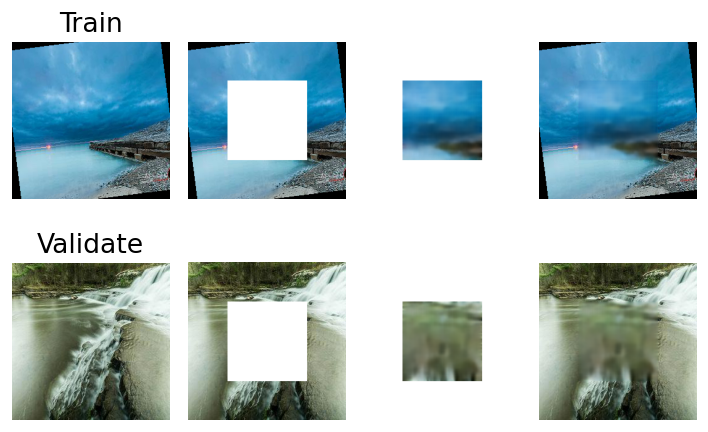

Epoch 35
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029329 PSNR: 16.096258



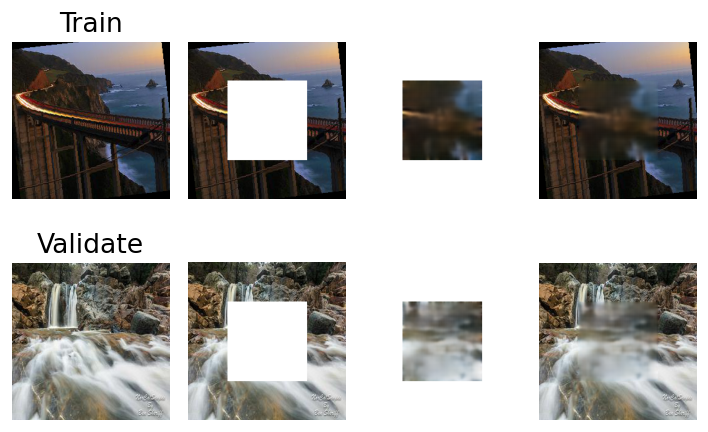

Epoch 36
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028832 PSNR: 16.206588



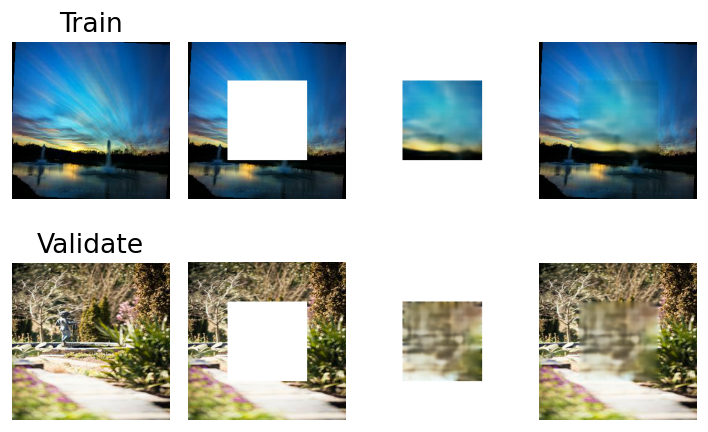

Epoch 37
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028775 PSNR: 16.185456



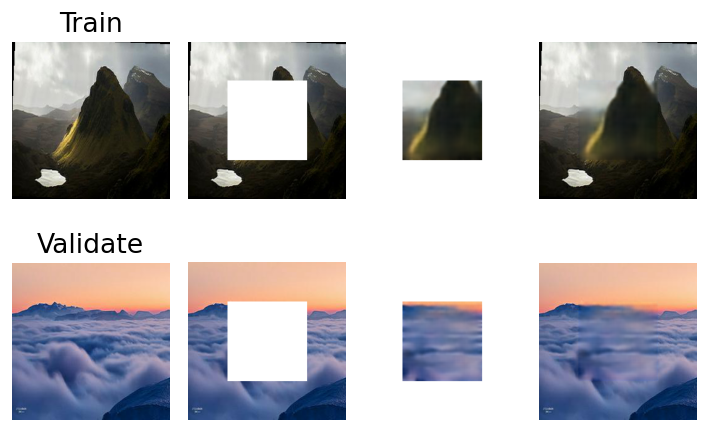

Epoch 38
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028707 PSNR: 16.240159



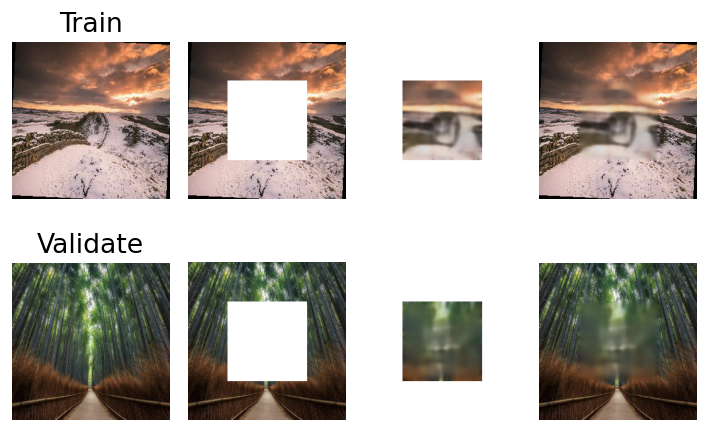

Epoch 39
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028850 PSNR: 16.206686



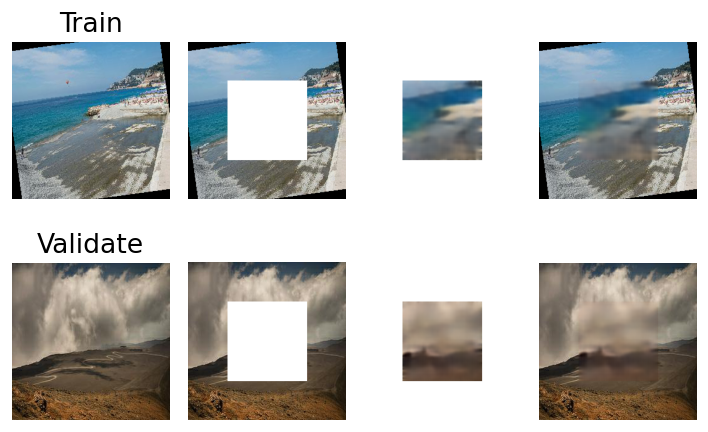

Epoch 40
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028569 PSNR: 16.249957



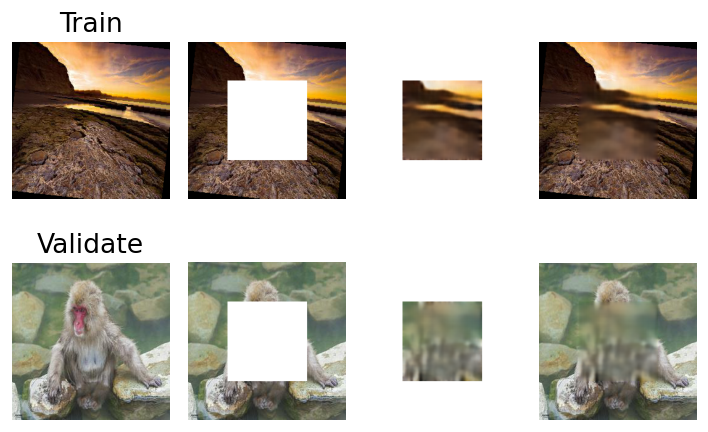

Epoch 41
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028754 PSNR: 16.226720



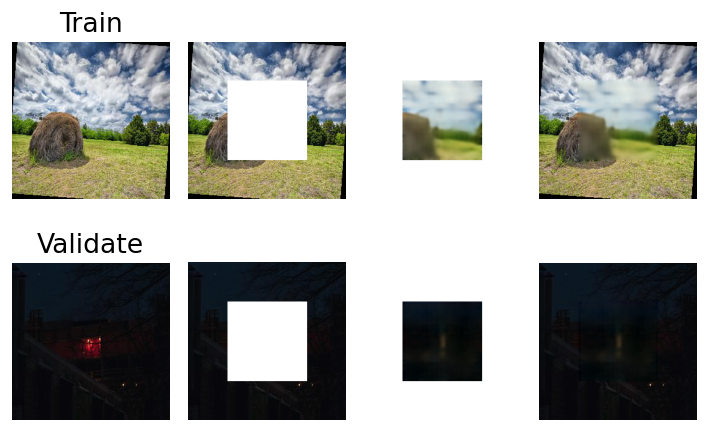

Epoch 42
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028442 PSNR: 16.278986



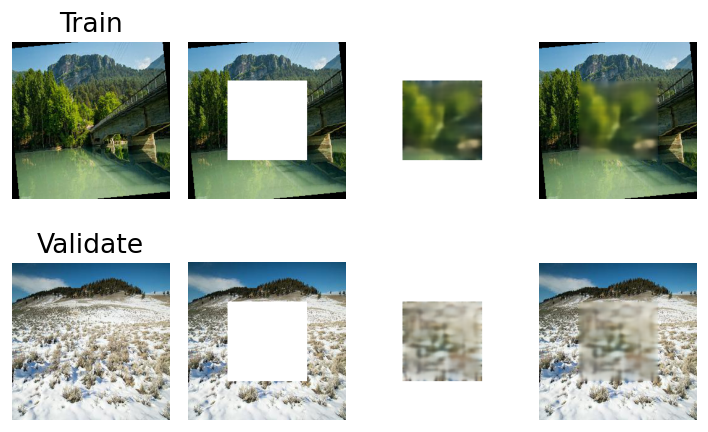

Epoch 43
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029361 PSNR: 16.146200



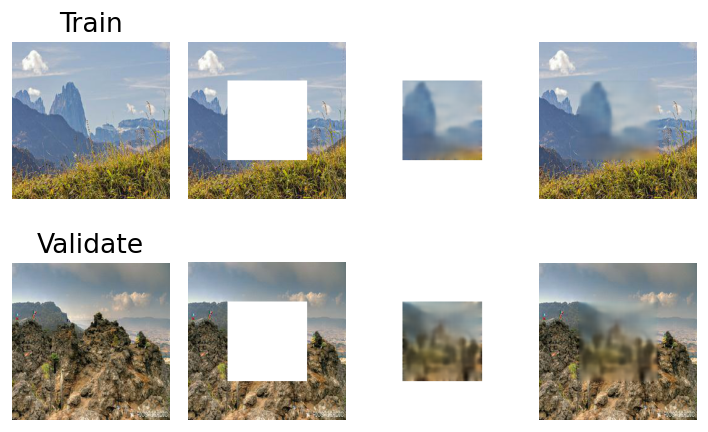

Epoch 44
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029329 PSNR: 16.140715



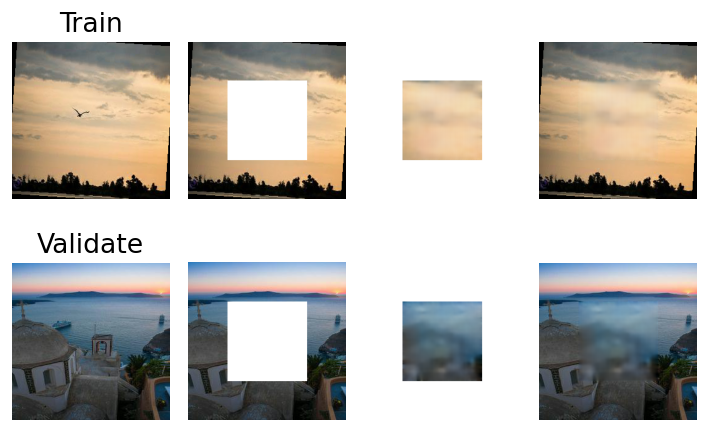

Epoch 45
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028625 PSNR: 16.272013



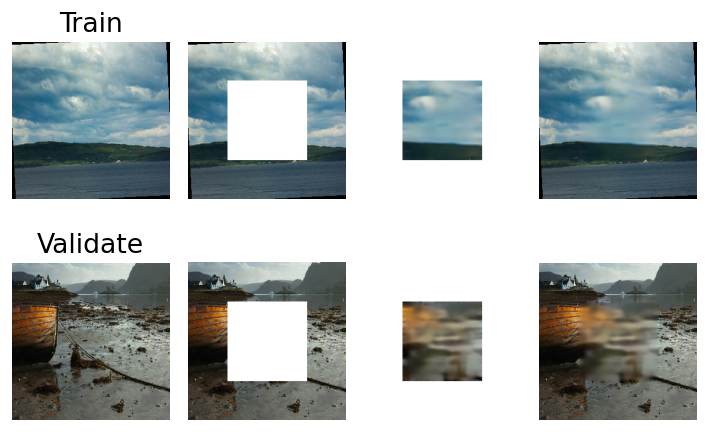

Epoch 46
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029424 PSNR: 16.113856



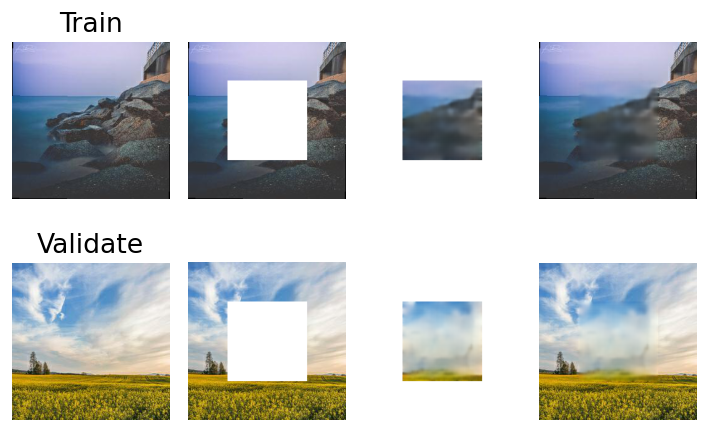

Epoch 47
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.029693 PSNR: 16.032664



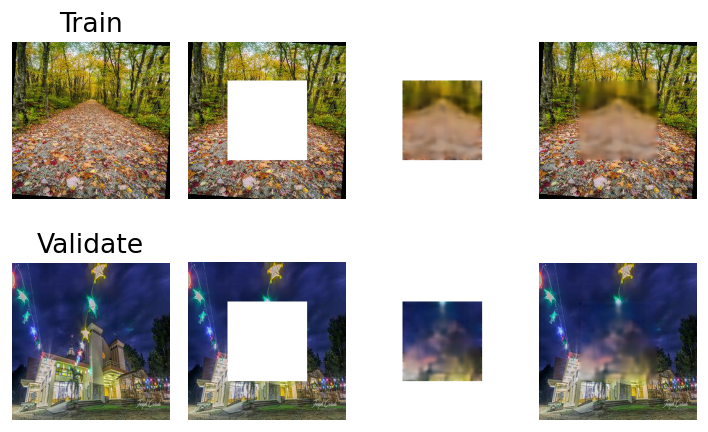

Epoch 48
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028854 PSNR: 16.238987



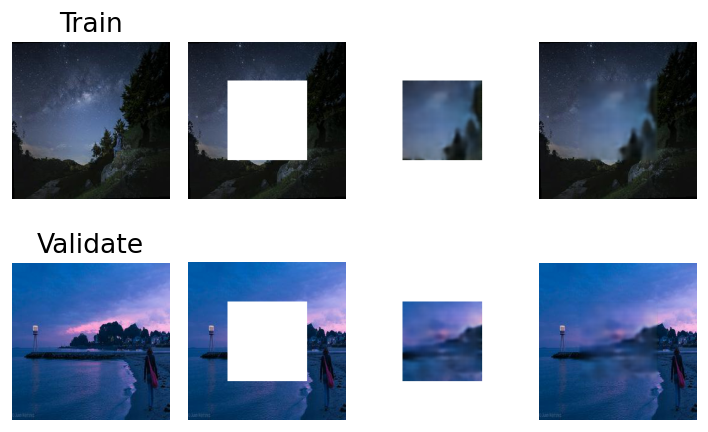

Epoch 49
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028607 PSNR: 16.229922



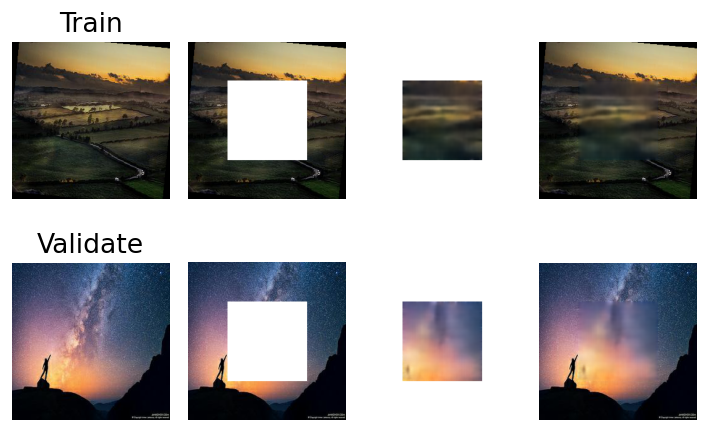

Epoch 50
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028224 PSNR: 16.320769



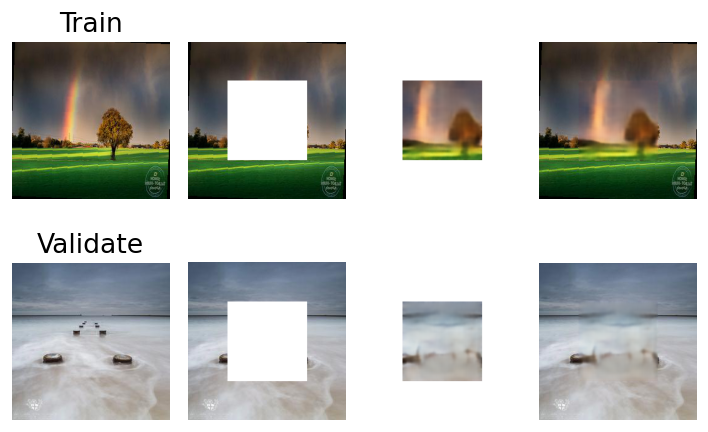

Epoch 51
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

acc:100.000
Validate Error:
 MSE loss: 0.028853 PSNR: 16.232941



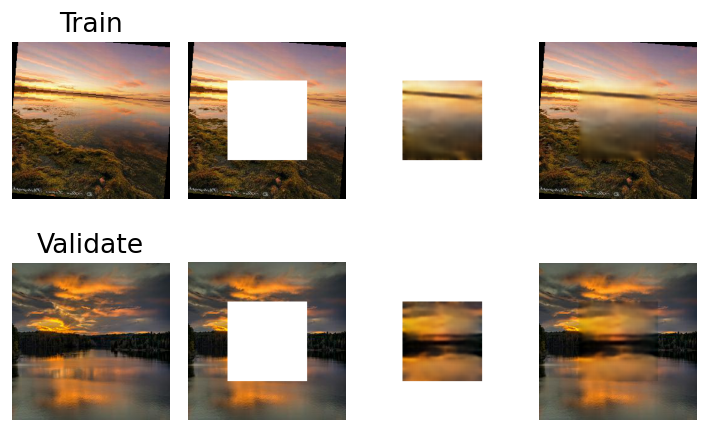

Epoch 52
-------------------------------


  0%|          | 0/88 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [16]:
main_loop(auto_encoder_pack, discriminator_pack, train_loader, validate_loader,scaler,epochs = 100)

In [20]:
try:
  print(auto_encoder.name)
  save_models(auto_encoder_pack,discriminator_pack,16.23,150,'psnr')
except:
  auto_encoder = UNet().to(device)
  checkpoint = torch.load(f'UNET_WITH_CONTENT_LOSS__mse')
  auto_encoder.load_state_dict(checkpoint['ae_state_dict'])

test_dataset = ImageTestDataSet('test', masks_dir='photos_central_block',transforms=general_transformer())
print(len(test_dataset))

test_loader = DataLoader(test_dataset, batch_size=1)
# test(validate_loader,auto_encoder)

UNET_WITH_CONTENT_LOSS
--- save psnr models ---
19


save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...


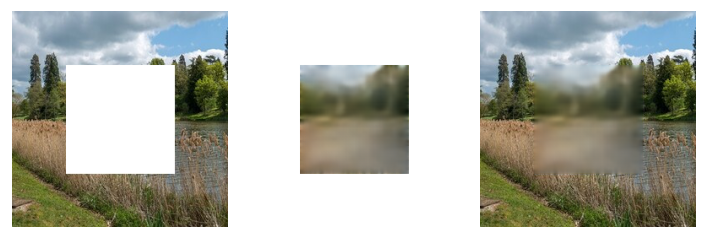

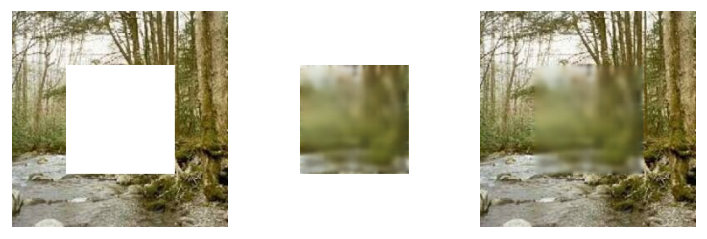

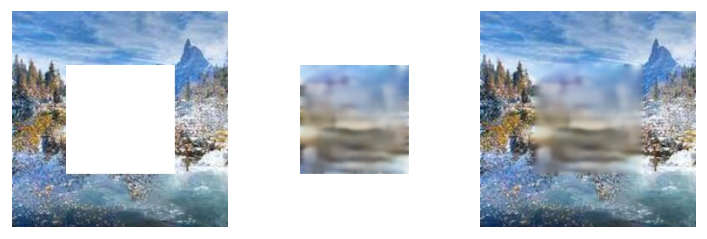

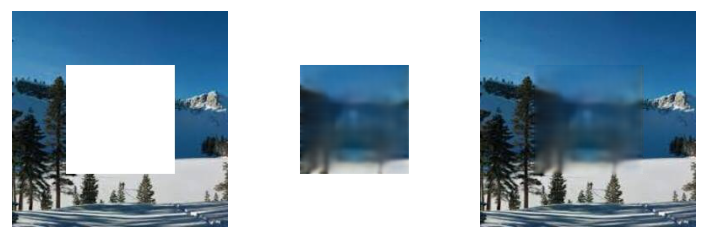

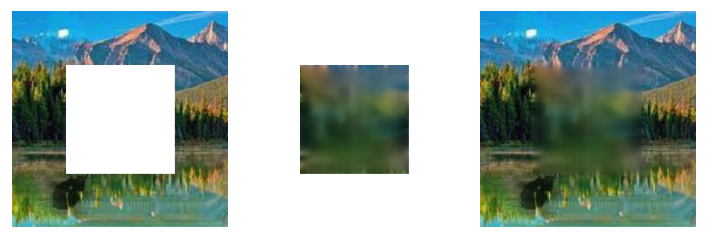

...

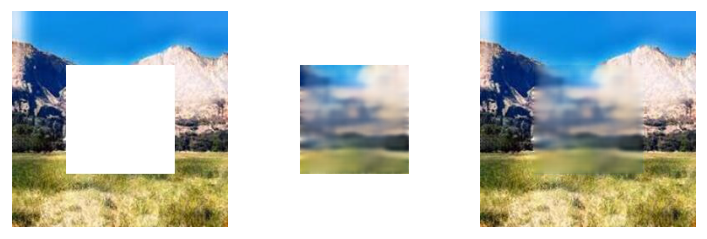

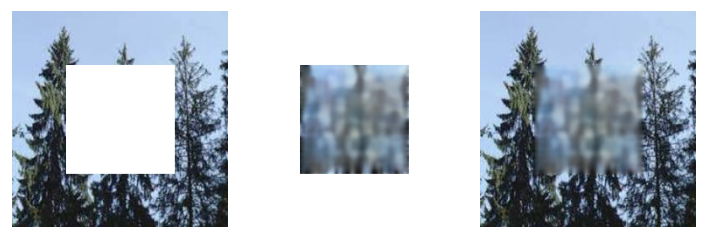

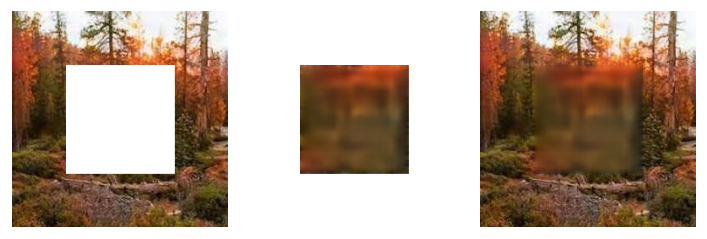

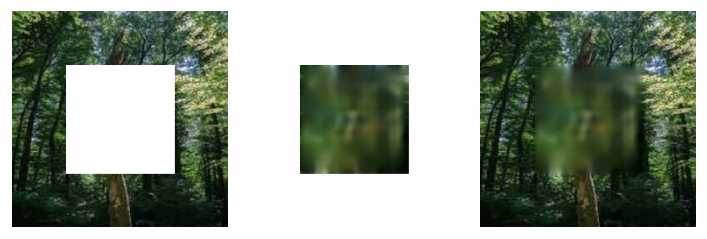

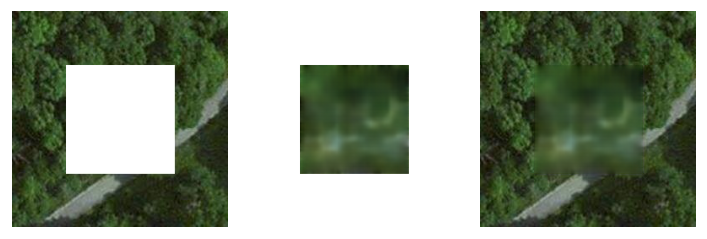

In [24]:
checkpoint = torch.load(f'UNET_WITH_CONTENT_LOSS__mse')
auto_encoder.load_state_dict(checkpoint['ae_state_dict'])
test(test_loader,auto_encoder)

save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...
save...


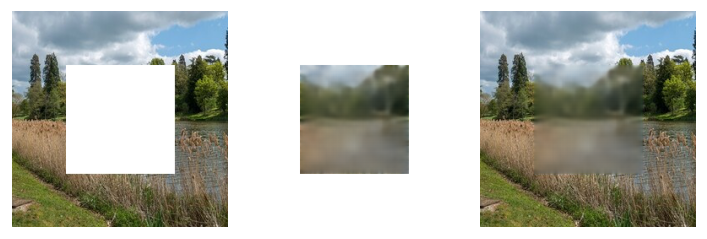

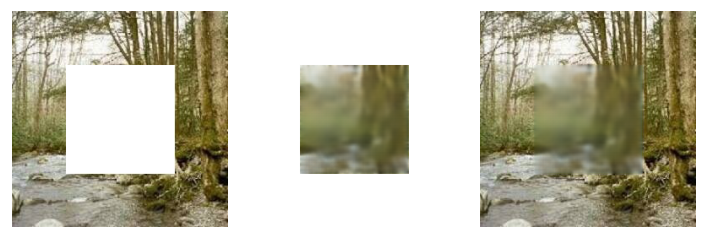

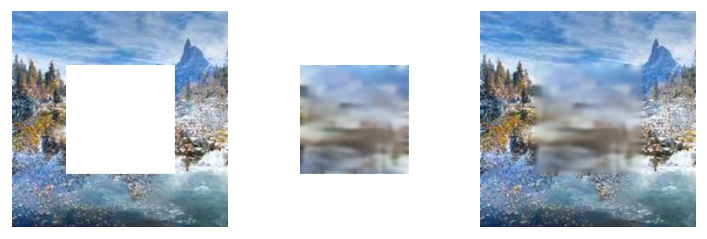

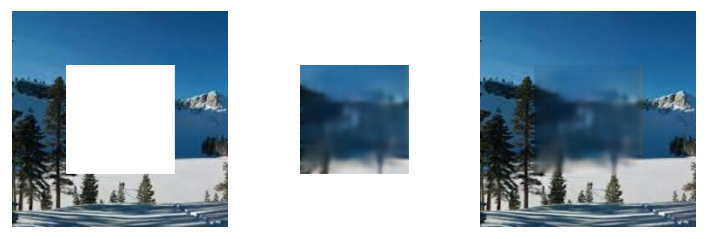

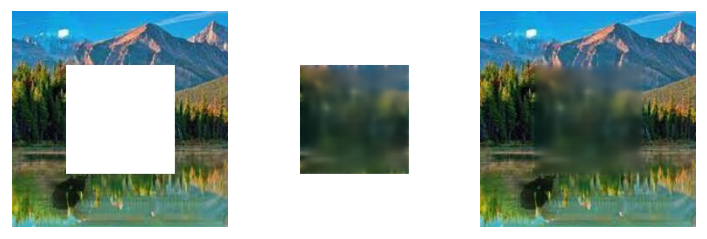

...

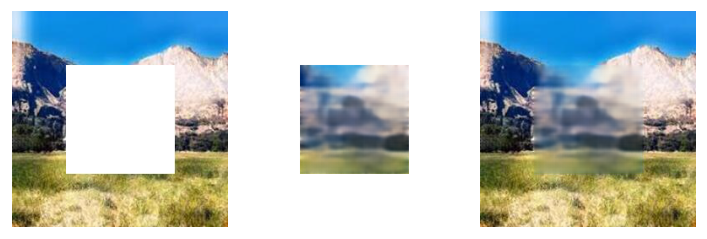

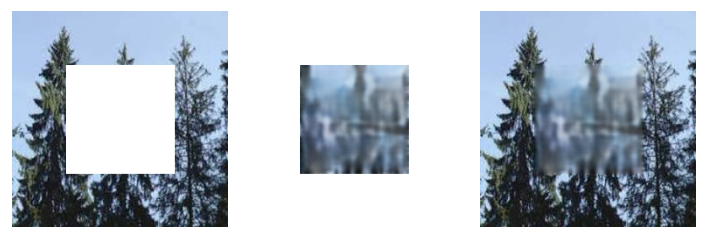

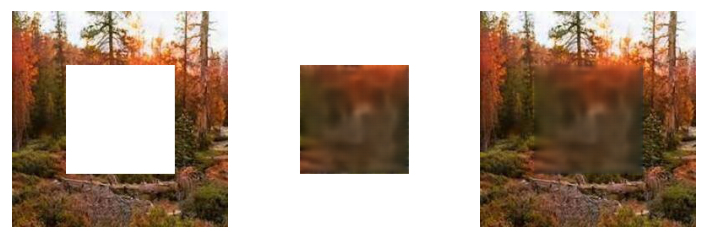

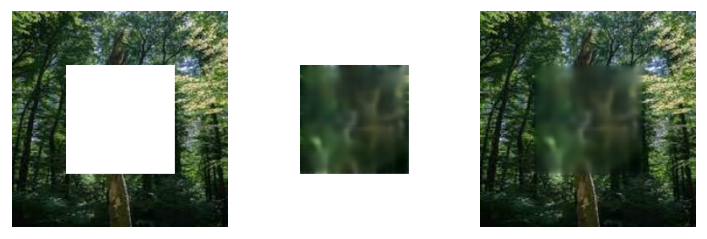

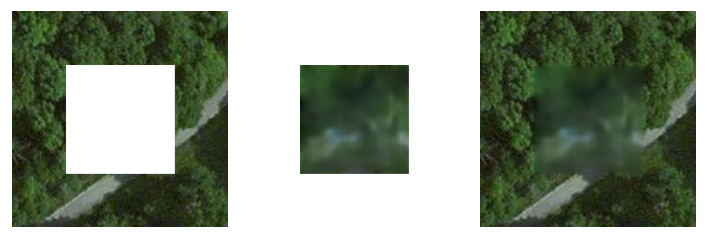

In [25]:
test(test_loader,auto_encoder)

In [22]:
%cp UNET_WITH_CONTENT_LOSS__mse drive/MyDrive/deep_learning_project/
%cp UNET_WITH_CONTENT_LOSS__psnr drive/MyDrive/deep_learning_project/